In [1]:
## default libraries
from glob import glob
import numpy as np
import pandas as pd
import scipy as sp
import os, sys
import seaborn as sns
import matplotlib
import matplotlib.pylab as plt
import matplotlib.gridspec as gridspec
import matplotlib.patches as mpatches
import palettable.colorbrewer as cb
import h5py as h5
# import ipywidgets as widgets


#### My libraries
import bshap.core as bshap
import pyquant.genopheno as pyquant
import snpmatch
from pygenome import genome
import pygenome.plotting as  genome_plotting
# from snpmatch.core import genotype_cross
# from snpmatch.core import snp_genotype
import pylmm.core as pylmm


### Few settings
matplotlib.rcParams['pdf.fonttype'] = 42 
matplotlib.rcParams['ps.fonttype'] = 42
sns.set(style="white", color_codes=True, font_scale = 1.25)
plt.rcParams['figure.figsize'] = [15, 8]


### Global variables
context_colors = cb.qualitative.Set2_3.hex_colors
temp_color = {'T4': cb.sequential.Blues_6.hex_colors[3], "T16": cb.sequential.Oranges_6.hex_colors[3]}
color_f2s = {'BB': cb.diverging.BrBG_3.hex_colors[0], "AB": cb.diverging.RdGy_6.hex_colors[4], "AA": cb.diverging.BrBG_3.hex_colors[2]}

home_dir = "/users/rahul.pisupati/"
proj_dir = "/groups/nordborg/projects/"
# home_dir = "/vol/HOME/"
# proj_dir = "/projects/"

tair10 = genome.GenomeClass(home_dir +  "/TAiR10_ARABIDOPSIS/TAIR10_wholeGenome.fasta")
tair10.centro_start = np.array([14364752, 3602775, 12674550, 2919690, 11668616, 0, 0])
tair10.centro_end   = np.array([15750321, 3735247, 13674767, 4011692, 12082583, 0, 0])
tair10.centro_mid = ((tair10.centro_start + tair10.centro_end)/2).astype(int)

tair10.load_bed_ids_str(genes = home_dir + "/ARAPORT11/Araport11_GFF3_genes_201606.onlychrs.bed", gene_exon = home_dir + "/TAiR10_ARABIDOPSIS/TAIR10_GFF3_protein_coding_gene_exons.onlychrs.bed", tes = home_dir + "/ARAPORT11/Araport11_GFF3_TEs_201606.bed", araport11 = home_dir + "/ARAPORT11/Araport11_GFF3_genes_transposons.ids.onlychrs.bed")
tair10.tes_cmt2_ids = pd.read_csv(proj_dir + "/cegs/rahul/013.alignMutants/CMT2_target_TEs.txt", header = None).iloc[:,0]
tair10.tes_rddm_ids = pd.read_csv(proj_dir + "/cegs/rahul/013.alignMutants/RdDM_target_TEs.txt", header = None).iloc[:,0]

tair10.genes['gene_str'] = tair10.genes_str
tair10.genes['gene_len'] = np.abs(tair10.genes[1] - tair10.genes[2])
plotting_along_genome = genome_plotting.PlottingGenomeWide(tair10)


methylation_related_gene_list = pd.read_csv( home_dir + "/mygit/jupyter_notebooks/001.methylation_pipeline/Methylation_gene_list_with_GName_e_v2.txt", sep = "\t" )
methylation_related_gene_list = methylation_related_gene_list.set_index( "GeneID" )
methylation_related_gene_list = pd.merge( tair10.araport11.set_index(3).loc[ methylation_related_gene_list.index.values,:], methylation_related_gene_list, left_index=True, right_index=True )
methylation_related_gene_list['gene_str'] = methylation_related_gene_list.iloc[:,0].astype(str) + "," + methylation_related_gene_list.iloc[:,1].astype(str) + "," + methylation_related_gene_list.iloc[:,2].astype(str)
# pd.merge(methylation_related_gene_list, tair10.genes.set_index(3)., left_index=True , right_index=True )

filtering out genome scaffolds less than 1000000


In [2]:
%%time
proj_dir = "/groups/nordborg/projects/epiclines/005.manu.crosses.2020/004.design_resolved/"

cross_data = pyquant.qtl_maps.GeneticMap( {'d1_2020': proj_dir + "/snps_bcftools/genotyper_final_D1.csv", 'd2_2020': proj_dir + "/snps_bcftools/genotyper_final_D2.csv"} )


mc_data = pd.read_csv("cache_data/epimutation_rates_500Kb_rep2.csv", index_col = 0)
# mc_data = pd.read_csv("cache_data/epimutation_rates_d2_500Kb.csv", index_col=0)
# mc_data = pd.read_csv("cache_data/epimutation_rates_d2_2mb.csv", index_col=0)
# mc_data = pd.merge(combined_mcs_f2s['samples'], mc_data, left_index=True, right_index=True)

CPU times: user 327 ms, sys: 36.4 ms, total: 363 ms
Wall time: 1.24 s


In [3]:
%%time
# cross_data.write_h5_qtl_scores('d2_2020', proj_dir + "/epimutation_rates/qtl_maps_deviations_500Kb_d2_rep3.csv", proj_dir + "/epimutation_rates/qtl_maps_deviations_500Kb_d2_rep3.hdf5" )
# cross_data.write_h5_qtl_scores('d2_2020', proj_dir + "/epimutation_rates/qtl_maps_deviations_500Kb_d2_rep2.csv", proj_dir + "/epimutation_rates/qtl_maps_deviations_500Kb_d2_rep2.hdf5" )


# ns_genetic_map = pyquant.qtl_maps.readQTLresults(proj_dir + "/snps_bcftools/genotyper_final_D1.csv", proj_dir + "/epimutation_rates/qtl_maps_deviations_500Kb_rep1.hdf5", tair10 )
ns_genetic_map = pyquant.qtl_maps.readQTLresults(proj_dir + "/snps_bcftools/genotyper_final_D1.csv", proj_dir + "/epimutation_rates/qtl_maps_deviations_500Kb_rep3.hdf5", tair10 )
ns_genetic_map_d2 = pyquant.qtl_maps.readQTLresults(proj_dir + "/snps_bcftools/genotyper_final_D2.csv", proj_dir + "/epimutation_rates/qtl_maps_deviations_500Kb_d2_rep3.hdf5", tair10 )



def get_model(ns_qtl_maps_output, model_name):
    ef_data = ns_qtl_maps_output.get_matrix( model_name, ns_qtl_maps_output.gene_str.index.values )
    ef_data = ef_data.iloc[np.argsort(tair10.get_genomewide_inds(pd.Series(ef_data.index)))[::-1],:]
    return(ef_data)
    

ns_genetic_map.dev_0_f = get_model(ns_genetic_map, "deviation_0_nonpoly_intT")
ns_genetic_map.dev_0_a = get_model(ns_genetic_map, "deviation_0_nonpoly_addT")
ns_genetic_map.dev_0_0 = get_model(ns_genetic_map, "deviation_0_nonpoly")
ns_genetic_map.dev_1_f = get_model(ns_genetic_map, "deviation_1_nonpoly_intT")
ns_genetic_map.dev_1_a = get_model(ns_genetic_map, "deviation_1_nonpoly_addT")
ns_genetic_map.dev_1_0 = get_model(ns_genetic_map, "deviation_1_nonpoly")


ns_genetic_map_d2.dev_0_f = get_model(ns_genetic_map_d2, "deviation_0_nonpoly_intT")
ns_genetic_map_d2.dev_0_a = get_model(ns_genetic_map_d2, "deviation_0_nonpoly_addT")
ns_genetic_map_d2.dev_0_0 = get_model(ns_genetic_map_d2, "deviation_0_nonpoly")
ns_genetic_map_d2.dev_1_f = get_model(ns_genetic_map_d2, "deviation_1_nonpoly_intT")
ns_genetic_map_d2.dev_1_a = get_model(ns_genetic_map_d2, "deviation_1_nonpoly_addT")
ns_genetic_map_d2.dev_1_0 = get_model(ns_genetic_map_d2, "deviation_1_nonpoly")

CPU times: user 286 ms, sys: 80 ms, total: 366 ms
Wall time: 1.07 s


In [4]:
%%time

#### 1001 genomes SNPs
snps_1001g = pylmm.gwas.GWAS( "/groups/nordborg/projects/the1001genomes/scratch/rahul/107.VCF_1001G_imputed/the1001genomes_all_chromosomes_binary.hdf5", phenos_df = None )
snps_1001g.load_kinship_file( "/groups/nordborg/projects/the1001genomes/scratch/rahul/107.VCF_1001G_imputed/the1001genomes_kinship_ibs_binary_mac5.hdf5" )


#### Swedes from 2013 paper
snps_swedes = pylmm.gwas.GWAS("/groups/nordborg/lab/Data/genotype-callmethods/GENOTYPES_FOR_GWAS/4/all_chromosomes_binary.hdf5", phenos_df = None, chunk_size=5000 )
snps_swedes.load_kinship_file( "/groups/nordborg/lab/Data/genotype-callmethods/GENOTYPES_FOR_GWAS/4/kinship_ibs_binary_mac5.h5py" )

#### 250K SNPs
snps_250k = pylmm.gwas.GWAS( "/groups/nordborg/projects/the1001genomes/scratch/rahul/106.VCF_250k_callmethod75/all_chromosomes_binary.hdf5", phenos_df = None, chunk_size=5000 )
snps_250k.load_kinship_file( "/groups/nordborg/projects/the1001genomes/scratch/rahul/106.VCF_250k_callmethod75/kinship_ibs_binary_mac5.h5py" )



CPU times: user 32.7 ms, sys: 37.2 ms, total: 69.9 ms
Wall time: 1.86 s



# Can we do _a priori_ gene testing?

A priori genes (5Mb region from QTL marker)
SUVH7 (6.1Mb), SHH1(5.2Mb), IDNL1 (5.4Mb), RDR1(5.09 Mb)
VIM3 (15.8Mb), AGO10 (17.6Mb), SUVR2 (17.7Mb)
VIM1 (21.4Mb), NRPD1 (23.3Mb)
SUVH9 (7.8Mb), RDR2 (6.78Mb), MET2 (8.1Mb)
VIM3 (15.8Mb), AGO10 (17.6Mb), SUVR2 (17.7Mb)




In [6]:
methylation_related_gene_list[methylation_related_gene_list[0] == "Chr2"]

,0,1,2,4,5,GeneName,gene_str
3,,,,,,,
AT2G05900,Chr2,2256970,2257908,0,+,SUVH10,"Chr2,2256970,2257908"
AT2G19520,Chr2,8455756,8459642,0,+,FVE,"Chr2,8455756,8459642"
AT2G22740,Chr2,9662638,9667038,0,-,SUVH6,"Chr2,9662638,9667038"
AT2G23740,Chr2,10097265,10103398,0,+,SUVR5,"Chr2,10097265,10103398"
AT2G24490,Chr2,10397377,10400802,0,-,RPA2,"Chr2,10397377,10400802"
AT2G24740,Chr2,10529690,10531957,0,-,SUVH8,"Chr2,10529690,10531957"
AT2G27040,Chr2,11536502,11542391,0,-,"AGO4,OCP11;Argonaute family protein","Chr2,11536502,11542391"
AT2G27880,Chr2,11871378,11876989,0,+,AGO5;Argonaute family protein,"Chr2,11871378,11876989"
AT2G30280,Chr2,12909551,12912416,0,-,DMS4,"Chr2,12909551,12912416"


In [5]:
methylation_related_gene_list[methylation_related_gene_list[0] == "Chr1"]

,0,1,2,4,5,GeneName,gene_str
3,,,,,,,
AT1G01040,Chr1,23121,31227,0,+,"ASU1,ATDCL1,CAF,DCL1,EMB60,EMB76,SIN1,SUS1;dic...","Chr1,23121,31227"
AT1G04050,Chr1,1045598,1049864,0,-,SUVR1,"Chr1,1045598,1049864"
AT1G05460,Chr1,1601148,1605034,0,-,SDE3,"Chr1,1601148,1605034"
AT1G08060,Chr1,2501704,2511084,0,-,MOM1,"Chr1,2501704,2511084"
AT1G14790,Chr1,5093961,5098270,0,-,RDR1,"Chr1,5093961,5098270"
AT1G15215,Chr1,5238044,5240051,0,+,SHH1,"Chr1,5238044,5240051"
AT1G15910,Chr1,5465251,5469180,0,+,IDNL1,"Chr1,5465251,5469180"
AT1G17770,Chr1,6120741,6122822,0,+,SUVH7,"Chr1,6120741,6122822"
AT1G31280,Chr1,11181504,11185396,0,+,AGO2;Argonaute family protein,"Chr1,11181504,11185396"


In [17]:
gain_qtls = pd.Series(["Chr1:5038757", "Chr5:15932197"])
gain_qtls = pd.DataFrame(gain_qtls.str.split(":", expand = True).values, index = gain_qtls) 
gain_qtls = pd.DataFrame({"chr": gain_qtls.iloc[:,0], "start": gain_qtls.iloc[:,1].astype(int) - 2500000, "end": gain_qtls.iloc[:,1].astype(int) + 2500000   })

methylation_related_gene_list.iloc[bshap.run_bedtools.get_intersect_bed_ix( reference_bed=methylation_related_gene_list.loc[:,[0,1,2]], query_bed= gain_qtls, just_names=False)['ref_ix'],:]

,0,1,2,4,5,GeneName,gene_str
3,,,,,,,
AT1G14790,Chr1,5093961,5098270,0,-,RDR1,"Chr1,5093961,5098270"
AT1G15215,Chr1,5238044,5240051,0,+,SHH1,"Chr1,5238044,5240051"
AT1G15910,Chr1,5465251,5469180,0,+,IDNL1,"Chr1,5465251,5469180"
AT1G17770,Chr1,6120741,6122822,0,+,SUVH7,"Chr1,6120741,6122822"
AT5G39550,Chr5,15837178,15840678,0,-,VIM3,"Chr5,15837178,15840678"
AT5G43810,Chr5,17610744,17616907,0,+,"AGO10,PNH,ZLL;Stabilizer of iron transporter S...","Chr5,17610744,17616907"
AT5G43990,Chr5,17697686,17702036,0,+,SUVR2,"Chr5,17697686,17702036"


In [7]:
loss_qtls = pd.Series(["Chr1:21740818","Chr4:5929511","Chr5:16445720"])


loss_qtls = pd.DataFrame(loss_qtls.str.split(":", expand = True).values, index = loss_qtls) 
loss_qtls = pd.DataFrame({"chr": loss_qtls.iloc[:,0], "start": loss_qtls.iloc[:,1].astype(int) - 2500000, "end": loss_qtls.iloc[:,1].astype(int) + 2500000   })

methylation_related_gene_list.iloc[bshap.run_bedtools.get_intersect_bed_ix( reference_bed=methylation_related_gene_list.loc[:,[0,1,2]], query_bed= loss_qtls, just_names=False)['ref_ix'],:]

,0,1,2,4,5,GeneName
3,,,,,,
AT1G57820,Chr1,21413981,21418115,0,-,VIM1
AT1G63020,Chr1,23354685,23362589,0,-,"NRPD1,NRPD1A,POL IVA,SDE4,SMD2;nuclear RNA pol..."
AT4G11130,Chr4,6780449,6784632,0,+,"RDR2,SMD1;RNA-dependent RNA polymerase 2"
AT4G13460,Chr4,7823894,7827004,0,-,SUVH9
AT4G14140,Chr4,8145998,8152131,0,+,"DMT02,DMT2,MET02,MET2;DNA methyltransferase 2"
AT5G39550,Chr5,15837178,15840678,0,-,VIM3
AT5G43810,Chr5,17610744,17616907,0,+,"AGO10,PNH,ZLL;Stabilizer of iron transporter S..."
AT5G43990,Chr5,17697686,17702036,0,+,SUVR2


Eriko's enrichment calculation


```
Enrichment score

= proportion of detected a priori genes / proportion of detected non a priori genes 

= (Number of detected a priori genes / total number of a priori genes) / (number of detected non a priori genes / total number of non a priori genes)

```

FDR = Enrichment score^-1 (if FDR>1, then FDR=1)



<AxesSubplot:ylabel='Density'>

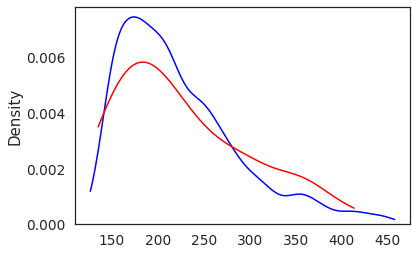

In [50]:
ef_data = ns_genetic_map.get_closest_marker("map", methylation_related_gene_list['gene_str'] )
ef_data['marker_genome_ix'] = ns_genetic_map.markers_map.loc[ef_data['marker_id'],"genome_ix"].values

sns.kdeplot(ns_genetic_map.dev_0_f.sum(0), color="blue", cut = 0 )

sns.kdeplot(ns_genetic_map.dev_0_f.loc[:,ef_data['marker_genome_ix'].unique()].sum(0), color="red", cut = 0 )



In [56]:
print(sp.stats.tukey_hsd(ns_genetic_map.dev_0_f.sum(0), ns_genetic_map.dev_0_f.loc[:,ef_data['marker_genome_ix'].unique()].sum(0)  ))

Tukey's HSD Pairwise Group Comparisons (95.0% Confidence Interval)
Comparison  Statistic  p-value  Lower CI  Upper CI
 (0 - 1)     -4.763     0.520   -19.285     9.758
 (1 - 0)      4.763     0.520    -9.758    19.285



In [10]:
methylation_related_gene_list[(methylation_related_gene_list[0] == "Chr5") & (methylation_related_gene_list[1] > 15554043 ) & (methylation_related_gene_list[2] < 19175842)]

,GeneName,0,1,2,4,5,6,gene_str,gene_len
GeneID,,,,,,,,,
AT5G39550,VIM3,Chr5,15837178.0,15840678.0,0.0,-,protein_coding,"Chr5,15837178,15840678",3500.0
AT5G43810,"AGO10,PNH,ZLL;Stabilizer of iron transporter S...",Chr5,17610744.0,17616907.0,0.0,+,protein_coding,"Chr5,17610744,17616907",6163.0
AT5G43990,SUVR2,Chr5,17697686.0,17702036.0,0.0,+,protein_coding,"Chr5,17697686,17702036",4350.0


In [3]:
methylation_related_gene_list[(methylation_related_gene_list[0] == "Chr5") & (methylation_related_gene_list[1] > 15032197 ) & (methylation_related_gene_list[2] < 19175842)]

,GeneName,0,1,2,4,5,6,gene_str,gene_len
GeneID,,,,,,,,,
AT5G39550,VIM3,Chr5,15837178.0,15840678.0,0.0,-,protein_coding,"Chr5,15837178,15840678",3500.0
AT5G43810,"AGO10,PNH,ZLL;Stabilizer of iron transporter S...",Chr5,17610744.0,17616907.0,0.0,+,protein_coding,"Chr5,17610744,17616907",6163.0
AT5G43990,SUVR2,Chr5,17697686.0,17702036.0,0.0,+,protein_coding,"Chr5,17697686,17702036",4350.0


# Mapping QTLs for epimutations

/users/rahul.pisupati/.conda/envs/py3_quant/lib/python3.9/site-packages/dask/dataframe/core.py:6437: FutureWarning: Meta is not valid, `map_partitions` expects output to be a pandas object. Try passing a pandas object as meta or a dict or tuple representing the (name, dtype) of the columns. In the future the meta you passed will not work.
  warnings.warn(
/groups/nordborg/user/rahul.pisupati/mygit/pyGenome/pygenome/plotting.py:455: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string ":k" (-> color='k'). The keyword argument will take precedence.
  p.ax_joint.plot( (echr[1]['chr_ind_start'] + echr[1]['centro_mid'] , echr[1]['chr_ind_start'] + echr[1]['centro_mid']), plt_limits, ':k', color = "gray")
/groups/nordborg/user/rahul.pisupati/mygit/pyGenome/pygenome/plotting.py:456: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string ":k" (-> color='k'). The keyword argument will take precedence.
  p.ax_joint.plo

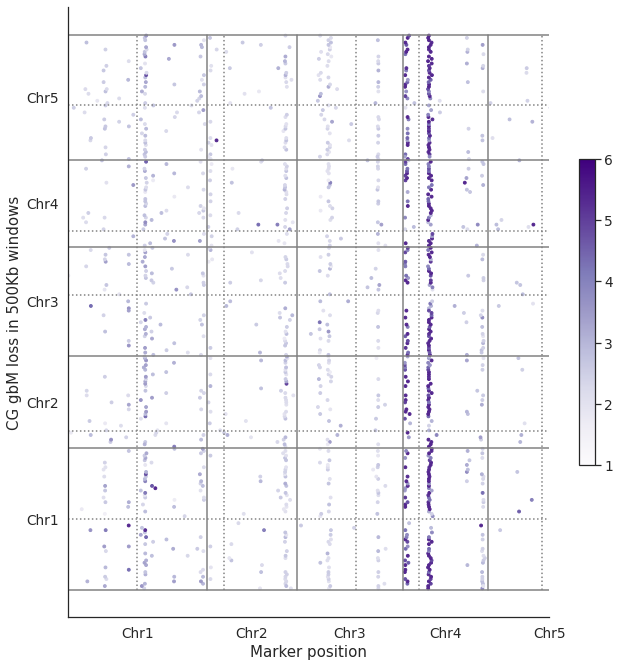

In [7]:
ef_data = ns_genetic_map.get_peaks( "deviation_1_nonpoly_intT", ns_genetic_map.gene_str.index.values, qtl_min=1, qtl_max=6, nprocs = 16)

p = plotting_along_genome.gwas_peaks_matrix(ef_data['genome_marker_ind'].values, ef_data['genome_gene_ind'].values, peak_heights=ef_data['lod'], legend_scale=(1, 6), plt_options = { "xlabel": "Marker position", "ylabel":"CG gbM loss in 500Kb windows", "height": 18 , 'cmap': (cb.sequential.Purples_6.colors, "Purples")})


# # #p.fig.suptitle("6191x6046")

plt.tight_layout()
# plt.savefig("cache_data/qtl.genes.cg.g.pdf", bbox_inches='tight')
plt.show()

/users/rahul.pisupati/.conda/envs/py3_quant/lib/python3.9/site-packages/dask/dataframe/core.py:6437: FutureWarning: Meta is not valid, `map_partitions` expects output to be a pandas object. Try passing a pandas object as meta or a dict or tuple representing the (name, dtype) of the columns. In the future the meta you passed will not work.
  warnings.warn(
/groups/nordborg/user/rahul.pisupati/mygit/pyGenome/pygenome/plotting.py:455: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string ":k" (-> color='k'). The keyword argument will take precedence.
  p.ax_joint.plot( (echr[1]['chr_ind_start'] + echr[1]['centro_mid'] , echr[1]['chr_ind_start'] + echr[1]['centro_mid']), plt_limits, ':k', color = "gray")
/groups/nordborg/user/rahul.pisupati/mygit/pyGenome/pygenome/plotting.py:456: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string ":k" (-> color='k'). The keyword argument will take precedence.
  p.ax_joint.plo

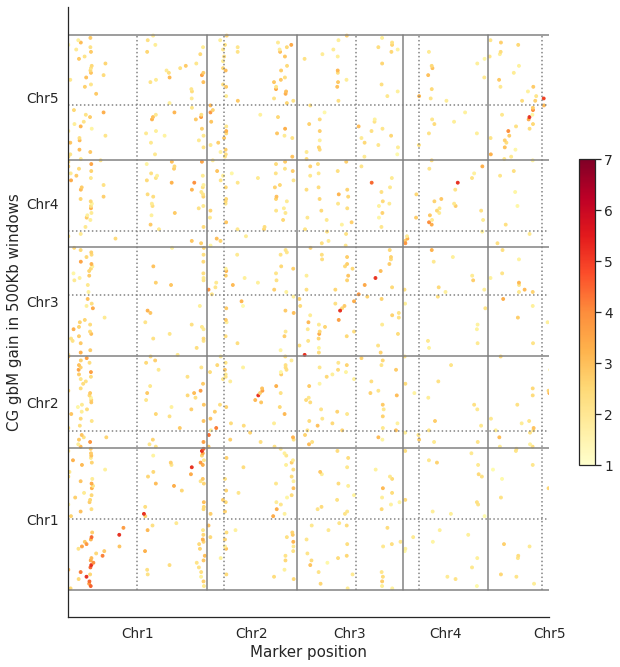

In [8]:
ef_data = ns_genetic_map.get_peaks( "deviation_0_nonpoly_intT", ns_genetic_map.gene_str.index.values, qtl_min=1, qtl_max=6, nprocs = 16)
# ns_genetic_map.get_peaks( "site_deviation_0_intT", ns_genetic_map.gene_str.index.values, qtl_min=1, qtl_max=7, nprocs = 16)

p = plotting_along_genome.gwas_peaks_matrix(ef_data['genome_marker_ind'].values, ef_data['genome_gene_ind'].values, peak_heights=ef_data['lod'], legend_scale=(1, 7), plt_options = { "xlabel": "Marker position", "ylabel":"CG gbM gain in 500Kb windows", "height": 18, 'cmap': (cb.sequential.YlOrRd_6.colors, "YlOrRd") })

# # #p.fig.suptitle("6191x6046")

plt.tight_layout()
# plt.savefig("cache_data/qtl.genes.cg.g.pdf", bbox_inches='tight')
plt.show()

plot DMC density across windows
Look for the changes in chr2 window that maps to chr5.

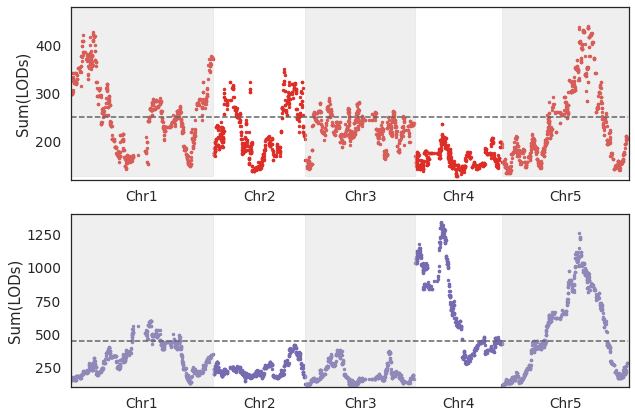

In [5]:
plt_options = dict(patch = cb.sequential.Greys_5.hex_colors[1], line= False,  gap = 0, nsmooth= 10 )

fig, axs = plt.subplots(figsize = (10, 7), nrows = 2)

plotting_along_genome.manhattan_plot(ns_genetic_map.dev_0_f.columns.values, ns_genetic_map.dev_0_f.sum(0).values, plt_options = {**plt_options, 'color': cb.sequential.Reds_5.hex_colors[3]}, axs = axs.flat[0])
# "color": pd.Series( [cb.sequential.YlOrRd_5.hex_colors[3], cb.sequential.YlOrRd_5.hex_colors[2]] ).loc[np.arange(plotting_along_genome.chr_info.shape[0]) % 2 ].values
axs.flat[0].set_xlabel("")
axs.flat[0].set_ylabel("Sum(LODs)")
axs.flat[0].set_ylim((120, 480))

permuted_lods = pyquant.utils.genome_rotations_2d( ns_genetic_map.dev_0_f.dropna().values, 1000 )

axs.flat[0].hlines(np.percentile(permuted_lods, 99, 0).mean(), xmin = 0, xmax = ns_genetic_map.dev_0_f.columns.values.max(), linestyle = "--", color = cb.sequential.Greys_5.hex_colors[3] )
# axs.flat[0].axes.fill_between(np.arange(ns_genetic_map.dev_0_f.shape[1]), 0, np.percentile(permuted_lods, 99, 0), interpolate=True, color = cb.sequential.Reds_6.hex_colors[1], alpha = 0.3 )
# plt.setp(axs.flat[0].get_xticklabels(), visible=False)



plotting_along_genome.manhattan_plot(ns_genetic_map.dev_1_f.columns.values, ns_genetic_map.dev_1_f.sum(0).values, plt_options = {**plt_options, 'color': cb.sequential.Purples_5.hex_colors[3]}, axs = axs.flat[1])
# "color": pd.Series( [cb.sequential.YlOrRd_5.hex_colors[3], cb.sequential.YlOrRd_5.hex_colors[2]] ).loc[np.arange(plotting_along_genome.chr_info.shape[0]) % 2 ].values
axs.flat[1].set_xlabel("")
axs.flat[1].set_ylabel("Sum(LODs)")
axs.flat[1].set_ylim((100, 1400))

permuted_lods = pyquant.utils.genome_rotations_2d( ns_genetic_map.dev_1_f.dropna().values, 1000 )
axs.flat[1].hlines(np.percentile(permuted_lods, 99, 0).mean(), xmin = 0, xmax = ns_genetic_map.dev_1_f.columns.values.max(), linestyle = "--", color = cb.sequential.Greys_5.hex_colors[3] )
# axs.flat[1].axes.fill_between(np.arange(ns_genetic_map.dev_1_f.shape[1]), 0, np.percentile(permuted_lods, 99, 0), interpolate=True, color = "#bdbdbd", alpha = 0.3 )
# plt.setp(axs.flat[0].get_xticklabels(), visible=False)


plt.savefig("qtl.mapping.d1.pdf")

plt.show()

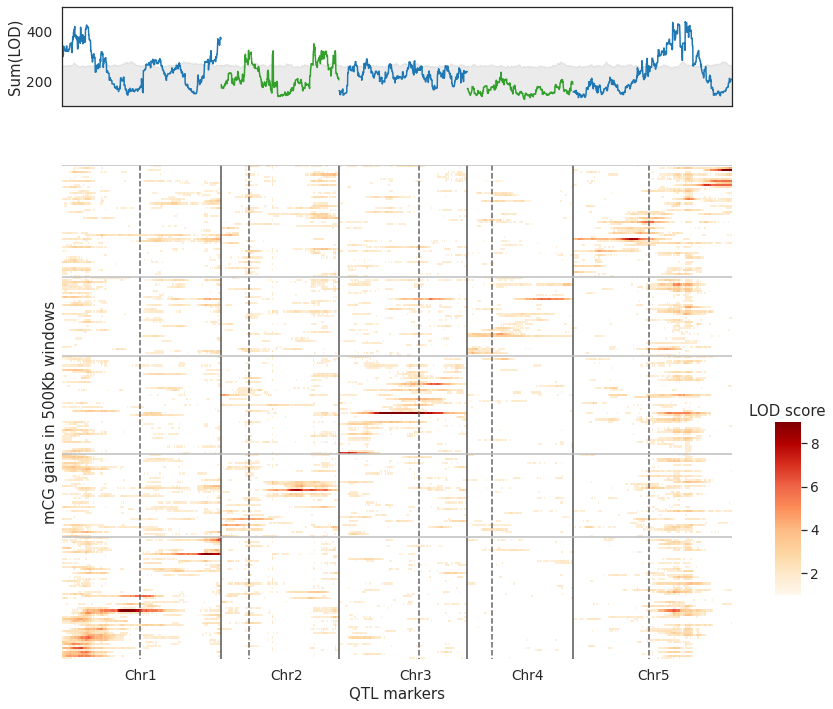

In [20]:
fig, axs = plt.subplots(nrows = 2, ncols=1, sharex = False, gridspec_kw={'height_ratios': [1, 5]}, figsize = (12, 12))


cbar_ax = fig.add_axes([.95, .2, .03, .2])

plotting_along_genome.manhattan_plot(ns_genetic_map.dev_0_f.columns.values, ns_genetic_map.dev_0_f.sum(0).values, plt_options = {"line": True, "gap": 0, "plt_xindex": True }, axs=axs.flat[0])
# "color": pd.Series( [cb.sequential.YlOrRd_5.hex_colors[3], cb.sequential.YlOrRd_5.hex_colors[2]] ).loc[np.arange(plotting_along_genome.chr_info.shape[0]) % 2 ].values
axs.flat[0].set_xlabel("")
axs.flat[0].set_ylabel("Sum(LOD)")
axs.flat[0].set_ylim((100, 500))

permuted_lods = pyquant.utils.genome_rotations_2d( ns_genetic_map.dev_0_f.dropna().values, 1000 )

axs.flat[0].axes.fill_between(np.arange(ns_genetic_map.dev_0_f.shape[1]), 0, np.percentile(permuted_lods, 99.99, 0), interpolate=True, color = "#bdbdbd", alpha = 0.3, rasterized=True )
plt.setp(axs.flat[0].get_xticklabels(), visible=False)

ef_data = ns_genetic_map.dev_0_f.copy()
ef_data[ef_data < 1.5] = np.nan

plotting_along_genome.generate_heatmap_genomewide(ef_data, plt_options = {"lims": (1, 9), "title": "", "xlabel": "QTL markers", "ylabel": "mCG gains in 500Kb windows", "cmap": "OrRd"  }, axs=axs.flat[1], cbar_ax = cbar_ax, annot=False)
for ef_chr in plotting_along_genome.chr_info.iterrows():
    axs.flat[1].hlines(y = int(np.where(ns_genetic_map.dev_0_f.index.str.startswith(ef_chr[1]['chr']))[0].min()), xmin = 0, xmax = ns_genetic_map.dev_0_f.columns.max(), color = "#bdbdbd")


cbar_ax.set_title("LOD score")
# fig.tight_layout(rect=[0, 0, .9, 1])

# plt.savefig("qtl_gains.pdf",bbox_inches='tight', dpi=300 )

plt.show()

In [41]:
ef_t = ns_genetic_map.markers_map.copy()
ef_t['sum_lod'] = ns_genetic_map.dev_0_f.sum(0).values


ef_t[ef_t['sum_lod'].isin( ef_t.groupby("chr")['sum_lod'].max().values )]

,chr,start,end,genome_ix,sum_lod
0,,,,,
Chr1:4855343,Chr1,4855343,4855344,4855343,427.061384
Chr2:15145365,Chr2,15145365,15145366,45573036,351.069426
Chr3:5071722,Chr3,5071722,5071723,55197682,290.254064
Chr4:5773912,Chr4,5773912,5773913,79359702,235.471066
Chr5:18287108,Chr5,18287108,18287109,110457954,440.883232


In [42]:
ef_t = ns_genetic_map.markers_map.copy()
ef_t['sum_lod'] = ns_genetic_map.dev_1_f.sum(0).values


ef_t[ef_t['sum_lod'].isin( ef_t.groupby("chr")['sum_lod'].max().values )]

,chr,start,end,genome_ix,sum_lod
0,,,,,
Chr1:17216700,Chr1,17216700,17216701,17216700,599.461695
Chr2:17456522,Chr2,17456522,17456523,47884193,415.952708
Chr3:7413283,Chr3,7413283,7413284,57539243,380.488504
Chr4:5434750,Chr4,5434750,5434751,79020540,1345.674336
Chr5:16445720,Chr5,16445720,16445721,108616566,1260.414058


In [10]:
import plotly.express as px

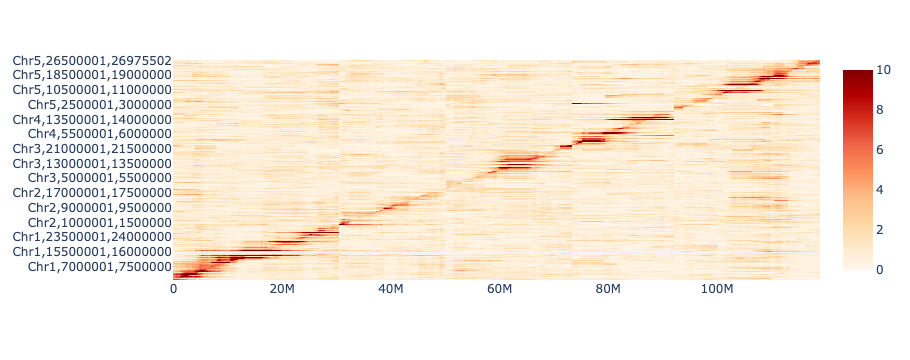

In [21]:
fig = px.imshow( ns_genetic_map.dev_0_f, color_continuous_scale='OrRd', zmin = 0, zmax = 10)

fig.show()

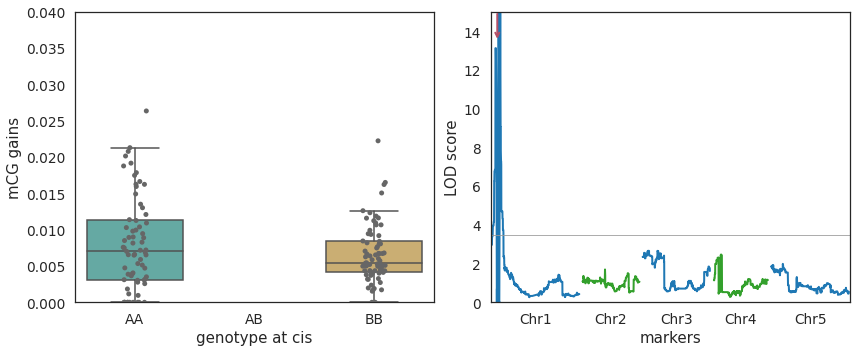

In [24]:
bed_str=ns_genetic_map.dev_0_f.index[-5]
# "Chr4,5000001,5500000"

fig, axs = plt.subplots( figsize = (12,5), ncols=2 )

fig_args = dict(
    data = mc_data, 
    x = "subpop:" + bed_str, 
    y = "deviation_0_poly:" + bed_str, 
    order = ['AA','AB','BB'],
    ax = axs.flat[0]
)

sns.boxplot(**fig_args, palette=color_f2s, fliersize=0)
sns.stripplot(**fig_args, palette=[".4"] * 3 )
fig_args['ax'].set_ylim((0, 0.04))

fig_args['ax'].set_xlabel("genotype at cis")
fig_args['ax'].set_ylabel("mCG gains")




plotting_along_genome.manhattan_plot( x_ind=ns_genetic_map.dev_0_f.columns.values, y_ind=ns_genetic_map.dev_0_f.loc[bed_str,:].values, plt_options={'line': True, 'gap': 1000000}, axs=axs.flat[1], lw = 2  )
axs.flat[1].set_ylim(0,15)
axs.flat[1].set_xlabel("markers")
axs.flat[1].set_ylabel("LOD score")
# axs.flat[1].axvline( x = tair10.get_genomewide_inds(pd.Series(bed_str), gap=1000000), ymin = 0.01, ymax = 0.95, c = 'r', lw = 1.5)
axs.flat[1].annotate('', xy = (tair10.get_genomewide_inds(pd.Series(bed_str), gap=1000000)[0], 13.5), xytext = (tair10.get_genomewide_inds(pd.Series(bed_str), gap=1000000)[0], 15), arrowprops=dict(arrowstyle='->', facecolor='black', edgecolor = "#B25068", lw = 2)) 

axs.flat[1].axhline( xmin = 0, xmax = 1, y = 3.5, c = '.6', lw = 0.8)



fig.tight_layout()
plt.show()

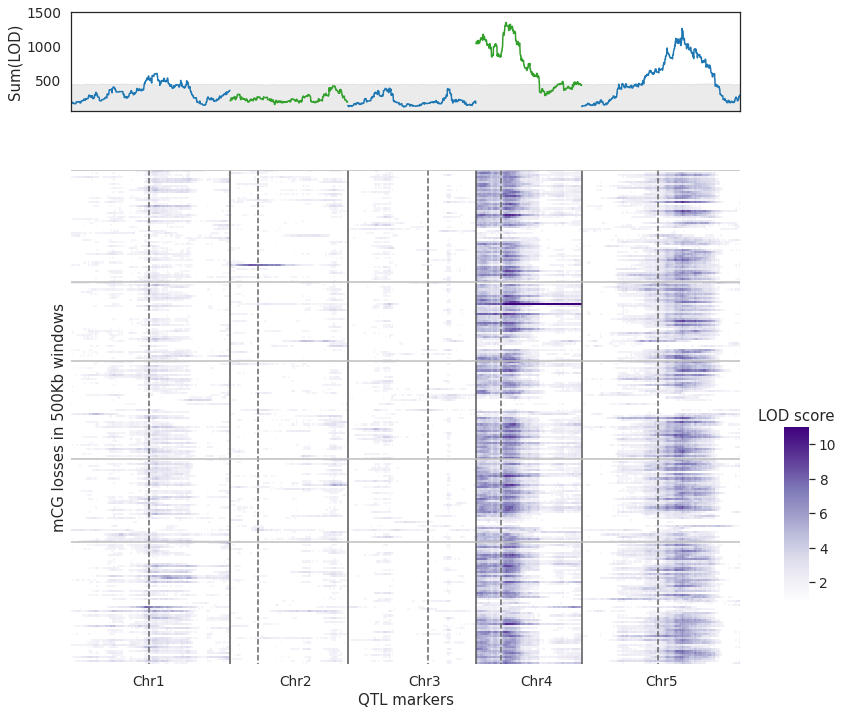

In [7]:
fig, axs = plt.subplots(nrows = 2, ncols=1, sharex = False, gridspec_kw={'height_ratios': [1, 5]}, figsize = (12, 12))


cbar_ax = fig.add_axes([.95, .2, .03, .2])

plotting_along_genome.manhattan_plot(ns_genetic_map.dev_1_f.columns.values, ns_genetic_map.dev_1_f.sum(0).values, plt_options = {"line": True, "gap": 0, "plt_xindex": True }, axs=axs.flat[0])
# "color": pd.Series( [cb.sequential.YlOrRd_5.hex_colors[3], cb.sequential.YlOrRd_5.hex_colors[2]] ).loc[np.arange(plotting_along_genome.chr_info.shape[0]) % 2 ].values
axs.flat[0].set_xlabel("")
axs.flat[0].set_ylabel("Sum(LOD)")
axs.flat[0].set_ylim((50, 1500))

permuted_lods = pyquant.utils.genome_rotations_2d( ns_genetic_map.dev_1_f.dropna().values, 1000 )

axs.flat[0].axes.fill_between(np.arange(ns_genetic_map.dev_1_f.shape[1]), 0, np.percentile(permuted_lods, 99, 0), interpolate=True, color = "#bdbdbd", alpha = 0.3, rasterized=True )
plt.setp(axs.flat[0].get_xticklabels(), visible=False)

ef_data = ns_genetic_map.dev_1_f.copy()
ef_data[ef_data < 1.5] = np.nan
plotting_along_genome.generate_heatmap_genomewide(ef_data, plt_options = {"lims": (1, 11), "title": "", "xlabel": "QTL markers", "ylabel": "mCG losses in 500Kb windows", "cmap": "Purples"  }, axs=axs.flat[1], cbar_ax = cbar_ax, annot=False)
for ef_chr in plotting_along_genome.chr_info.iterrows():
    axs.flat[1].hlines(y = int(np.where(ns_genetic_map.dev_0_f.index.str.startswith(ef_chr[1]['chr']))[0].min()), xmin = 0, xmax = ns_genetic_map.dev_0_f.columns.max(), color = "#bdbdbd")


cbar_ax.set_title("LOD score")
# fig.tight_layout(rect=[0, 0, .9, 1])
plt.savefig("qtl_losses.pdf",bbox_inches='tight', dpi = 300 )

plt.show()

In [ ]:
Chr5:15585328

In [19]:
ef_t = ns_genetic_map.markers_map.copy()
ef_t['sum_lod'] = ns_genetic_map.dev_1_f.sum(0).values

ef_t[ef_t['sum_lod'].isin( ef_t.groupby("chr")['sum_lod'].max().values )]

,chr,start,end,genome_ix,sum_lod
0,,,,,
Chr1:21740818,Chr1,21740818,21740819,21740818,706.752544
Chr2:19073645,Chr2,19073645,19073646,49501316,533.795064
Chr3:18940866,Chr3,18940866,18940867,69066826,473.440765
Chr3:18951171,Chr3,18951171,18951172,69077131,473.440765
Chr4:6013202,Chr4,6013202,6013203,79598992,777.124275
Chr5:16445720,Chr5,16445720,16445721,108616566,993.117245


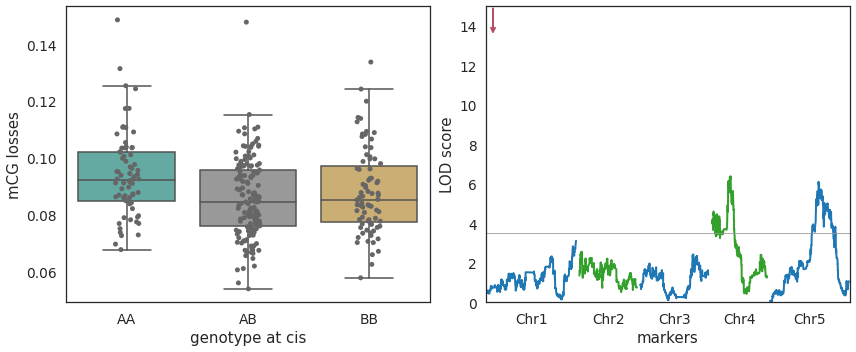

In [14]:
bed_str=ns_genetic_map.dev_1_f.index[-5]
# "Chr4,5000001,5500000"

fig, axs = plt.subplots( figsize = (12,5), ncols=2 )

fig_args = dict(
    data = mc_data, 
    x = "subpop:" + bed_str, 
    y = "deviation_1:" + bed_str, 
    order = ['AA','AB','BB'],
    ax = axs.flat[0]
)

sns.boxplot(**fig_args, palette=color_f2s, fliersize=0)
sns.stripplot(**fig_args, palette=[".4"] * 3 )
# fig_args['ax'].set_ylim((0, 0.004))

fig_args['ax'].set_xlabel("genotype at cis")
fig_args['ax'].set_ylabel("mCG losses")




plotting_along_genome.manhattan_plot( x_ind=ns_genetic_map.dev_1_f.columns.values, y_ind=ns_genetic_map.dev_1_f.loc[bed_str,:].values, plt_options={'line': True, 'gap': 1000000}, axs=axs.flat[1], lw = 2  )
axs.flat[1].set_ylim(0,15)
axs.flat[1].set_xlabel("markers")
axs.flat[1].set_ylabel("LOD score")
# axs.flat[1].axvline( x = tair10.get_genomewide_inds(pd.Series(bed_str), gap=1000000), ymin = 0.01, ymax = 0.95, c = 'r', lw = 1.5)
# plt.arrow(x = tair10.get_genomewide_inds(pd.Series(bed_str), gap=1000000)[0], y = 10, dx = 0, dy = 1, width = 1, ax = axs.flat[1])
axs.flat[1].annotate('', xy = (tair10.get_genomewide_inds(pd.Series(bed_str), gap=1000000)[0], 13.5), xytext = (tair10.get_genomewide_inds(pd.Series(bed_str), gap=1000000)[0], 15), arrowprops=dict(arrowstyle='->', facecolor='black', edgecolor = "#B25068", lw = 2)) 
axs.flat[1].axhline( xmin = 0, xmax = 1, y = 3.5, c = '.6', lw = 0.8)






fig.tight_layout()
plt.show()

## Composite interval mapping

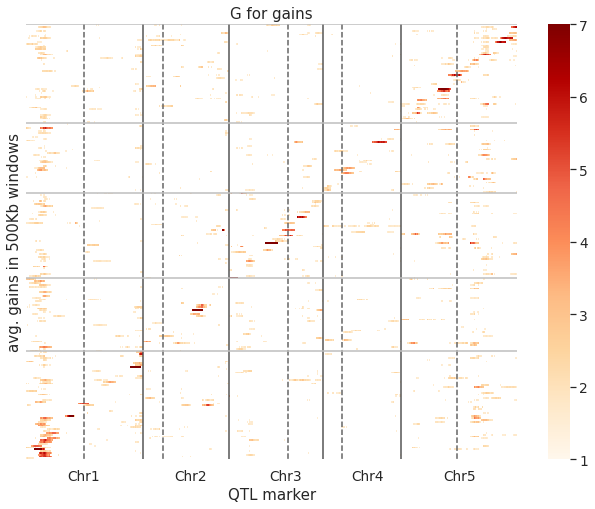

In [57]:
fig, axs = plt.subplots(figsize = (11,8))

ef_data = get_model(ns_genetic_map, "deviation_0_nonpoly_cim")
ef_data[ef_data < 1.5] = np.nan

plotting_along_genome.generate_heatmap_genomewide(ef_data, plt_options = {"lims": (1, 7), "title": "G for gains", "xlabel": "QTL marker", "ylabel": "avg. gains in 500Kb windows", "cmap": "OrRd"  }, axs=axs, annot=False)
for ef_chr in plotting_along_genome.chr_info.iterrows():
    axs.hlines(y = int(np.where(ns_genetic_map_d2.dev_0_f.index.str.startswith(ef_chr[1]['chr']))[0].min()), xmin = 0, xmax = ns_genetic_map_d2.dev_0_f.columns.max(), color = "#bdbdbd")


plt.show()

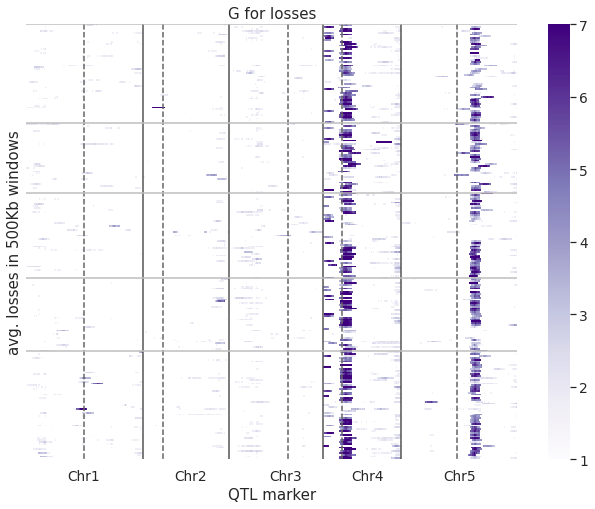

In [61]:
fig, axs = plt.subplots(figsize = (11,8))

ef_data = get_model(ns_genetic_map, "deviation_1_nonpoly_cim")
ef_data[ef_data < 1.5] = np.nan

plotting_along_genome.generate_heatmap_genomewide(ef_data, plt_options = {"lims": (1, 7), "title": "G for losses", "xlabel": "QTL marker", "ylabel": "avg. losses in 500Kb windows", "cmap": "Purples"  }, axs=axs, annot=False)
for ef_chr in plotting_along_genome.chr_info.iterrows():
    axs.hlines(y = int(np.where(ns_genetic_map_d2.dev_0_f.index.str.startswith(ef_chr[1]['chr']))[0].min()), xmin = 0, xmax = ns_genetic_map_d2.dev_0_f.columns.max(), color = "#bdbdbd")


plt.show()

<AxesSubplot:>

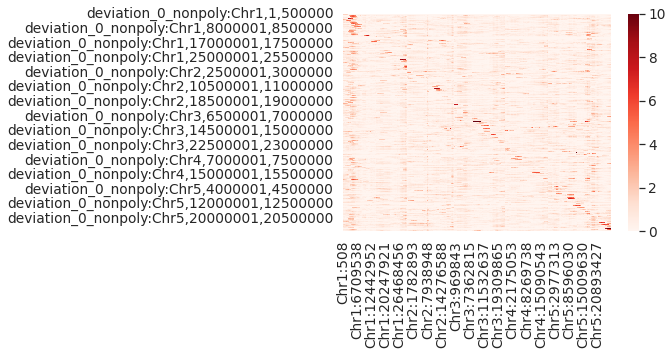

In [10]:
sns.heatmap(cim_gain, vmax=10, vmin = 0, cmap = "Reds")

## Mapping GxE

In [13]:
ns_genetic_map.aov = pd.read_csv("cache_data/epimutation_rates_500Kb_rep2_boxcox_var_decomp_lme.csv", index_col=0)

# ns_genetic_map.anova_data = pd.read_csv( "cache_data/epimutation_rates_500Kb_rep2_boxcox_var_decomp.csv", index_col=0 )
# ns_genetic_map.anova_data['pheno_ix'] = tair10.get_genomewide_inds( pd.Series(ns_genetic_map.anova_data.index) )

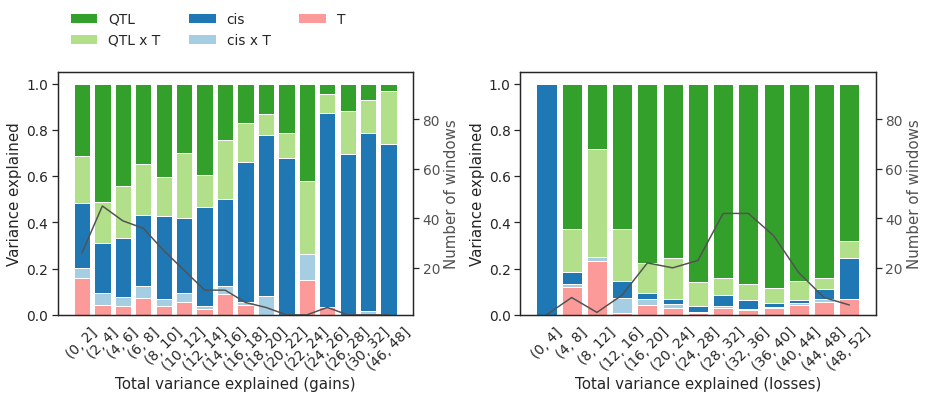

In [51]:
fig, axs = plt.subplots(figsize = (13, 6), ncols = 2, nrows = 1)
plt.cla()




ef_data = ns_genetic_map.aov.copy()
ef_data = ef_data.loc[:,pd.Series(ef_data.columns).str.startswith('gain_var').values]
ef_data.columns = pd.Series(ef_data.columns).str.replace("gain_var_", "")
ef_data  = ef_data.loc[:,ef_data.columns != 'resid']
ef_data['var_exp'] = ef_data.sum(1).values
ef_data = ef_data[(ef_data['var_exp'] > 0) & (ef_data['var_exp'] < 1)]
ef_data.loc[:,~ef_data.columns.str.startswith('var_exp')] = ef_data.loc[:, ~ef_data.columns.str.startswith( 'var_exp' ) ].apply(lambda x : x / ef_data['var_exp'], axis = 0)

ef_data['var_exp_fac'] = pd.cut(ef_data['var_exp'], np.arange(0, ef_data['var_exp'].max() + 0.02,  step = 0.02))

fig_options= dict(ax = axs.flat[0], data = ef_data.groupby('var_exp_fac').mean().dropna(), raw_data = ef_data )
fig_options['nind'] = np.arange(fig_options['data'].index.shape[0])

fig_options['ax'].set_xlabel("Total variance explained (gains)")
fig_options['ax'].set_ylabel("Variance explained")
# fig_options['ax'].set_ylim(0.001, fig_options['data'].index[-1].right + 0.05 )
fig_options['ax'].set_ylim(0, 1.05)
# fig_options['ax'].set_title("gains")

fig_options['ax'].bar(fig_options['nind'], fig_options['data']['temp'], color = cb.qualitative.Paired_6.hex_colors[4], label = 'T')
ef_0 = fig_options['data']['temp'].copy()

fig_options['ax'].bar(fig_options['nind'], fig_options['data']['tempxcis'], bottom = ef_0, color = cb.qualitative.Paired_6.hex_colors[0], label = 'cis x T' )
ef_0 += fig_options['data']['tempxcis']

fig_options['ax'].bar(fig_options['nind'], fig_options['data']['cis'], bottom = ef_0, color = cb.qualitative.Paired_6.hex_colors[1], label = 'cis' )
ef_0 += fig_options['data']['cis']

fig_options['ax'].bar(fig_options['nind'], fig_options['data'].loc[:,['tempxqtlV1', 'tempxqtlV2']].sum(1).values, bottom = ef_0, color = cb.qualitative.Paired_6.hex_colors[2], label = "QTL x T" )
ef_0 += fig_options['data'].loc[:,['tempxqtlV1', 'tempxqtlV2']].sum(1).values


fig_options['ax'].bar(fig_options['nind'], fig_options['data'].loc[:,['qtl_V1', 'qtl_V2']].sum(1).values, bottom = ef_0, color = cb.qualitative.Paired_6.hex_colors[3], label = 'QTL' )
ef_0 += fig_options['data'].loc[:,['qtl_V1', 'qtl_V2']].sum(1).values

# fig_options['ax'].set_yticks(np.arange(0, fig_options['data'].index.shape[0], 1))

fig_options['ax'].set_xticks(np.arange(0, fig_options['data'].index.shape[0], 1))
fig_options['ax'].set_xticklabels( [ '(%.0f, %.0f]' % (ef.left * 100,ef.right * 100) for ef in fig_options['data'].index[np.arange(0, fig_options['data'].index.shape[0], 1)]], rotation=45 )


handles, labels = fig_options['ax'].get_legend_handles_labels()
fig_options['ax'].legend(handles[::-1], labels[::-1], loc='upper left', frameon = False, bbox_to_anchor=(0, 1.3), ncol = 3 )


ax2 = fig_options['ax'].twinx()
ax2.set_ylim(1, 99)
sns.lineplot(x = fig_options['nind'], y = fig_options['raw_data'].groupby('var_exp_fac').count().loc[ fig_options['data'].index, 'temp'].values, ax=ax2, color = "#525252" )
ax2.set_ylabel('Number of windows', color='#525252')
ax2.tick_params(axis='y', labelcolor="#525252")




fig_options= dict(ax = axs.flat[1])

ef_data = ns_genetic_map.aov.copy()
ef_data = ef_data.loc[:,pd.Series(ef_data.columns).str.startswith('loss_var').values]
ef_data.columns = pd.Series(ef_data.columns).str.replace("loss_var_", "")
ef_data  = ef_data.loc[:,ef_data.columns != 'resid']
ef_data['var_exp'] = ef_data.sum(1).values
ef_data = ef_data[(ef_data['var_exp'] > 0) & (ef_data['var_exp'] < 1)]
ef_data.loc[:,~ef_data.columns.str.startswith('var_exp')] = ef_data.loc[:, ~ef_data.columns.str.startswith( 'var_exp' ) ].apply(lambda x : x / ef_data['var_exp'], axis = 0)
ef_data['var_exp_fac'] = pd.cut(ef_data['var_exp'], np.arange(0, ef_data['var_exp'].max() + 0.04,  step = 0.04))

fig_options= dict(ax = axs.flat[1], data = ef_data.groupby('var_exp_fac').mean().dropna(), raw_data = ef_data )
fig_options['nind'] = np.arange(fig_options['data'].index.shape[0])
fig_options['ax'].set_xlabel("Total variance explained (losses)")
fig_options['ax'].set_ylabel("Variance explained")
# fig_options['ax'].set_ylim(0.001, fig_options['data'].index[-1].right + 0.05 )
fig_options['ax'].set_ylim(0, 1.05)
# fig_options['ax'].set_title("losses")

fig_options['ax'].bar(fig_options['nind'], fig_options['data']['temp'], color = cb.qualitative.Paired_6.hex_colors[4] )
ef_0 = fig_options['data']['temp'].copy()

fig_options['ax'].bar(fig_options['nind'], fig_options['data']['tempxcis'], bottom = ef_0, color = cb.qualitative.Paired_6.hex_colors[0] )
ef_0 += fig_options['data']['tempxcis']

fig_options['ax'].bar(fig_options['nind'], fig_options['data']['cis'], bottom = ef_0, color = cb.qualitative.Paired_6.hex_colors[1] )
ef_0 += fig_options['data']['cis']

fig_options['ax'].bar(fig_options['nind'], fig_options['data'].loc[:,['tempxqtlV1', 'tempxqtlV2', 'tempxqtlV3' ]].sum(1).values, bottom = ef_0, color = cb.qualitative.Paired_6.hex_colors[2] )
ef_0 += fig_options['data'].loc[:,['tempxqtlV1', 'tempxqtlV2','tempxqtlV3']].sum(1).values


fig_options['ax'].bar(fig_options['nind'], fig_options['data'].loc[:,['qtl_V1', 'qtl_V2','qtl_V3']].sum(1).values, bottom = ef_0, color = cb.qualitative.Paired_6.hex_colors[3] )
ef_0 += fig_options['data'].loc[:,['qtl_V1', 'qtl_V2','qtl_V3']].sum(1).values

# fig_options['ax'].set_yticks(np.arange(0, fig_options['data'].index.shape[0], 1))

fig_options['ax'].set_xticks(np.arange(0, fig_options['data'].index.shape[0], 1))
fig_options['ax'].set_xticklabels( [ '(%.0f, %.0f]' % (ef.left * 100,ef.right * 100) for ef in fig_options['data'].index[np.arange(0, fig_options['data'].index.shape[0], 1)]], rotation=45 )


ax2 = fig_options['ax'].twinx()
ax2.set_ylim(1, 99)
sns.lineplot(x = fig_options['nind'], y = fig_options['raw_data'].groupby( 'var_exp_fac' ).count().loc[ fig_options['data'].index, 'temp'].values, ax=ax2, color = "#525252" )
ax2.set_ylabel('Number of windows', color='#525252')
ax2.tick_params(axis='y', labelcolor="#525252")

fig.tight_layout()


plt.savefig("var_comp_lme.pdf")

plt.show()

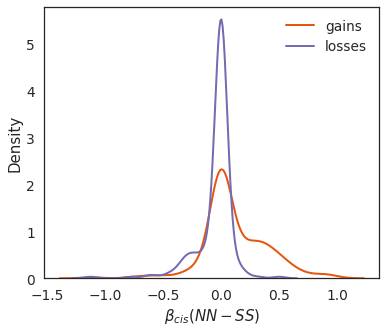

In [130]:
fig, axs = plt.subplots(figsize = (6, 5), nrows = 1)


sns.kdeplot( ns_genetic_map.aov['gain_beta_cis'], ax = axs, color=cb.sequential.Oranges_5.hex_colors[3], label = "gains", lw = 2 )
sns.kdeplot( ns_genetic_map.aov['loss_beta_cis'], ax = axs, color=cb.sequential.Purples_5.hex_colors[3], label = "losses", lw = 2 )

axs.set_xlabel( r'$\beta_{cis} (NN - SS) $' )

axs.legend(frameon = False)

plt.savefig("cis_direction.pdf")

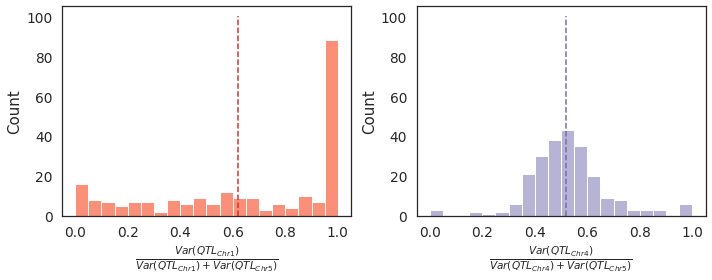

In [52]:
fig, axs = plt.subplots( figsize = (10, 4), ncols = 2 )

x = ns_genetic_map.aov['gain_var_qtl_V1'] + ns_genetic_map.aov['gain_var_tempxqtlV1']
y = ns_genetic_map.aov['gain_var_qtl_V2'] + ns_genetic_map.aov['gain_var_tempxqtlV2']
sns.histplot( x / (x + y), binwidth=0.05, ax = axs.flat[0], color = cb.sequential.Reds_5.hex_colors[2])
axs.flat[0].vlines( x=x.mean() / (x.mean() + y.mean()), ymin=0, ymax = 100, ls = '--', color = cb.sequential.Reds_5.hex_colors[3])
axs.flat[0].set_xlabel(r'$ \frac{Var(QTL_{Chr1})}{Var(QTL_{Chr1}) + Var(QTL_{Chr5})} $')


x = ns_genetic_map.aov['loss_var_qtl_V2'] + ns_genetic_map.aov['loss_var_tempxqtlV2']
y = ns_genetic_map.aov['loss_var_qtl_V3'] + ns_genetic_map.aov['loss_var_tempxqtlV3']
sns.histplot( x / (x + y), binwidth=0.05, ax = axs.flat[1], color = cb.sequential.Purples_5.hex_colors[2])
axs.flat[1].vlines( x=x.mean() / (x.mean() + y.mean()), ymin=0, ymax = 100, ls = '--', color = cb.sequential.Purples_5.hex_colors[3])
axs.flat[1].set_xlabel(r'$ \frac{Var(QTL_{Chr4})}{Var(QTL_{Chr4}) + Var(QTL_{Chr5})} $')


fig.tight_layout()

plt.savefig( "qtl_effects_two.pdf" )


plt.show()

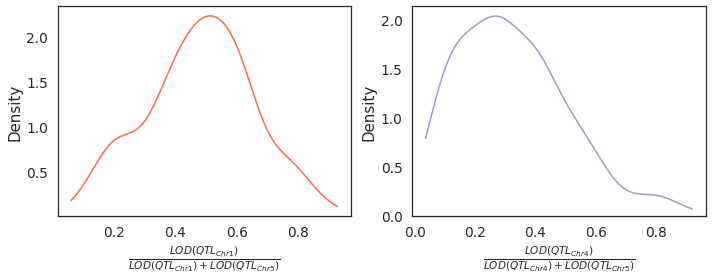

In [51]:
# [4855343,110457954]
# [79020540,108616566]

fig, axs = plt.subplots( figsize = (10, 4), ncols = 2 )

x = ns_genetic_map.dev_0_f[4855343]
y = ns_genetic_map.dev_0_f[110457954]
# sns.histplot( x / (x + y), binwidth=0.05, ax = axs.flat[0], color = cb.sequential.Reds_5.hex_colors[2])
sns.kdeplot( x / (x + y), ax = axs.flat[0], color = cb.sequential.Reds_5.hex_colors[2], cut = 0)
# axs.flat[0].vlines( x=x.mean() / (x.mean() + y.mean()), ymin=0, ymax = 100, ls = '--', color = cb.sequential.Reds_5.hex_colors[3])
axs.flat[0].set_xlabel(r'$ \frac{LOD(QTL_{Chr1})}{LOD(QTL_{Chr1}) + LOD(QTL_{Chr5})} $')


x = ns_genetic_map.dev_0_f[79020540]
y = ns_genetic_map.dev_0_f[108616566]
# sns.histplot( x / (x + y), binwidth=0.05, ax = axs.flat[1], color = cb.sequential.Purples_5.hex_colors[2])
# axs.flat[1].vlines( x=x.mean() / (x.mean() + y.mean()), ymin=0, ymax = 100, ls = '--', color = cb.sequential.Purples_5.hex_colors[3])
sns.kdeplot( x / (x + y), ax = axs.flat[1], color = cb.sequential.Purples_5.hex_colors[2], cut = 0)
axs.flat[1].set_xlabel(r'$ \frac{LOD(QTL_{Chr4})}{LOD(QTL_{Chr4}) + LOD(QTL_{Chr5})} $')


fig.tight_layout()

# plt.savefig( "qtl_effects_two.pdf" )


plt.show()

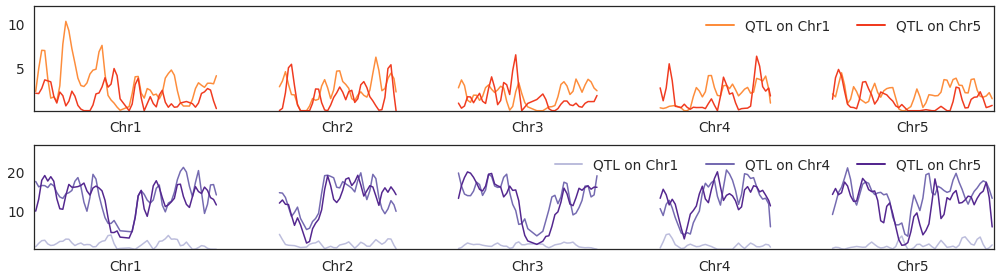

In [64]:
fig_options= dict(nsmooth = 1)



fig, axs = plt.subplots(figsize = (14, 4), nrows = 2, sharex = False)

plotting_along_genome.manhattan_plot( x_ind=tair10.get_genomewide_inds(pd.Series(ns_genetic_map.aov.index)), y_ind=(ns_genetic_map.aov['gain_var_qtl_V1'].values + ns_genetic_map.aov['gain_var_tempxqtlV1'].values) * 100, plt_options=dict(line = True, color = cb.sequential.YlOrRd_6.hex_colors[3], nsmooth = fig_options['nsmooth'], label = 'QTL on Chr1'), axs=axs.flat[0] )

plotting_along_genome.manhattan_plot( x_ind=tair10.get_genomewide_inds(pd.Series(ns_genetic_map.aov.index)), y_ind=(ns_genetic_map.aov['gain_var_qtl_V2'].values + ns_genetic_map.aov['gain_var_tempxqtlV2'].values) * 100, plt_options=dict(line = True, color = cb.sequential.YlOrRd_6.hex_colors[4], nsmooth = fig_options['nsmooth'], label = 'QTL on Chr5'), axs=axs.flat[0] )
axs.flat[0].legend(axs.flat[0].custum_legend[0], axs.flat[0].custum_legend[1], ncol = 3, frameon = False )
axs.flat[0].set_ylim(0.001, 12)
# axs.flat[0].set_ylabel("Variance explained")

plotting_along_genome.manhattan_plot( x_ind=tair10.get_genomewide_inds(pd.Series(ns_genetic_map.aov.index)), y_ind=(ns_genetic_map.aov['loss_var_qtl_V1'].values + ns_genetic_map.aov['loss_var_tempxqtlV1'].values) * 100, plt_options=dict(line = True, color = cb.sequential.Purples_6.hex_colors[2], nsmooth = fig_options['nsmooth'], label = 'QTL on Chr1'), axs=axs.flat[1] )
plotting_along_genome.manhattan_plot( x_ind=tair10.get_genomewide_inds(pd.Series(ns_genetic_map.aov.index)), y_ind=(ns_genetic_map.aov['loss_var_qtl_V2'].values + ns_genetic_map.aov['loss_var_tempxqtlV2'].values) * 100, plt_options=dict(line = True, color = cb.sequential.Purples_6.hex_colors[4], nsmooth = fig_options['nsmooth'], label = 'QTL on Chr4'), axs=axs.flat[1] )

plotting_along_genome.manhattan_plot( x_ind=tair10.get_genomewide_inds(pd.Series(ns_genetic_map.aov.index)), y_ind=(ns_genetic_map.aov['loss_var_qtl_V3'].values + ns_genetic_map.aov['loss_var_tempxqtlV3'].values) * 100, plt_options=dict(line = True, color = cb.sequential.Purples_6.hex_colors[5], nsmooth = fig_options['nsmooth'], label = 'QTL on Chr5'), axs=axs.flat[1] )
axs.flat[1].legend(axs.flat[1].custum_legend[0], axs.flat[1].custum_legend[1], ncol = 3, frameon = False  )
axs.flat[1].set_ylim(0.001, 27)
# axs.flat[1].set_ylabel("Variance explained")
# axs.flat[1].set_xlabel("")

fig.tight_layout()


plt.savefig( "qtl_effects_across_genome.pdf" )

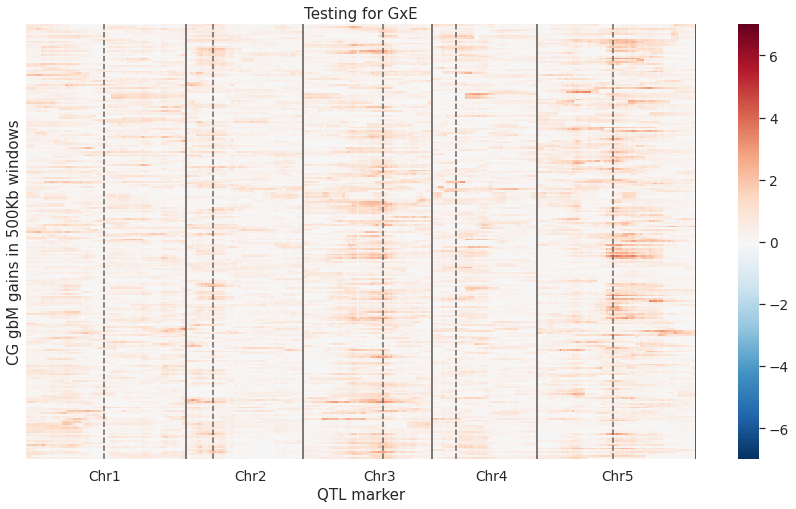

In [23]:
p = plotting_along_genome.generate_heatmap_genomewide( ns_genetic_map.dev_0_f - ns_genetic_map.dev_0_a, plt_options = {"lims": (-7, 7), "title": "Testing for GxE", "xlabel": "QTL marker", "ylabel": "CG gbM gains in 500Kb windows", "cmap": "RdBu_r"  } )

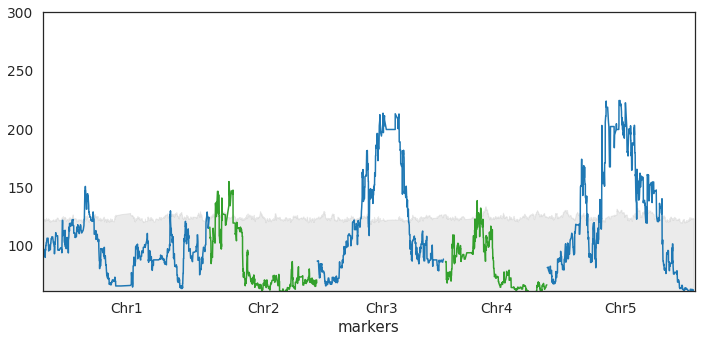

In [34]:
fig, axs = plt.subplots(figsize = (10, 5))


plotting_along_genome.manhattan_plot(ns_genetic_map.dev_0_f.columns.values, (ns_genetic_map.dev_0_f - ns_genetic_map.dev_0_a).sum(0).values, axs=axs, plt_options = {'gap': 0, 'line': True, 'ylim': (60, 300)})

permuted_lods = pyquant.utils.genome_rotations_2d( (ns_genetic_map.dev_0_f - ns_genetic_map.dev_0_a).dropna().values, 1000 )

axs.axes.fill_between(ns_genetic_map.dev_0_f.columns.values, 0, np.percentile(permuted_lods, 99.99, 0), interpolate=True, color = "#bdbdbd", alpha = 0.3 )

# axs.axes.fill_between(ns_genetic_map.dev_0_f.columns.values, np.percentile(permuted_lods, 5, 0), np.percentile(permuted_lods, 95, 0), interpolate=True, color = "#bdbdbd", alpha = 0.3 )

fig.tight_layout()

<AxesSubplot:title={'center':'Testing for GxE'}, xlabel='QTL marker', ylabel='CG gbM losses in 500Kb windows'>

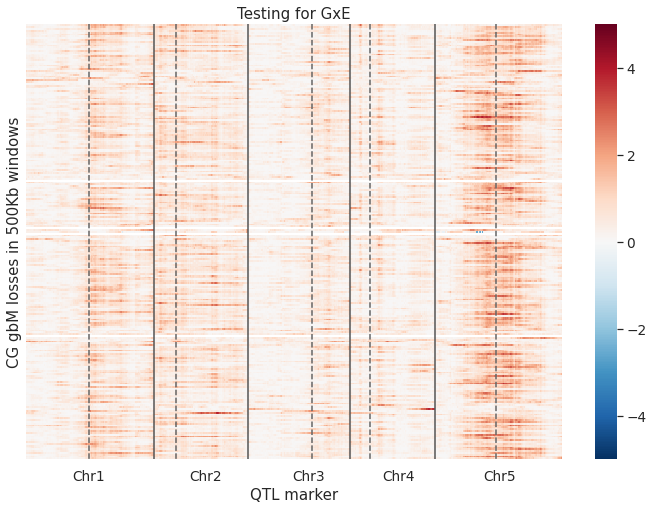

In [65]:
fig, axs = plt.subplots(figsize = (12, 8))

plotting_along_genome.generate_heatmap_genomewide( ns_genetic_map.dev_1_f - ns_genetic_map.dev_1_a, plt_options = {"lims": (-5, 5), "title": "Testing for GxE", "xlabel": "QTL marker", "ylabel": "CG gbM losses in 500Kb windows", "cmap": "RdBu_r"  }, axs = axs  )

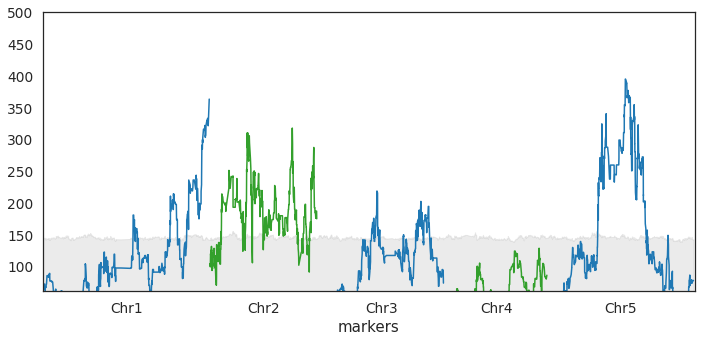

In [39]:
fig, axs = plt.subplots(figsize = (10, 5))


plotting_along_genome.manhattan_plot(ns_genetic_map.dev_1_f.columns.values, (ns_genetic_map.dev_1_f - ns_genetic_map.dev_1_a).sum(0).values, axs=axs, plt_options = {'gap': 0, 'line': True, 'ylim': (60, 500)})

permuted_lods = pyquant.utils.genome_rotations_2d( (ns_genetic_map.dev_1_f - ns_genetic_map.dev_1_a).dropna().values, 1000 )
axs.axes.fill_between(ns_genetic_map.dev_0_f.columns.values, 0, np.percentile(permuted_lods, 99.99, 0), interpolate=True, color = "#bdbdbd", alpha = 0.3 )
# axs.axes.fill_between(ns_genetic_map.dev_1_f.columns.values, np.percentile(permuted_lods, 5, 0), np.percentile(permuted_lods, 95, 0), interpolate=True, color = "#bdbdbd", alpha = 0.3 )

fig.tight_layout()

## GWAS for deviations on 10vs16 data

In [49]:
%%time
# snps_swedes.gwas_result = snps_swedes.load_output_result( "/groups/nordborg/projects/cegs/rahul/002.cegs.10vs16/101.cache_data/gwas.swedes.deviation_1.h5" )
# snps_swedes.gwas_result = snps_swedes.load_output_result("/groups/nordborg/projects/cegs/rahul/002.cegs.10vs16/002.mapping.sra/bismark/deviations/pylmm_result/gwas.pheno.dev_0_Chr4.pval.hdf5", maf_filter = 0.02 )
snps_swedes.gwas_dev_0 = snps_swedes.load_gwas_result("/groups/nordborg/projects/cegs/rahul/002.cegs.10vs16/002.mapping.sra/bismark/deviations/pylmm_result/gwas.pheno.dev_0_Chr1.pval.hdf5")
snps_swedes.gwas_dev_0['data'] = snps_swedes.gwas_dev_0['data'][snps_swedes.gwas_dev_0['data']['maf_filter']]




snps_swedes.gwas_dev_1 = snps_swedes.load_gwas_result("/groups/nordborg/projects/cegs/rahul/002.cegs.10vs16/002.mapping.sra/bismark/deviations/pylmm_result/gwas.pheno.dev_1_Chr1.pval.hdf5", maf_filter = 0.02 )
snps_swedes.gwas_dev_1['data'] = snps_swedes.gwas_dev_1['data'][snps_swedes.gwas_dev_1['data']['maf_filter']]

CPU times: user 2.96 s, sys: 629 ms, total: 3.59 s
Wall time: 5.31 s


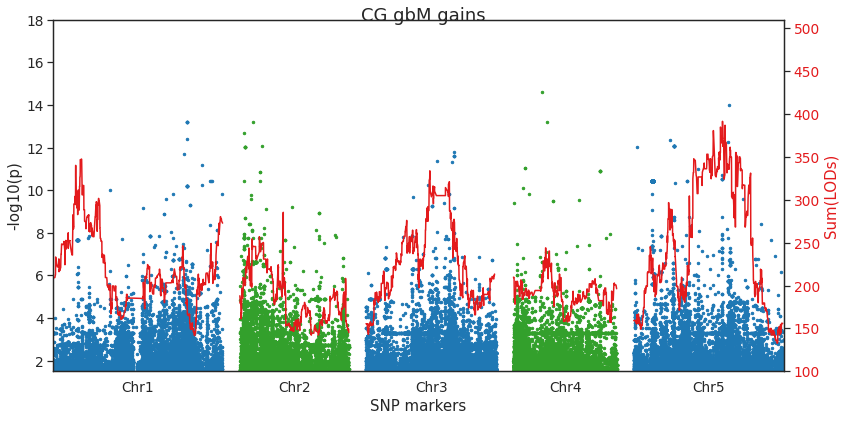

In [51]:
fig, ax1 = plt.subplots(figsize = (12, 6))

plotting_along_genome.manhattan_plot( x_ind=tair10.get_genomewide_inds( snps_swedes.gwas_dev_0['data'].iloc[:,[0,1]] ), y_ind= snps_swedes.gwas_dev_0[ 'data' ]['logpvalue'].values, plt_options={"ylim": (1.5, 18), "gap": 3000000}, axs=ax1)
# ax1.plot((0, 1000000000), (-np.log10(data_lmm.gwas_result['bh_thres']), -np.log10(data_lmm.gwas_result['bh_thres'])), 'r-')
ax1.set_ylabel('-log10(p)')
ax1.set_xlabel('SNP markers')

ax2 = ax1.twinx()

plotting_along_genome.manhattan_plot(ns_genetic_map.dev_0_f.columns.values, ns_genetic_map.dev_0_f.sum(0).values, plt_options = {"line": True,"color": "#e31a1c", "gap": 3000000, "ylim": (100, 510)}, axs=ax2)
ax2.set_ylabel('Sum(LODs)', color='#e31a1c')
ax2.tick_params(axis='y', labelcolor="#e31a1c")


fig.suptitle("CG gbM gains")
fig.tight_layout()

# plt.savefig("meths_gwas_qtl.png", dpi = 400)
plt.show()

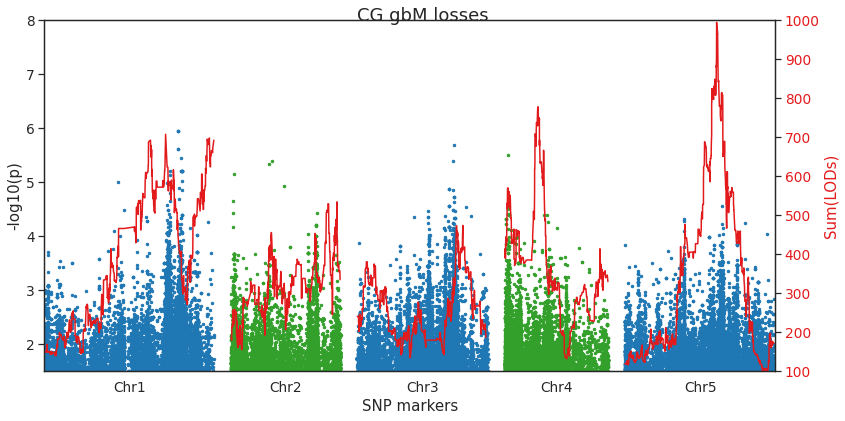

In [52]:
fig, ax1 = plt.subplots(figsize = (12, 6))

plotting_along_genome.manhattan_plot( x_ind=tair10.get_genomewide_inds( snps_swedes.gwas_dev_1['data'].iloc[:,[0,1]] ), y_ind= snps_swedes.gwas_dev_1[ 'data' ]['logpvalue'].values, plt_options={"ylim": (1.5, 8), "gap": 3000000}, axs=ax1)
# ax1.plot((0, 1000000000), (-np.log10(data_lmm.gwas_result['bh_thres']), -np.log10(data_lmm.gwas_result['bh_thres'])), 'r-')
ax1.set_ylabel('-log10(p)')
ax1.set_xlabel('SNP markers')

ax2 = ax1.twinx()

plotting_along_genome.manhattan_plot(ns_genetic_map.dev_1_f.columns.values, ns_genetic_map.dev_1_f.sum(0).values, plt_options = {"line": True,"color": "#e31a1c", "gap": 3000000, "ylim": (100, 1000)}, axs=ax2)
ax2.set_ylabel('Sum(LODs)', color='#e31a1c')
ax2.tick_params(axis='y', labelcolor="#e31a1c")

fig.suptitle("CG gbM losses")

fig.tight_layout()

# plt.savefig("meths_gwas_qtl.png", dpi = 400)
plt.show()

In [59]:
%%time
snps_1001g.gwas_dev_0 = snps_1001g.load_gwas_result("/groups/nordborg/projects/cegs/rahul/009.1001methylomes.rawdata/014.calc_deviations/pylmm_result/gwas.pheno.dev_0_Chr1.pval.hdf5", maf_filter = 0.02 )
snps_1001g.gwas_dev_0['data'] = snps_1001g.gwas_dev_0['data'][snps_1001g.gwas_dev_0['data']['maf_filter']]

CPU times: user 4 s, sys: 1.43 s, total: 5.43 s
Wall time: 5.44 s


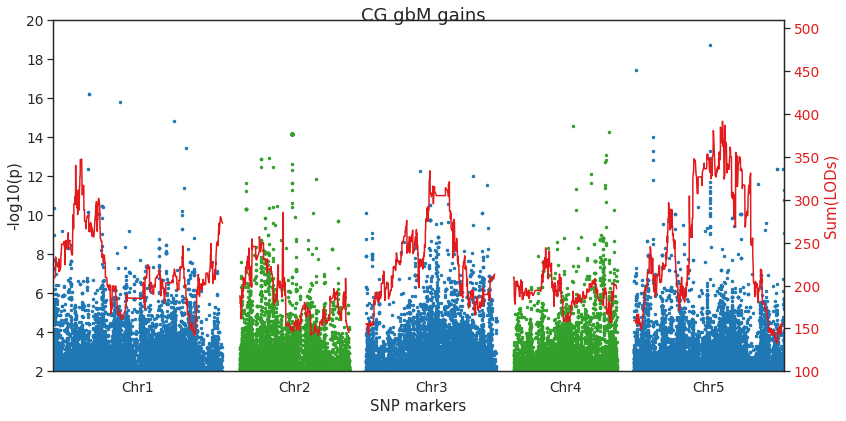

In [60]:
fig, ax1 = plt.subplots(figsize = (12, 6))

plotting_along_genome.manhattan_plot( x_ind=tair10.get_genomewide_inds( snps_1001g.gwas_dev_0['data'].iloc[:,[0,1]] ), y_ind= snps_1001g.gwas_dev_0[ 'data' ]['logpvalue'].values, plt_options={"ylim": (2, 20), "gap": 3000000}, axs=ax1)
# ax1.plot((0, 1000000000), (-np.log10(data_lmm.gwas_result['bh_thres']), -np.log10(data_lmm.gwas_result['bh_thres'])), 'r-')
ax1.set_ylabel('-log10(p)')
ax1.set_xlabel('SNP markers')

ax2 = ax1.twinx()

plotting_along_genome.manhattan_plot(ns_genetic_map.dev_0_f.columns.values, ns_genetic_map.dev_0_f.sum(0).values, plt_options = {"line": True,"color": "#e31a1c", "gap": 3000000, "ylim": (100, 510)}, axs=ax2)
ax2.set_ylabel('Sum(LODs)', color='#e31a1c')
ax2.tick_params(axis='y', labelcolor="#e31a1c")


fig.suptitle("CG gbM gains")
fig.tight_layout()

# plt.savefig("meths_gwas_qtl.png", dpi = 400)
plt.show()

In [57]:
%%time
snps_1001g.gwas_dev_1 = snps_1001g.load_gwas_result("/groups/nordborg/projects/cegs/rahul/009.1001methylomes.rawdata/014.calc_deviations/pylmm_result/gwas.pheno.dev_1_Chr1.pval.hdf5", maf_filter = 0.02 )
snps_1001g.gwas_dev_1['data'] = snps_1001g.gwas_dev_1['data'][snps_1001g.gwas_dev_1['data']['maf_filter']]


CPU times: user 3.81 s, sys: 1.54 s, total: 5.34 s
Wall time: 5.43 s


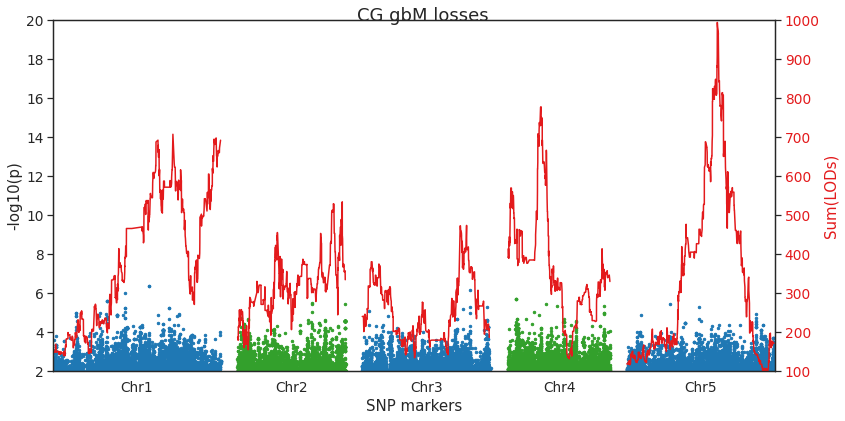

In [58]:
fig, ax1 = plt.subplots(figsize = (12, 6))

plotting_along_genome.manhattan_plot( x_ind=tair10.get_genomewide_inds( snps_1001g.gwas_dev_1['data'].iloc[:,[0,1]] ), y_ind= snps_1001g.gwas_dev_1[ 'data' ]['logpvalue'].values, plt_options={"ylim": (2, 20), "gap": 3000000}, axs=ax1)
# ax1.plot((0, 1000000000), (-np.log10(data_lmm.gwas_result['bh_thres']), -np.log10(data_lmm.gwas_result['bh_thres'])), 'r-')
ax1.set_ylabel('-log10(p)')
ax1.set_xlabel('SNP markers')

ax2 = ax1.twinx()

plotting_along_genome.manhattan_plot(ns_genetic_map.dev_1_f.columns.values, ns_genetic_map.dev_1_f.sum(0).values, plt_options = {"line": True,"color": "#e31a1c", "gap": 3000000, "ylim": (100, 1000)}, axs=ax2)
ax2.set_ylabel('Sum(LODs)', color='#e31a1c')
ax2.tick_params(axis='y', labelcolor="#e31a1c")


fig.suptitle("CG gbM losses")
fig.tight_layout()

# plt.savefig("meths_gwas_qtl.png", dpi = 400)
plt.show()

## Mapping QTLs for gains and losses for gene clusters

* 1: House keeping
* 2: Expressed with H2AZ and low CG
* 3: Intron less with H2AZ GB
* 4: Bivalent (active + repressive marks)
* 5,6,7: Polycomb
* 8: Genes with H2AW (heterochromatic)

In [20]:
%%time

qtl_maps_cls = {}
qtl_maps_cls['data'] = pd.read_csv( proj_dir + "/epimutation_rates/qtl_maps_deviations_gene_cls.csv", sep ="\t", header=None, index_col=0 )
qtl_maps_cls['data'].columns = ns_genetic_map.markers_map['genome_ix'].values


qtl_maps_cls['dev_0'] = qtl_maps_cls['data'][qtl_maps_cls['data'].index.str.contains("deviation_0_nonpoly_intT")]
qtl_maps_cls['dev_0'].index = pd.Series(qtl_maps_cls['dev_0'].index).str.replace(".deviation_0_nonpoly_intT","").values


qtl_maps_cls['dev_1'] = qtl_maps_cls['data'][qtl_maps_cls['data'].index.str.contains("deviation_1_nonpoly_intT")]
qtl_maps_cls['dev_1'].index = pd.Series(qtl_maps_cls['dev_1'].index).str.replace(".deviation_1_nonpoly_intT","").values

CPU times: user 98 ms, sys: 6.92 ms, total: 105 ms
Wall time: 112 ms


<timed exec>:7: FutureWarning: The default value of regex will change from True to False in a future version.
<timed exec>:11: FutureWarning: The default value of regex will change from True to False in a future version.


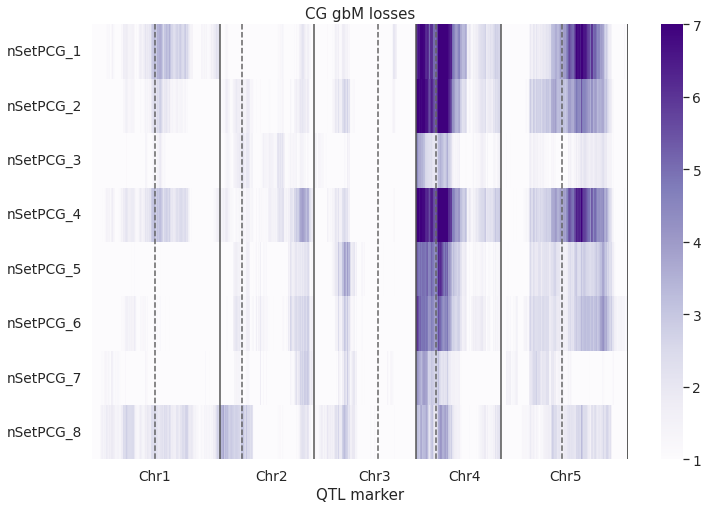

In [23]:
fig, axs = plt.subplots(figsize = (12,8))

plotting_along_genome.generate_heatmap_genomewide( qtl_maps_cls['dev_1'], plt_options = {"lims": (1, 7), "title": "CG gbM losses", "xlabel": "QTL marker", "ylabel": "", "cmap": "Purples","yticklabels": True  }, axs=axs )

plt.show()

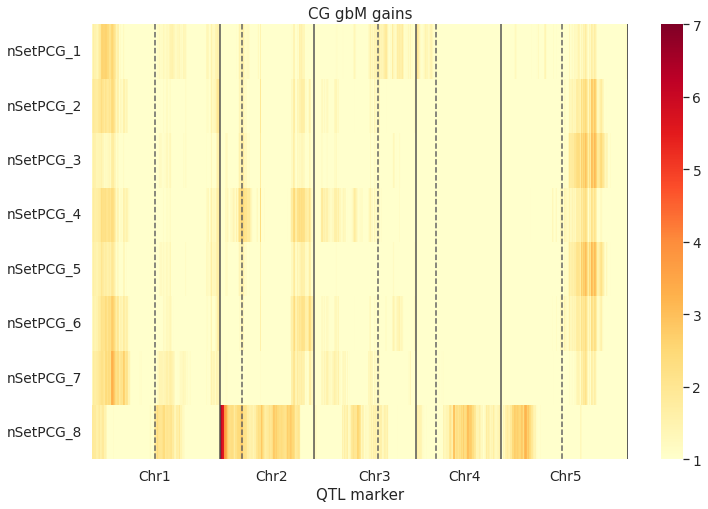

In [24]:
fig, axs = plt.subplots(figsize = (12,8))

plotting_along_genome.generate_heatmap_genomewide( qtl_maps_cls['dev_0'], plt_options = {"lims": (1, 7), "title": "CG gbM gains", "xlabel": "QTL marker", "ylabel": "", "cmap": "YlOrRd","yticklabels": True  }, axs = axs )

plt.show()

* 1: House keeping
* 2: Expressed with H2AZ and low CG
* 3: Intron less with H2AZ GB
* 4: Bivalent (active + repressive marks)
* 5: polycomb (PRC2) and PRC1
* 6: H2AZ with other repressive
* 7: PRC1 only and H2AZ
* 8: Genes with H2AW (heterochromatic)

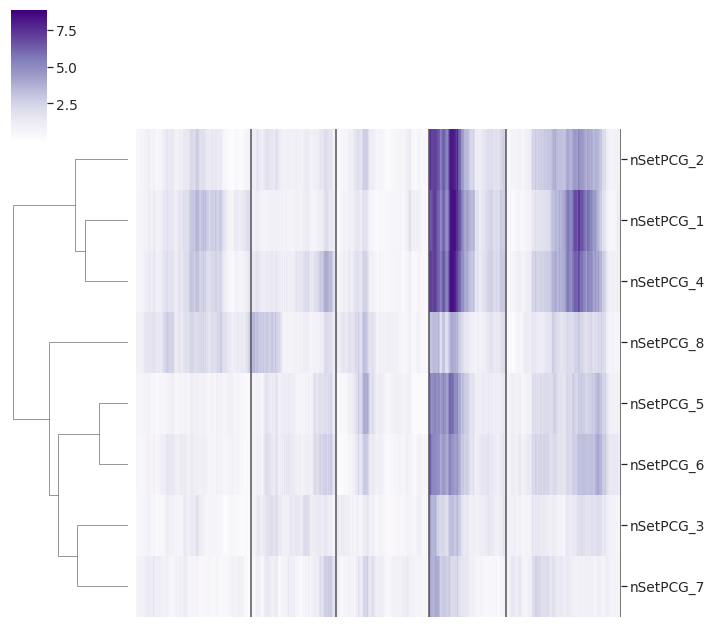

In [25]:
p = sns.clustermap(qtl_maps_cls['dev_1'], cmap = "Purples", col_cluster=False)
p.ax_heatmap.set_xticklabels([])
for ef_ind in np.searchsorted( qtl_maps_cls['dev_1'].columns.values, plotting_along_genome.chr_info['chr_ind_end'], "right" ):
    p.ax_heatmap.plot( (ef_ind, ef_ind), (0,8), '-', c = "#525252" )

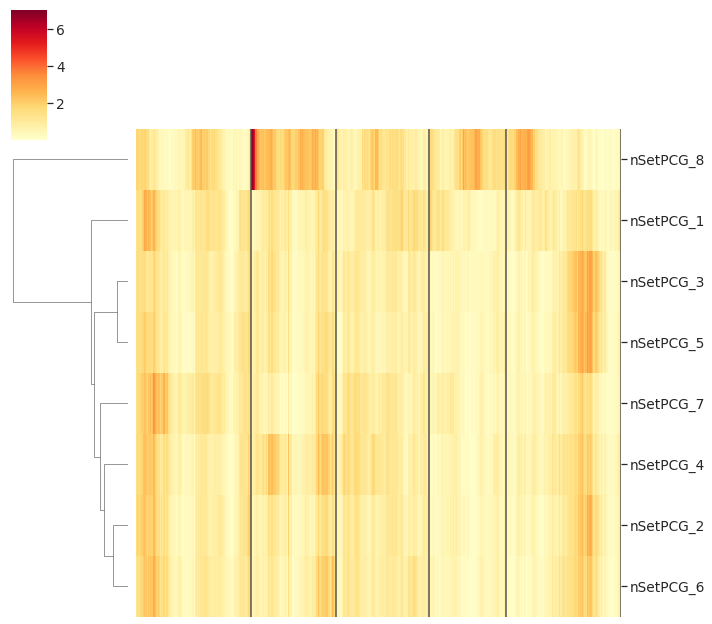

In [26]:
p = sns.clustermap(qtl_maps_cls['dev_0'], cmap = "YlOrRd", col_cluster=False, vmax = 7, method = "ward")
p.ax_heatmap.set_xticklabels([])
for ef_ind in np.searchsorted( qtl_maps_cls['dev_0'].columns.values, plotting_along_genome.chr_info['chr_ind_end'], "right" ):
    p.ax_heatmap.plot( (ef_ind, ef_ind), (0,8), '-', c = "#525252" )

# Mapping QTLs in reciprocal direction

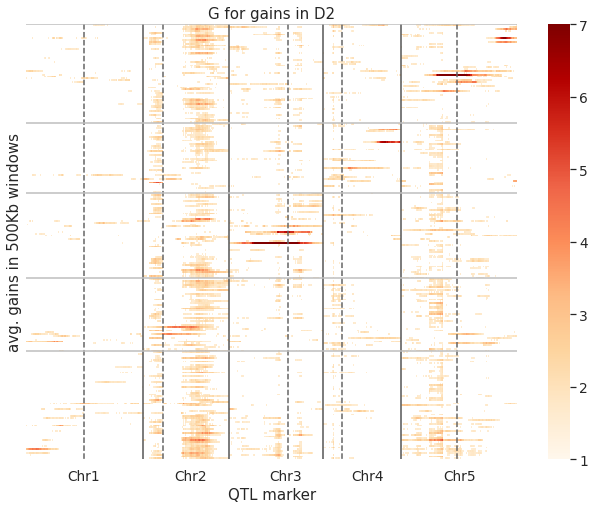

In [44]:
fig, axs = plt.subplots(figsize = (11,8))

ef_data = ns_genetic_map_d2.dev_0_f.copy()
ef_data[ef_data < 1.5] = np.nan

plotting_along_genome.generate_heatmap_genomewide(ef_data, plt_options = {"lims": (1, 7), "title": "G for gains in D2", "xlabel": "QTL marker", "ylabel": "avg. gains in 500Kb windows", "cmap": "OrRd"  }, axs=axs, annot=False)
for ef_chr in plotting_along_genome.chr_info.iterrows():
    axs.hlines(y = int(np.where(ns_genetic_map_d2.dev_0_f.index.str.startswith(ef_chr[1]['chr']))[0].min()), xmin = 0, xmax = ns_genetic_map_d2.dev_0_f.columns.max(), color = "#bdbdbd")


plt.show()

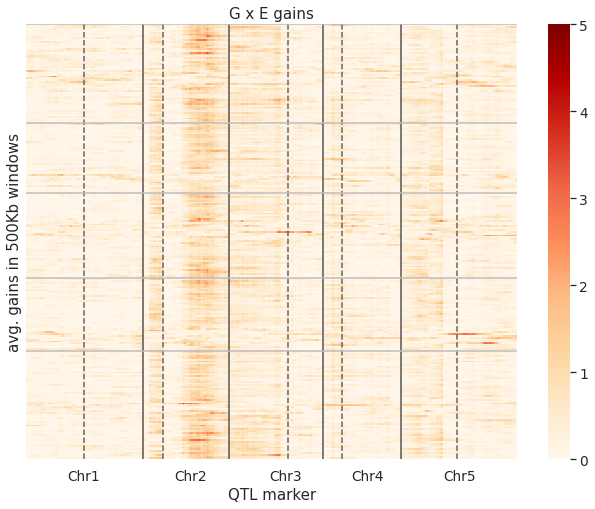

In [32]:
fig, axs = plt.subplots(figsize = (11,8))

plotting_along_genome.generate_heatmap_genomewide(ns_genetic_map_d2.dev_0_f - ns_genetic_map_d2.dev_0_a, plt_options = {"lims": (0, 5), "title": "G x E gains", "xlabel": "QTL marker", "ylabel": "avg. gains in 500Kb windows", "cmap": "OrRd"  }, axs=axs, annot=False)
for ef_chr in plotting_along_genome.chr_info.iterrows():
    axs.hlines(y = int(np.where(ns_genetic_map_d2.dev_0_f.index.str.startswith(ef_chr[1]['chr']))[0].min()), xmin = 0, xmax = ns_genetic_map_d2.dev_0_f.columns.max(), color = "#bdbdbd")


plt.show()

In [ ]:
"Chr2:11740264", "Chr5:8811039"

In [36]:
ef_t = ns_genetic_map_d2.markers_map.copy()
ef_t['sum_lod'] = ns_genetic_map_d2.dev_0_f.sum(0).values


ef_t[ef_t['sum_lod'].isin( ef_t.groupby("chr")['sum_lod'].max().values )]

,chr,start,end,genome_ix,sum_lod
0,,,,,
Chr1:30393389,Chr1,30393389,30393390,30393389,129.741049
Chr2:11740264,Chr2,11740264,11740265,42167935,485.399133
Chr3:10514935,Chr3,10514935,10514936,60640895,345.429220
Chr4:1600462,Chr4,1600462,1600463,75186252,343.074638
Chr5:8811039,Chr5,8811039,8811040,100981885,428.821710


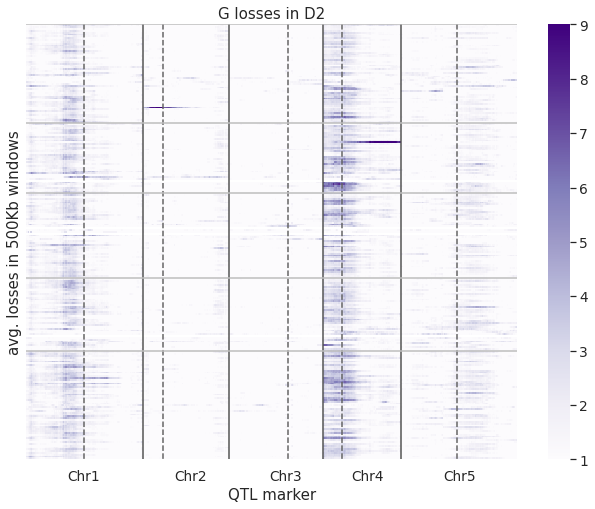

In [40]:
fig, axs = plt.subplots(figsize = (11,8))

plotting_along_genome.generate_heatmap_genomewide(ns_genetic_map_d2.dev_1_f, plt_options = {"lims": (1, 9), "title": "G losses in D2", "xlabel": "QTL marker", "ylabel": "avg. losses in 500Kb windows", "cmap": "Purples"  }, axs=axs, annot=False)
for ef_chr in plotting_along_genome.chr_info.iterrows():
    axs.hlines(y = int(np.where(ns_genetic_map_d2.dev_1_f.index.str.startswith(ef_chr[1]['chr']))[0].min()), xmin = 0, xmax = ns_genetic_map_d2.dev_1_f.columns.max(), color = "#bdbdbd")


plt.show()

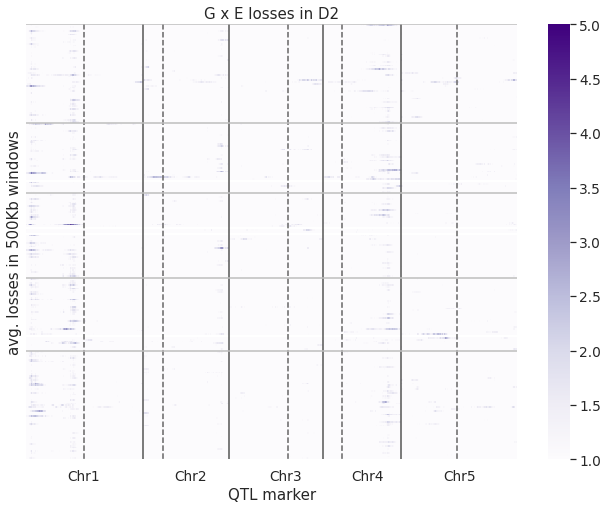

In [42]:
fig, axs = plt.subplots(figsize = (11,8))

plotting_along_genome.generate_heatmap_genomewide(ns_genetic_map_d2.dev_1_f - ns_genetic_map_d2.dev_1_a, plt_options = {"lims": (1, 5), "title": "G x E losses in D2", "xlabel": "QTL marker", "ylabel": "avg. losses in 500Kb windows", "cmap": "Purples"  }, axs=axs, annot=False)
for ef_chr in plotting_along_genome.chr_info.iterrows():
    axs.hlines(y = int(np.where(ns_genetic_map_d2.dev_1_f.index.str.startswith(ef_chr[1]['chr']))[0].min()), xmin = 0, xmax = ns_genetic_map_d2.dev_1_f.columns.max(), color = "#bdbdbd")


plt.show()

In [38]:
"Chr4:5365727", "Chr1:9931617"

('Chr4:5365727', 'Chr1:9931617')

In [35]:
ef_t = ns_genetic_map_d2.markers_map.copy()
ef_t['sum_lod'] = ns_genetic_map_d2.dev_1_f.sum(0).values


ef_t[ef_t['sum_lod'].isin( ef_t.groupby("chr")['sum_lod'].max().values )]

,chr,start,end,genome_ix,sum_lod
0,,,,,
Chr1:9931617,Chr1,9931617,9931618,9931617,656.491096
Chr2:17961332,Chr2,17961332,17961333,48389003,303.843254
Chr3:15576371,Chr3,15576371,15576372,65702331,227.055679
Chr4:5365727,Chr4,5365727,5365728,78951517,747.028270
Chr5:15585328,Chr5,15585328,15585329,107756174,397.727473


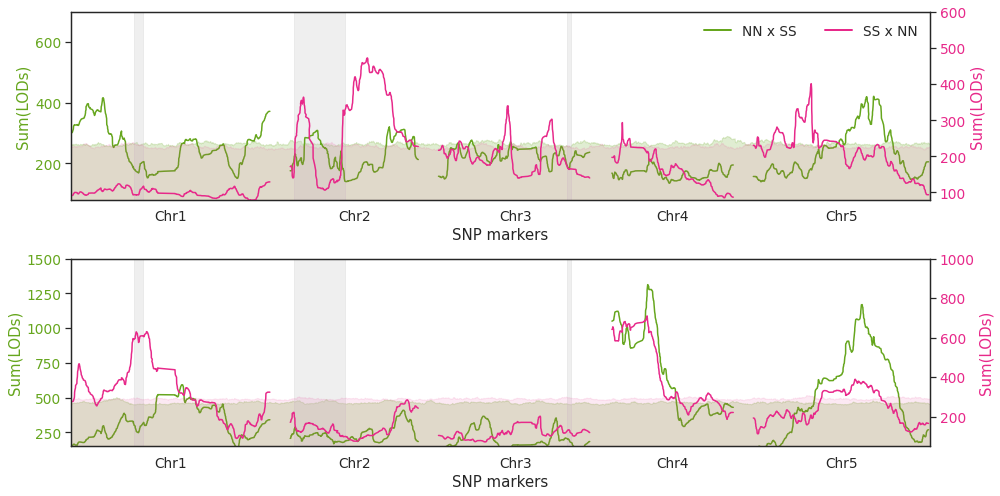

In [11]:
fig, axs = plt.subplots(figsize = (14, 7), nrows = 2)
fig_args = dict(
    col_d1 = cb.qualitative.Dark2_6.hex_colors[4],
    col_d2 = cb.qualitative.Dark2_6.hex_colors[3],
    ylim_d1 = (80,700),
    ylim_d2 = (80,600),
    nsmooth = 30,
    gap = 3000000
)
ax1 = axs.flat[0]
het_regions = pd.DataFrame(dict(chr = ['chr1','chr2','chr3'], start = [9600001,600001,19600001], end = [11000000,8400000,20200000]))
het_regions['start_ind'] = tair10.get_genomewide_inds(het_regions.iloc[:,0:2], gap = fig_args['gap']) 


plotting_along_genome.manhattan_plot( x_ind=ns_genetic_map.markers_map['genome_ix'].values, y_ind= ns_genetic_map.dev_0_f.sum(0).values, plt_options={"gap": fig_args['gap'], "line": True, "ylim": fig_args['ylim_d1'], "color": fig_args['col_d1'], "nsmooth": fig_args['nsmooth'], "label": "NN x SS"}, axs=ax1 )

permuted_lods = pyquant.utils.genome_rotations_2d( ns_genetic_map.dev_0_f.dropna().values, 1000 )
ax1.axes.fill_between(np.linspace(ax1.get_xlim()[0], ax1.get_xlim()[1], ns_genetic_map.dev_0_f.shape[1] ), 0, np.percentile(permuted_lods, 99.9999, 0), interpolate=True, color = fig_args['col_d1'], alpha = 0.2, rasterized = True )

ax1.set_ylabel('Sum(LODs)', color=fig_args['col_d1'])
ax1.tick_params(axis='y', labelcolor=fig_args['col_d1'])
ax1.set_xlabel('SNP markers')

recs = [ matplotlib.patches.Rectangle((ef[1]['start_ind'], fig_args['ylim_d1'][0]), ef[1]['end'] - ef[1]['start'], fig_args['ylim_d1'][1])   for ef in het_regions.iterrows()]
pc = matplotlib.collections.PatchCollection(recs, facecolor="#cccccc", alpha=0.3, edgecolor="#cccccc" )
ax1.add_collection(pc)

ax2 = ax1.twinx()

plotting_along_genome.manhattan_plot(x_ind=ns_genetic_map_d2.markers_map['genome_ix'].values, y_ind= ns_genetic_map_d2.dev_0_f.sum(0).values, plt_options = {"line": True, "color": fig_args['col_d2'], "ylim": fig_args['ylim_d2'], "gap": fig_args['gap'], "nsmooth": fig_args['nsmooth'], "label": "SS x NN"}, axs=ax2 )
ax2.set_ylabel('Sum(LODs)', color=fig_args['col_d2'])
ax2.tick_params(axis='y', labelcolor=fig_args['col_d2'])

permuted_lods = pyquant.utils.genome_rotations_2d( ns_genetic_map_d2.dev_0_f.dropna().values, 1000 )
ax2.axes.fill_between(np.linspace(ax2.get_xlim()[0], ax2.get_xlim()[1], ns_genetic_map_d2.dev_0_f.shape[1] ), 0, np.percentile(permuted_lods, 99.9999, 0), interpolate=True, color = fig_args['col_d2'], alpha = 0.1, rasterized = True )

ax1.legend(handles = [ax1.custum_legend[0][0], ax2.custum_legend[0][0]], labels = [ax1.custum_legend[1][0], ax2.custum_legend[1][0]], frameon = False, ncol = 2 )




fig_args = dict(
    col_d1 = cb.qualitative.Dark2_6.hex_colors[4],
    col_d2 = cb.qualitative.Dark2_6.hex_colors[3],
    ylim_d1 = (150,1500),
    ylim_d2 = (50,1000),
    nsmooth = 30,
    gap = 3000000
    
)
ax1 = axs.flat[1]
het_regions = pd.DataFrame(dict(chr = ['chr1','chr2','chr3'], start = [9600001,600001,19600001], end = [11000000,8400000,20200000]))
het_regions['start_ind'] = tair10.get_genomewide_inds(het_regions.iloc[:,0:2], gap = fig_args['gap'])


plotting_along_genome.manhattan_plot( x_ind=ns_genetic_map.markers_map['genome_ix'].values, y_ind= ns_genetic_map.dev_1_f.sum(0).values, plt_options={"gap": fig_args['gap'], "line": True, "ylim": fig_args['ylim_d1'], "color": fig_args['col_d1'], "nsmooth": fig_args['nsmooth'], "label": "NN x SS"}, axs=ax1, )
permuted_lods = pyquant.utils.genome_rotations_2d( ns_genetic_map.dev_1_f.dropna().values, 1000 )
ax1.axes.fill_between(np.linspace(ax1.get_xlim()[0], ax1.get_xlim()[1], ns_genetic_map.dev_1_f.shape[1] ), 0, np.percentile(permuted_lods, 99.99, 0), interpolate=True, color = fig_args['col_d1'], alpha = 0.2, rasterized = True )

ax1.set_ylabel('Sum(LODs)', color=fig_args['col_d1'])
ax1.tick_params(axis='y', labelcolor=fig_args['col_d1'])
ax1.set_xlabel('SNP markers')


recs = [ matplotlib.patches.Rectangle((ef[1]['start_ind'], fig_args['ylim_d1'][0]), ef[1]['end'] - ef[1]['start'], fig_args['ylim_d1'][1])   for ef in het_regions.iterrows()]
pc = matplotlib.collections.PatchCollection(recs, facecolor="#cccccc", alpha=0.3, edgecolor="#cccccc" )
ax1.add_collection(pc)


ax2 = ax1.twinx()

plotting_along_genome.manhattan_plot(x_ind=ns_genetic_map_d2.markers_map['genome_ix'].values, y_ind= ns_genetic_map_d2.dev_1_f.sum(0).values, plt_options = {"line": True, "color": fig_args['col_d2'], "ylim": fig_args['ylim_d2'], "gap": fig_args['gap'], "nsmooth": fig_args['nsmooth'], "label": "SS x NN"}, axs=ax2)
ax2.set_ylabel('Sum(LODs)', color=fig_args['col_d2'])
ax2.tick_params(axis='y', labelcolor=fig_args['col_d2'])


permuted_lods = pyquant.utils.genome_rotations_2d( ns_genetic_map_d2.dev_1_f.dropna().values, 1000 )
ax2.axes.fill_between(np.linspace(ax2.get_xlim()[0], ax2.get_xlim()[1], ns_genetic_map_d2.dev_1_f.shape[1] ), 0, np.percentile(permuted_lods, 99.99, 0), interpolate=True, color = fig_args['col_d2'], alpha = 0.1)


# fig.suptitle("QTLs mCG gains in reciprocal cross", fontsize='xx-large')
fig.tight_layout()
plt.savefig("qtl_mapping_d1_d2.pdf")
plt.show()

In [5]:
ns_genetic_map_d2.aov = pd.read_csv("cache_data/epimutation_rates_500Kb_rep2_boxcox_var_decomp_d2_lme.csv", index_col=0)

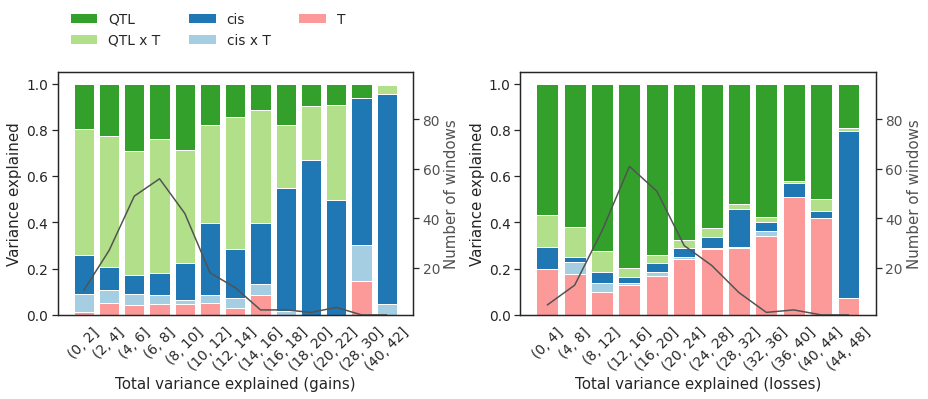

In [7]:
fig, axs = plt.subplots(figsize = (13, 6), ncols = 2, nrows = 1)

ef_data = ns_genetic_map_d2.aov.copy()
ef_data = ef_data.loc[:,pd.Series(ef_data.columns).str.startswith('gain_var').values]
ef_data.columns = pd.Series(ef_data.columns).str.replace("gain_var_", "")
ef_data  = ef_data.loc[:,ef_data.columns != 'resid']
ef_data['var_exp'] = ef_data.sum(1).values
ef_data = ef_data[(ef_data['var_exp'] > 0) & (ef_data['var_exp'] < 1)]
ef_data.loc[:,~ef_data.columns.str.startswith('var_exp')] = ef_data.loc[:, ~ef_data.columns.str.startswith( 'var_exp' ) ].apply(lambda x : x / ef_data['var_exp'], axis = 0)
ef_data['var_exp_fac'] = pd.cut(ef_data['var_exp'], np.arange(0, ef_data['var_exp'].max() + 0.02,  step = 0.02))

fig_options= dict(ax = axs.flat[0], data = ef_data.groupby('var_exp_fac').mean().dropna(), raw_data = ef_data )
fig_options['nind'] = np.arange(fig_options['data'].index.shape[0])

fig_options['ax'].set_xlabel("Total variance explained (gains)")
fig_options['ax'].set_ylabel("Variance explained")
# fig_options['ax'].set_ylim(0.001, fig_options['data'].index[-1].right + 0.05 )
fig_options['ax'].set_ylim(0, 1.05 )

fig_options['ax'].bar(fig_options['nind'], fig_options['data']['temp'], color = cb.qualitative.Paired_6.hex_colors[4], label = 'T')
ef_0 = fig_options['data']['temp'].copy()

fig_options['ax'].bar(fig_options['nind'], fig_options['data']['tempxcis'], bottom = ef_0, color = cb.qualitative.Paired_6.hex_colors[0], label = 'cis x T' )
ef_0 += fig_options['data']['tempxcis']

fig_options['ax'].bar(fig_options['nind'], fig_options['data']['cis'], bottom = ef_0, color = cb.qualitative.Paired_6.hex_colors[1], label = 'cis' )
ef_0 += fig_options['data']['cis']

fig_options['ax'].bar(fig_options['nind'], fig_options['data'].loc[:,['tempxqtlV1', 'tempxqtlV2']].sum(1).values, bottom = ef_0, color = cb.qualitative.Paired_6.hex_colors[2], label = "QTL x T" )
ef_0 += fig_options['data'].loc[:,['tempxqtlV1', 'tempxqtlV2']].sum(1).values


fig_options['ax'].bar(fig_options['nind'], fig_options['data'].loc[:,['qtl_V1', 'qtl_V2']].sum(1).values, bottom = ef_0, color = cb.qualitative.Paired_6.hex_colors[3], label = 'QTL' )
ef_0 += fig_options['data'].loc[:,['qtl_V1', 'qtl_V2']].sum(1).values

# fig_options['ax'].set_yticks(np.arange(0, fig_options['data'].index.shape[0], 1))

fig_options['ax'].set_xticks(np.arange(0, fig_options['data'].index.shape[0], 1))
fig_options['ax'].set_xticklabels( [ '(%.0f, %.0f]' % (ef.left * 100,ef.right * 100) for ef in fig_options['data'].index[np.arange(0, fig_options['data'].index.shape[0], 1)]], rotation=45 )


handles, labels = fig_options['ax'].get_legend_handles_labels()
fig_options['ax'].legend(handles[::-1], labels[::-1], loc='upper left', frameon = False, bbox_to_anchor=(0, 1.3), ncol = 3 )


ax2 = fig_options['ax'].twinx()
ax2.set_ylim(1, 99)
sns.lineplot(x = fig_options['nind'], y = fig_options['raw_data'].groupby('var_exp_fac').count().loc[ fig_options['data'].index, 'temp'].values, ax=ax2, color = "#525252" )
ax2.set_ylabel('Number of windows', color='#525252')
ax2.tick_params(axis='y', labelcolor="#525252")




fig_options= dict(ax = axs.flat[1])

ef_data = ns_genetic_map_d2.aov.copy()
ef_data = ef_data.loc[:,pd.Series(ef_data.columns).str.startswith('loss_var').values]
ef_data.columns = pd.Series(ef_data.columns).str.replace("loss_var_", "")
ef_data  = ef_data.loc[:,ef_data.columns != 'resid']
ef_data['var_exp'] = ef_data.sum(1).values
ef_data = ef_data[(ef_data['var_exp'] > 0) & (ef_data['var_exp'] < 1)]
ef_data.loc[:,~ef_data.columns.str.startswith('var_exp')] = ef_data.loc[:, ~ef_data.columns.str.startswith( 'var_exp' ) ].apply(lambda x : x / ef_data['var_exp'], axis = 0)
ef_data['var_exp_fac'] = pd.cut(ef_data['var_exp'], np.arange(0, ef_data['var_exp'].max() + 0.04,  step = 0.04))

fig_options= dict(ax = axs.flat[1], data = ef_data.groupby('var_exp_fac').mean().dropna(), raw_data = ef_data )
fig_options['nind'] = np.arange(fig_options['data'].index.shape[0])
fig_options['ax'].set_xlabel("Total variance explained (losses)")
fig_options['ax'].set_ylabel("Variance explained")
# fig_options['ax'].set_ylim(0.001, fig_options['data'].index[-1].right + 0.05 )
fig_options['ax'].set_ylim(0, 1.05)

fig_options['ax'].bar(fig_options['nind'], fig_options['data']['temp'], color = cb.qualitative.Paired_6.hex_colors[4] )
ef_0 = fig_options['data']['temp'].copy()

fig_options['ax'].bar(fig_options['nind'], fig_options['data']['tempxcis'], bottom = ef_0, color = cb.qualitative.Paired_6.hex_colors[0] )
ef_0 += fig_options['data']['tempxcis']

fig_options['ax'].bar(fig_options['nind'], fig_options['data']['cis'], bottom = ef_0, color = cb.qualitative.Paired_6.hex_colors[1] )
ef_0 += fig_options['data']['cis']

fig_options['ax'].bar(fig_options['nind'], fig_options['data'].loc[:,['tempxqtlV1', 'tempxqtlV2', 'tempxqtlV3' ]].sum(1).values, bottom = ef_0, color = cb.qualitative.Paired_6.hex_colors[2] )
ef_0 += fig_options['data'].loc[:,['tempxqtlV1', 'tempxqtlV2','tempxqtlV3']].sum(1).values


fig_options['ax'].bar(fig_options['nind'], fig_options['data'].loc[:,['qtl_V1', 'qtl_V2','qtl_V3']].sum(1).values, bottom = ef_0, color = cb.qualitative.Paired_6.hex_colors[3] )
ef_0 += fig_options['data'].loc[:,['qtl_V1', 'qtl_V2','qtl_V3']].sum(1).values

# fig_options['ax'].set_yticks(np.arange(0, fig_options['data'].index.shape[0], 1))

fig_options['ax'].set_xticks(np.arange(0, fig_options['data'].index.shape[0], 1))
fig_options['ax'].set_xticklabels( [ '(%.0f, %.0f]' % (ef.left * 100,ef.right * 100) for ef in fig_options['data'].index[np.arange(0, fig_options['data'].index.shape[0], 1)]], rotation=45 )


ax2 = fig_options['ax'].twinx()
ax2.set_ylim(1, 99)
sns.lineplot(x = fig_options['nind'], y = fig_options['raw_data'].groupby( 'var_exp_fac' ).count().loc[ fig_options['data'].index, 'temp'].values, ax=ax2, color = "#525252" )
ax2.set_ylabel('Number of windows', color='#525252')
ax2.tick_params(axis='y', labelcolor="#525252")

fig.tight_layout()


plt.savefig("var_comp_d2_lme.pdf")

plt.show()

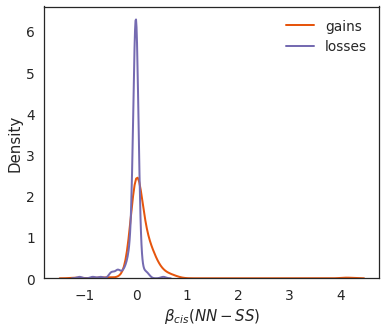

In [71]:
fig, axs = plt.subplots(figsize = (6, 5), nrows = 1)


sns.kdeplot( ns_genetic_map_d2.aov['gain_beta_cis'], ax = axs, color=cb.sequential.Oranges_5.hex_colors[3], label = "gains", lw = 2 )
sns.kdeplot( ns_genetic_map_d2.aov['loss_beta_cis'], ax = axs, color=cb.sequential.Purples_5.hex_colors[3], label = "losses", lw = 2 )

axs.set_xlabel( r'$\beta_{cis} (NN - SS) $' )

axs.legend(frameon = False)

# plt.savefig("cis_direction.pdf")

In [5]:
ns_genetic_map_d2.aov = pd.read_csv("cache_data/epimutation_rates_500Kb_rep2_all_lme.csv", index_col=0)

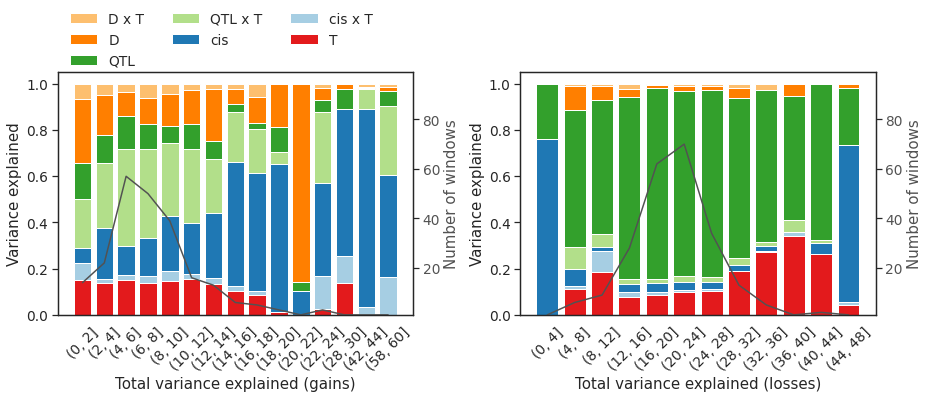

In [12]:
fig, axs = plt.subplots(figsize = (13, 6), ncols = 2, nrows = 1)

ef_data = ns_genetic_map_d2.aov.copy()
ef_data = ef_data.loc[:,pd.Series(ef_data.columns).str.startswith('gain_var').values]
ef_data.columns = pd.Series(ef_data.columns).str.replace("gain_var_", "")
ef_data  = ef_data.loc[:,ef_data.columns != 'resid']
ef_data['var_exp'] = ef_data.sum(1).values
ef_data = ef_data[(ef_data['var_exp'] > 0) & (ef_data['var_exp'] < 1)]
ef_data.loc[:,~ef_data.columns.str.startswith('var_exp')] = ef_data.loc[:, ~ef_data.columns.str.startswith( 'var_exp' ) ].apply(lambda x : x / ef_data['var_exp'], axis = 0)
ef_data['var_exp_fac'] = pd.cut(ef_data['var_exp'], np.arange(0, ef_data['var_exp'].max() + 0.02,  step = 0.02))

fig_options= dict(ax = axs.flat[0], data = ef_data.groupby('var_exp_fac').mean().dropna(), raw_data = ef_data )
fig_options['nind'] = np.arange(fig_options['data'].index.shape[0])

fig_options['ax'].set_xlabel("Total variance explained (gains)")
fig_options['ax'].set_ylabel("Variance explained")
# fig_options['ax'].set_ylim(0.001, fig_options['data'].index[-1].right + 0.05 )
fig_options['ax'].set_ylim(0, 1.05 )

fig_options['ax'].bar(fig_options['nind'], fig_options['data']['temp'], color = cb.qualitative.Paired_6.hex_colors[5], label = 'T')
ef_0 = fig_options['data']['temp'].copy()

fig_options['ax'].bar(fig_options['nind'], fig_options['data']['tempxcis'], bottom = ef_0, color = cb.qualitative.Paired_6.hex_colors[0], label = 'cis x T' )
ef_0 += fig_options['data']['tempxcis']

fig_options['ax'].bar(fig_options['nind'], fig_options['data']['cis'], bottom = ef_0, color = cb.qualitative.Paired_6.hex_colors[1], label = 'cis' )
ef_0 += fig_options['data']['cis']

fig_options['ax'].bar(fig_options['nind'], fig_options['data'].loc[:,['tempxqtlV1', 'tempxqtlV2']].sum(1).values, bottom = ef_0, color = cb.qualitative.Paired_6.hex_colors[2], label = "QTL x T" )
ef_0 += fig_options['data'].loc[:,['tempxqtlV1', 'tempxqtlV2']].sum(1).values


fig_options['ax'].bar(fig_options['nind'], fig_options['data'].loc[:,['qtl_V1', 'qtl_V2']].sum(1).values, bottom = ef_0, color = cb.qualitative.Paired_6.hex_colors[3], label = 'QTL' )
ef_0 += fig_options['data'].loc[:,['qtl_V1', 'qtl_V2']].sum(1).values


fig_options['ax'].bar(fig_options['nind'], fig_options['data'].loc[:,['direction']].sum(1).values, bottom = ef_0, color = cb.qualitative.Paired_8.hex_colors[7], label = "D" )
ef_0 += fig_options['data'].loc[:,['direction']].sum(1).values

fig_options['ax'].bar(fig_options['nind'], fig_options['data'].loc[:,['tempxdirection']].sum(1).values, bottom = ef_0, color = cb.qualitative.Paired_8.hex_colors[6], label = "D x T" )
ef_0 += fig_options['data'].loc[:,['tempxdirection']].sum(1).values

# fig_options['ax'].set_yticks(np.arange(0, fig_options['data'].index.shape[0], 1))

fig_options['ax'].set_xticks(np.arange(0, fig_options['data'].index.shape[0], 1))
fig_options['ax'].set_xticklabels( [ '(%.0f, %.0f]' % (ef.left * 100,ef.right * 100) for ef in fig_options['data'].index[np.arange(0, fig_options['data'].index.shape[0], 1)]], rotation=45 )


handles, labels = fig_options['ax'].get_legend_handles_labels()
fig_options['ax'].legend(handles[::-1], labels[::-1], loc='upper left', frameon = False, bbox_to_anchor=(0, 1.3), ncol = 3 )


ax2 = fig_options['ax'].twinx()
ax2.set_ylim(1, 99)
sns.lineplot(x = fig_options['nind'], y = fig_options['raw_data'].groupby('var_exp_fac').count().loc[ fig_options['data'].index, 'temp'].values, ax=ax2, color = "#525252" )
ax2.set_ylabel('Number of windows', color='#525252')
ax2.tick_params(axis='y', labelcolor="#525252")




fig_options= dict(ax = axs.flat[1])

ef_data = ns_genetic_map_d2.aov.copy()
ef_data = ef_data.loc[:,pd.Series(ef_data.columns).str.startswith('loss_var').values]
ef_data.columns = pd.Series(ef_data.columns).str.replace("loss_var_", "")
ef_data  = ef_data.loc[:,ef_data.columns != 'resid']
ef_data['var_exp'] = ef_data.sum(1).values
ef_data = ef_data[(ef_data['var_exp'] > 0) & (ef_data['var_exp'] < 1)]
ef_data.loc[:,~ef_data.columns.str.startswith('var_exp')] = ef_data.loc[:, ~ef_data.columns.str.startswith( 'var_exp' ) ].apply(lambda x : x / ef_data['var_exp'], axis = 0)
ef_data['var_exp_fac'] = pd.cut(ef_data['var_exp'], np.arange(0, ef_data['var_exp'].max() + 0.04,  step = 0.04))

fig_options= dict(ax = axs.flat[1], data = ef_data.groupby('var_exp_fac').mean().dropna(), raw_data = ef_data )
fig_options['nind'] = np.arange(fig_options['data'].index.shape[0])
fig_options['ax'].set_xlabel("Total variance explained (losses)")
fig_options['ax'].set_ylabel("Variance explained")
# fig_options['ax'].set_ylim(0.001, fig_options['data'].index[-1].right + 0.05 )
fig_options['ax'].set_ylim(0, 1.05)

fig_options['ax'].bar(fig_options['nind'], fig_options['data']['temp'], color = cb.qualitative.Paired_6.hex_colors[5] )
ef_0 = fig_options['data']['temp'].copy()

fig_options['ax'].bar(fig_options['nind'], fig_options['data']['tempxcis'], bottom = ef_0, color = cb.qualitative.Paired_6.hex_colors[0] )
ef_0 += fig_options['data']['tempxcis']

fig_options['ax'].bar(fig_options['nind'], fig_options['data']['cis'], bottom = ef_0, color = cb.qualitative.Paired_6.hex_colors[1] )
ef_0 += fig_options['data']['cis']

fig_options['ax'].bar(fig_options['nind'], fig_options['data'].loc[:,['tempxqtlV1', 'tempxqtlV2', 'tempxqtlV3' ]].sum(1).values, bottom = ef_0, color = cb.qualitative.Paired_6.hex_colors[2] )
ef_0 += fig_options['data'].loc[:,['tempxqtlV1', 'tempxqtlV2','tempxqtlV3']].sum(1).values


fig_options['ax'].bar(fig_options['nind'], fig_options['data'].loc[:,['qtl_V1', 'qtl_V2','qtl_V3']].sum(1).values, bottom = ef_0, color = cb.qualitative.Paired_6.hex_colors[3] )
ef_0 += fig_options['data'].loc[:,['qtl_V1', 'qtl_V2','qtl_V3']].sum(1).values

fig_options['ax'].bar(fig_options['nind'], fig_options['data'].loc[:,['direction']].sum(1).values, bottom = ef_0, color = cb.qualitative.Paired_8.hex_colors[7], label = "D" )
ef_0 += fig_options['data'].loc[:,['direction']].sum(1).values

fig_options['ax'].bar(fig_options['nind'], fig_options['data'].loc[:,['tempxdirection']].sum(1).values, bottom = ef_0, color = cb.qualitative.Paired_8.hex_colors[6], label = "D x T" )
ef_0 += fig_options['data'].loc[:,['tempxdirection']].sum(1).values

# fig_options['ax'].set_yticks(np.arange(0, fig_options['data'].index.shape[0], 1))

fig_options['ax'].set_xticks(np.arange(0, fig_options['data'].index.shape[0], 1))
fig_options['ax'].set_xticklabels( [ '(%.0f, %.0f]' % (ef.left * 100,ef.right * 100) for ef in fig_options['data'].index[np.arange(0, fig_options['data'].index.shape[0], 1)]], rotation=45 )


ax2 = fig_options['ax'].twinx()
ax2.set_ylim(1, 99)
sns.lineplot(x = fig_options['nind'], y = fig_options['raw_data'].groupby( 'var_exp_fac' ).count().loc[ fig_options['data'].index, 'temp'].values, ax=ax2, color = "#525252" )
ax2.set_ylabel('Number of windows', color='#525252')
ax2.tick_params(axis='y', labelcolor="#525252")

fig.tight_layout()


plt.savefig("var_comp_d2_lme.pdf")

plt.show()

# QTL mapping for all genes

* Model 1 
<!-- $$ y = \epsilon $$ -->

$$ y = G_i + \epsilon $$

<!-- (\#eq:null_cis) -->


* Model 2
$$ \hat{y} = G_{cis} + \epsilon $$

$$y - \hat{y} = G_i + \epsilon $$


<!-- 
$$y = G_{cis} + G_i + \epsilon $$ -->

In [2]:
class epiQTL(object):
    def __init__(self, qtl_map, gbm_phenos):
        self.qtl_map = qtl_map
        self.gbm_phenos = gbm_phenos
    
    def read_lods(self, qtl_peaks, model, gene_str, return_peak_ix = False):
        assert type(qtl_peaks) is qtl_maps.readQTLdata, "provide qtl_maps.readQTLdata"
        ef_gene_ix = np.where(qtl_peaks.gene_str == gene_str)[0][0]
        ef_lods = qtl_peaks.h5file[model][ef_gene_ix, ]
        if return_peak_ix:
            ef_lod_peak = qtl_maps.determine_peaks_given_lods(ef_lods, peak_prominence=1, qtl_min=2.5, n_smooth = 200)
            return((ef_lods, ef_lod_peak))
        return(ef_lods)

    def read_geno_phenos(self, gene_str, qtl_marker_ix = None):
        ef_phenos = self.gbm_phenos.get_meths_req_gene( req_gene_ix= self.gbm_phenos.get_filter_inds( gene_str ) )
        if type(gene_str) is str: #, "provide one gene"
            for ef_context in ['CG', 'CHG', 'CHH']:
                ef_phenos[ef_context] = ef_phenos[ef_context].T.reindex(self.qtl_map.columns).iloc[:,0]
            ef_phenos = pd.DataFrame(ef_phenos)
            if qtl_marker_ix is not None:
                ef_phenos.loc[:,'geno_marker'] = self.qtl_map.iloc[qtl_marker_ix, :].reindex( ef_phenos.index )
        else:
            assert type(gene_str) is pd.Series, "provide a pandas series"
            
            for ef_context in ['CG', 'CHG', 'CHH']:
                ef_phenos[ef_context] = ef_phenos[ef_context].loc[:,self.qtl_map.columns].T.describe( )#.iloc[:,0]
                ef_phenos[ef_context] = ef_phenos[ef_context].T.set_index( gene_str.values )                
#             ef_phenos = pd.DataFrame(ef_phenos)
        return(ef_phenos)

In [4]:
%%time

proj_dir = "/groups/nordborg/projects/epiclines/005.manu.crosses.2020/004.design_resolved/"


# qtl_map = pygparser.readRqtlMaps( {"d1": proj_dir + "/snps_bcftools/genotyper_final_D1.csv", "d2": proj_dir + "/snps_bcftools/genotyper_final_D2.csv"}, marker_id_startswith = "Chr" )
# qtl_map.write_h5_qtl_scores("d1", proj_dir + "/qtl_maps.aragenes.d1/aragenes.lods.csv", proj_dir + "/qtl_maps.aragenes.d1/aragenes.lods.hdf5", csv_sep = "\t" )
# write_h5_qtls(proj_dir + "/qtl_maps.aragenes.d1/aragenes.lods.csv", tair10, marker_names, proj_dir + "/qtl_maps.aragenes.d1/aragenes.lods.hdf5")
# write_h5_qtls(proj_dir + "/qtl_maps.aragenes.d2/aragenes.lods.csv", tair10, marker_names, proj_dir + "/qtl_maps.aragenes.d2/aragenes.lods.hdf5")
# write_h5_qtls(proj_dir + "/qtl_maps.aragenes.d1.t16/aragenes.lods.csv", tair10, marker_names, proj_dir + "/qtl_maps.aragenes.d1.t16/aragenes.lods.hdf5")
# write_h5_qtls(proj_dir + "/qtl_maps.aragenes.d1.t4/aragenes.lods.csv", tair10, marker_names, proj_dir + "/qtl_maps.aragenes.d1.t4/aragenes.lods.hdf5")


# geno_pheno = epiQTL( qtl_map, the1001g.ContextsHDF51001gTable( proj_dir + "/wmas_cds_genes/" ) )


qtls_genes = {}
qtls_genes['d1'] = qtl_maps.readQTLresults(proj_dir + "/snps_bcftools/genotyper_final_D1.csv", proj_dir + "/qtl_maps.aragenes.d1/aragenes.lods.hdf5", tair10 )
qtls_genes['d2'] = qtl_maps.readQTLresults(proj_dir + "/snps_bcftools/genotyper_final_D2.csv", proj_dir + "/qtl_maps.aragenes.d2/aragenes.lods.hdf5", tair10 )
qtls_genes['d1.t16'] = qtl_maps.readQTLresults(proj_dir + "/snps_bcftools/genotyper_final_D1.csv", proj_dir + "/qtl_maps.aragenes.d1.t16/aragenes.lods.hdf5", tair10 )
qtls_genes['d1.t4'] = qtl_maps.readQTLresults(proj_dir + "/snps_bcftools/genotyper_final_D1.csv", proj_dir + "/qtl_maps.aragenes.d1.t4/aragenes.lods.hdf5", tair10 )


genes_with_onlygbm = pd.read_csv( "cache_data/araport.genes.onlygbM_crosses.csv", index_col = 0 )

CPU times: user 1.25 s, sys: 90.4 ms, total: 1.34 s
Wall time: 1.35 s


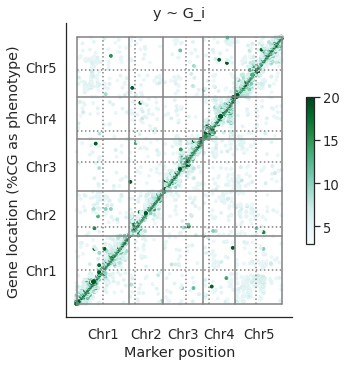

In [9]:
qtls_genes['peaks.d1.g'] = qtls_genes['d1'].get_peaks( "g", qtls_genes['d1'].gene_str.index.values, qtl_min=3, qtl_max=20, nprocs = 16)

p = pygplot.plt_gwas_peaks_matrix(x_ind=qtls_genes['peaks.d1.g']['genome_marker_ind'].values, y_ind=qtls_genes['peaks.d1.g']['genome_gene_ind'].values, peak_heights=qtls_genes['peaks.d1.g']['lod'], tair10=tair10, legend_scale=(3, 20))

# # #p.fig.suptitle("6191x6046")
p.ax_joint.set_xlabel("Marker position")
p.ax_joint.set_ylabel("Gene location (%CG as phenotype)")


plt.title("y ~ G_i")
plt.tight_layout()
# plt.savefig("cache_data/qtl.genes.cg.g.pdf", bbox_inches='tight')
plt.show()

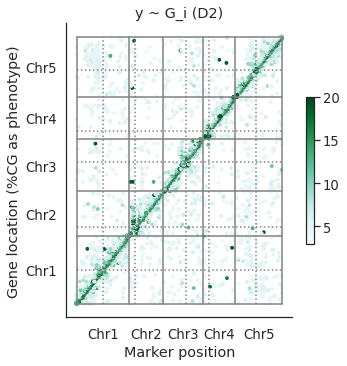

In [50]:
qtls_genes['peaks.d2.g'] = qtls_genes['d2'].get_peaks( "g", qtls_genes['d2'].gene_str.index.values, qtl_min=3, qtl_max = 20, nprocs = 16)

p = pygplot.plt_gwas_peaks_matrix(x_ind=qtls_genes['peaks.d2.g']['genome_marker_ind'].values, y_ind=qtls_genes['peaks.d2.g']['genome_gene_ind'].values, tair10=tair10, peak_heights=qtls_genes['peaks.d2.g']['lod'].values, legend_scale=(3, 20), hist_color="#252525")

# # #p.fig.suptitle("6191x6046")
p.ax_joint.set_xlabel("Marker position")
p.ax_joint.set_ylabel("Gene location (%CG as phenotype)")


plt.title("y ~ G_i (D2)")
plt.tight_layout()
# plt.savefig("cache_data/qtl.genes.cg.g.png", bbox_inches='tight', dpi=400)
plt.show()

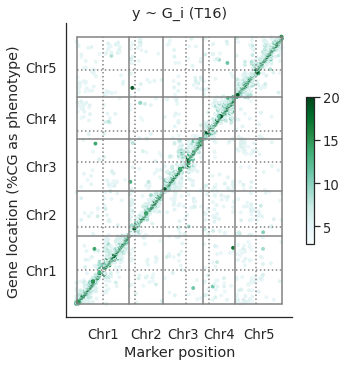

In [8]:
qtls_genes['peaks.d1.t16.g'] = qtls_genes['d1.t16'].get_peaks( "g", qtls_genes['d1.t16'].gene_str.index.values, qtl_min=3, qtl_max = 20, nprocs = 16)

p = pygplot.plt_gwas_peaks_matrix(x_ind=qtls_genes['peaks.d1.t16.g']['genome_marker_ind'].values, y_ind=qtls_genes['peaks.d1.t16.g']['genome_gene_ind'].values, tair10=tair10, peak_heights = qtls_genes['peaks.d1.t16.g']['lod'].values, legend_scale=(3, 20), hist_color="#252525")

# # #p.fig.suptitle("6191x6046")
p.ax_joint.set_xlabel("Marker position")
p.ax_joint.set_ylabel("Gene location (%CG as phenotype)")


plt.title("y ~ G_i (T16)")
plt.tight_layout()
# plt.savefig("cache_data/qtl.genes.cg.g.png", bbox_inches='tight', dpi=400)
plt.show()

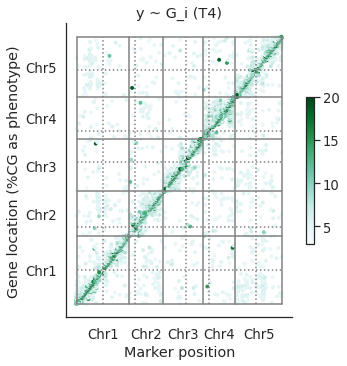

In [10]:
qtls_genes['peaks.d1.t4.g'] = qtls_genes['d1.t4'].get_peaks( "g", qtls_genes['d1.t4'].gene_str.index.values, qtl_min=3, qtl_max=20, nprocs = 16)

p = pygplot.plt_gwas_peaks_matrix(x_ind=qtls_genes['peaks.d1.t4.g']['genome_marker_ind'].values, y_ind=qtls_genes['peaks.d1.t4.g']['genome_gene_ind'].values, tair10=tair10, peak_heights=qtls_genes['peaks.d1.t4.g']['lod'], legend_scale=(3, 20), hist_color="#252525")

# # #p.fig.suptitle("6191x6046")
p.ax_joint.set_xlabel("Marker position")
p.ax_joint.set_ylabel("Gene location (%CG as phenotype)")


plt.title("y ~ G_i (T4)")
plt.tight_layout()
# plt.savefig("cache_data/qtl.genes.cg.g.png", bbox_inches='tight', dpi=400)
plt.show()

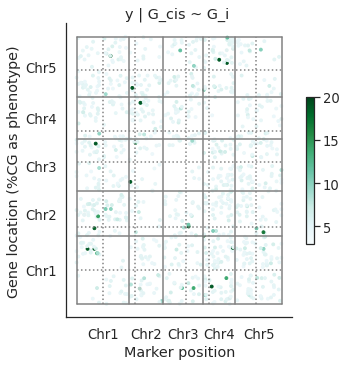

In [72]:
qtls_genes['peaks.d1.cis_given'] = qtls_genes['d1'].get_peaks( "cis_given", qtls_genes['d1'].gene_str.index.values, qtl_min=3, qtl_max = 20, nprocs = 16)

p = pygplot.plt_gwas_peaks_matrix(x_ind=qtls_genes['peaks.d1.cis_given']['genome_marker_ind'].values, y_ind=qtls_genes['peaks.d1.cis_given']['genome_gene_ind'].values, tair10 = tair10, peak_heights = qtls_genes['peaks.d1.cis_given']['lod'].values, legend_scale = (3, 20), hist_color="#252525")

# p.fig.suptitle("6191x6046")
p.ax_joint.set_xlabel("Marker position")
p.ax_joint.set_ylabel("Gene location (%CG as phenotype)")


plt.title("y | G_cis ~ G_i ")
plt.tight_layout()
plt.savefig("cache_data/qtl.genes.cg.g_cisgiven.png", bbox_inches='tight', dpi=400)
plt.show()

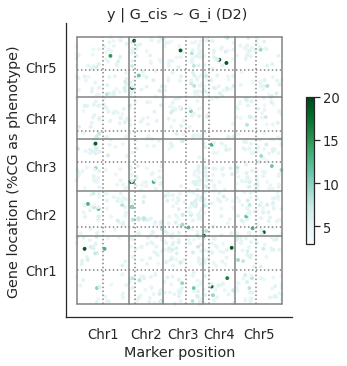

In [73]:
qtls_genes['peaks.d2.cis_given'] = qtls_genes['d2'].get_peaks( "cis_given", qtls_genes['d2'].gene_str.index.values, qtl_min=3, qtl_max = 20, nprocs = 16)

p = pygplot.plt_gwas_peaks_matrix(x_ind=qtls_genes['peaks.d2.cis_given']['genome_marker_ind'].values, y_ind=qtls_genes['peaks.d2.cis_given']['genome_gene_ind'].values, tair10=tair10, peak_heights=qtls_genes['peaks.d2.cis_given']['lod'].values, legend_scale=(3, 20), hist_color="#252525")

# p.fig.suptitle("6191x6046")
p.ax_joint.set_xlabel("Marker position")
p.ax_joint.set_ylabel("Gene location (%CG as phenotype)")


plt.title("y | G_cis ~ G_i (D2) ")
plt.tight_layout()
# plt.savefig("cache_data/qtl.genes.cg.g_cisgiven.png", bbox_inches='tight', dpi=400)
plt.show()

In [5]:
qtls_genes['peaks.gxe'] = qtls_genes['d1'].calculate_gxe(g_null="g", g_add="gpluse", g_int="gxe")

qtls_genes['peaks.gxe.long'] = qtl_maps.determine_peaks_from_wide_matrix_of_lods( qtls_genes['peaks.gxe']['int'], qtl_min = 3, qtl_max = None, n_smooth = 250 )
qtls_genes['peaks.gxe.long']['genome_gene_ind'] = (pd.Series(qtls_genes['d1'].gene_genome_ind, index = qtls_genes['d1'].gene_str).loc[ qtls_genes['peaks.gxe.long']['gene_str'].values ]).values

/users/rahul.pisupati/.conda/envs/pypower_quant/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


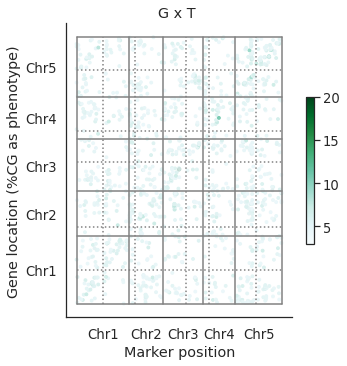

In [7]:
p = pygplot.plt_gwas_peaks_matrix(x_ind=qtls_genes['peaks.gxe.long']['genome_marker_ind'].values, y_ind=qtls_genes['peaks.gxe.long']['genome_gene_ind'].values, tair10=tair10, peak_heights=qtls_genes['peaks.gxe.long']['lod'].values, legend_scale=(3, 20), hist_color="#252525")

# # p.fig.suptitle("6191x6046")
p.ax_joint.set_xlabel("Marker position")
p.ax_joint.set_ylabel("Gene location (%CG as phenotype)")


plt.title("G x T ")
plt.tight_layout()
# plt.savefig("cache_data/qtl.genes.cg.g_cisgiven.png", bbox_inches='tight', dpi=400)
plt.show()

## Split the genes into categories and plot the Average QTLs

In [5]:
gene_set = pd.read_csv( "cache_data/genes.with.env.effect.csv" )

gene_set_str = tair10.genes.set_index( 3 ).loc[ gene_set.iloc[:,0] ]
gene_set_str = gene_set_str.iloc[:,0] + "," + gene_set_str.iloc[:,1].astype(str) + "," + gene_set_str.iloc[:,2].astype(str)
gene_set['gene_str'] = gene_set_str.values

qtl_gene_set = {}
qtl_gene_set['genes_CisNoTemp'] = gene_set.set_index( "gene_str" ).groupby('effs').groups['Cis_NoTemp'].values
qtl_gene_set['genes_NoCisNoTemp'] = gene_set.set_index( "gene_str" ).groupby('effs').groups['NoCis_NoTemp'].values

clines_1001meth = pd.read_csv( "cache_data/genes.with.gbm.cline.1001g.csv", header = None, names = ["gene_str", "corr"] )
clines_1001meth['araport.id'] = tair10.genes.set_index( "gene_str" ).loc[clines_1001meth['gene_str'].values][3].values
clines_1001meth['effs'] = gene_set.set_index( "araport.id" ).reindex(clines_1001meth['araport.id'].values)['effs'].values

In [56]:
import statsmodels.api as sm
from statsmodels.formula.api import ols

In [57]:
model = ols('corr ~ C(effs)', data=clines_1001meth).fit()
anova_table = sm.stats.anova_lm(model, typ=2)

In [58]:
anova_table

,sum_sq,df,F,PR(>F)
C(effs),0.07071,3.0,6.781648,0.000146
Residual,25.80270,7424.0,NaN,NaN


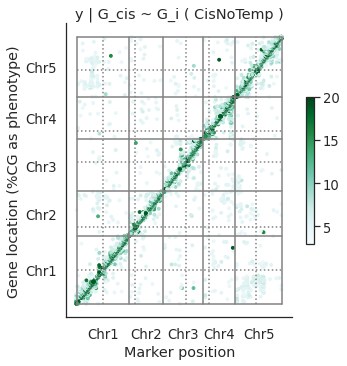

In [86]:
qtl_gene_set['d1.cis_notemp'] = qtls_genes['d1'].get_peaks( "g", qtl_gene_set['genes_CisNoTemp'], qtl_min=3, qtl_max=20, nprocs = 16)

p = pygplot.plt_gwas_peaks_matrix(x_ind=qtl_gene_set['d1.cis_notemp']['genome_marker_ind'].values, y_ind=qtl_gene_set['d1.cis_notemp']['genome_gene_ind'].values, tair10=tair10, peak_heights=qtl_gene_set['d1.cis_notemp']['lod'].values, legend_scale=(3, 20))

# p.fig.suptitle("6191x6046")
p.ax_joint.set_xlabel("Marker position")
p.ax_joint.set_ylabel("Gene location (%CG as phenotype)")


plt.title("y | G_cis ~ G_i ( CisNoTemp )")
plt.tight_layout()
# plt.savefig("cache_data/qtl.genes.cg.g_cisgiven.png", bbox_inches='tight', dpi=400)
plt.show()

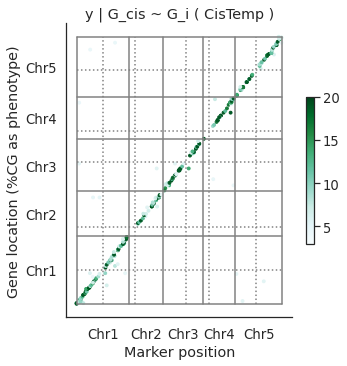

In [8]:
qtl_gene_set['d1.cis_temp'] = qtls_genes['d1'].get_peaks( "g", gene_set.set_index( "gene_str" ).groupby('effs').groups['Cis_Temp'].values, qtl_min=3, qtl_max=20, nprocs = 16)

p = pygplot.plt_gwas_peaks_matrix(x_ind=qtl_gene_set['d1.cis_temp']['genome_marker_ind'].values, y_ind=qtl_gene_set['d1.cis_temp']['genome_gene_ind'].values, tair10=tair10, legend_scale = [3, 20], peak_heights = qtl_gene_set['d1.cis_temp']['lod'], hist_color="#252525")

p.ax_joint.set_xlabel("Marker position")
p.ax_joint.set_ylabel("Gene location (%CG as phenotype)")

plt.title("y | G_cis ~ G_i ( CisTemp )")
plt.tight_layout()
# plt.savefig("cache_data/qtl.genes.cg.g_cisgiven.png", bbox_inches='tight', dpi=400)
plt.show()

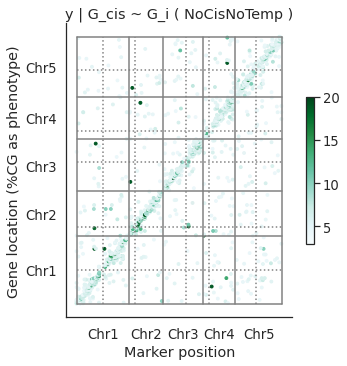

In [90]:
qtl_gene_set['d1.nocis_notemp'] = qtls_genes['d1'].get_peaks( "g", qtl_gene_set['genes_NoCisNoTemp'], qtl_min=3, qtl_max=20, nprocs = 16)

p = pygplot.plt_gwas_peaks_matrix(x_ind=qtl_gene_set['d1.nocis_notemp']['genome_marker_ind'].values, y_ind=qtl_gene_set['d1.nocis_notemp']['genome_gene_ind'].values, tair10=tair10, peak_heights = qtl_gene_set['d1.nocis_notemp']['lod'].values, legend_scale=(3, 20) )

# p.fig.suptitle("6191x6046")
p.ax_joint.set_xlabel("Marker position")
p.ax_joint.set_ylabel("Gene location (%CG as phenotype)")


plt.title("y | G_cis ~ G_i ( NoCisNoTemp )")
plt.tight_layout()
# plt.savefig("cache_data/qtl.genes.cg.g_cisgiven.png", bbox_inches='tight', dpi=400)
plt.show()

In [102]:
trans_matrix = qtls_genes['d1'].get_matrix("pval_nocis", qtls_genes['d1'].gene_str)

req_gene_str = trans_matrix.index.values
# req_gene_str = np.random.choice( trans_matrix.index.values, 3000 )
# req_gene_str = gene_set['Cis_NoTemp'].values
# req_gene_str = gene_set['Cis_Temp'].values
# req_gene_str = gene_set['NoCis_Temp'].values
# req_gene_str = gene_set['NoCis_NoTemp'].values

# req_gene_str = clines_1001meth.iloc[:,0].values

# req_gene_str = req_gene_str[pd.Series(req_gene_str).str.contains( "Chr[1235]", regex=True ).values]

req_gene_lods = trans_matrix.reindex(req_gene_str).dropna(how = "all")

req_gene_lods = -np.log10(req_gene_lods)
req_gene_lods[~np.isfinite(req_gene_lods)] = 0

print( "number of genes: %s" % req_gene_lods.shape[0] )

/users/rahul.pisupati/.conda/envs/pypower_quant/lib/python3.7/site-packages/ipykernel_launcher.py:16: RuntimeWarning: divide by zero encountered in log10
  app.launch_new_instance()


number of genes: 19643


In [103]:
permuted_lod_sum = qtl_maps.genome_rotations_2d( req_gene_lods.values, 500)
permuted_lod_sum = pd.DataFrame(permuted_lod_sum).describe()

np_ci = np.vectorize(sp.stats.t.interval, excluded="alpha")  

permuted_lod_sum.loc['ci_low'], permuted_lod_sum.loc['ci_high'] = np_ci(1 - (0.0001 / 3300), 999, loc = permuted_lod_sum.loc['mean'].values, scale = permuted_lod_sum.loc['std'].values)

In [104]:
trans_modifier_peaks = qtl_maps.determine_peaks_given_lods( req_gene_lods.sum(axis = 0).values, qtl_min = 200, peak_prominence = 1, n_smooth=300 )


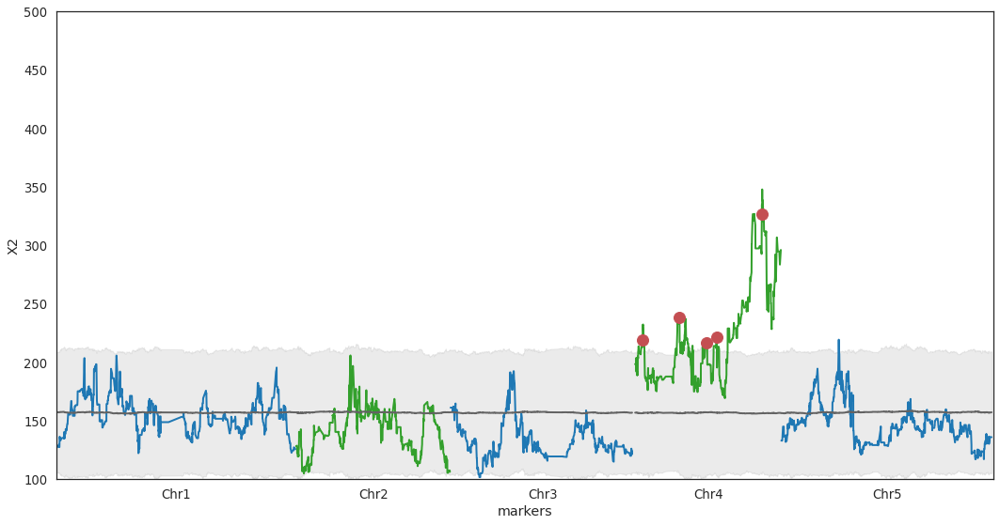

In [105]:
plt_lim = (int(permuted_lod_sum.loc['std'].mean()) * 20)

p1 = pygplot.generate_manhattanplot( trans_matrix.columns.values, req_gene_lods.sum(axis = 0).values, tair10, line=True, linewidth=2.0, gap = 0)

# permuted_lod_sum.loc["ci_low",:].values
p1.axes.fill_between(  trans_matrix.columns.values, permuted_lod_sum.loc['ci_low'].values, permuted_lod_sum.loc["ci_high",:].values, interpolate=True, color = "#bdbdbd", alpha = 0.3 )
# p3 = pygplot.generate_manhattanplot( trans_matrix.columns.values, permuted_lod_sum.loc["ci_low",:].values, tair10, line=True, linewidth=2.0, gap = 2000000, plt_color = "#bdbdbd")
p2 = pygplot.generate_manhattanplot( trans_matrix.columns.values, permuted_lod_sum.loc["mean",:].values, tair10, line=True, linewidth=2.0, gap = 0, plt_color = "#636363")
# p3 = pygplot.generate_manhattanplot( trans_matrix.columns.values, permuted_lod_sum.loc["ci_high",:].values, tair10, line=True, linewidth=2.0, gap = 2000000, plt_color = "#bdbdbd")

plt.plot(trans_matrix.columns.values[trans_modifier_peaks], req_gene_lods.sum(axis = 0).values[trans_modifier_peaks], "ro", markersize=12 )



# plt.plot( (19645236, 19645236), (60, 300) )
# plt.plot( (0, 1000000000), (7584, 7584), 'r--' )
plt.ylim((100, 500))
# plt.ylim((int(permuted_lod_sum.loc["ci_low",:].min()) - 20, int(permuted_lod_sum.loc["max",:].max()) + plt_lim))
plt.ylabel( "X2" )
plt.tight_layout()

plt.show()

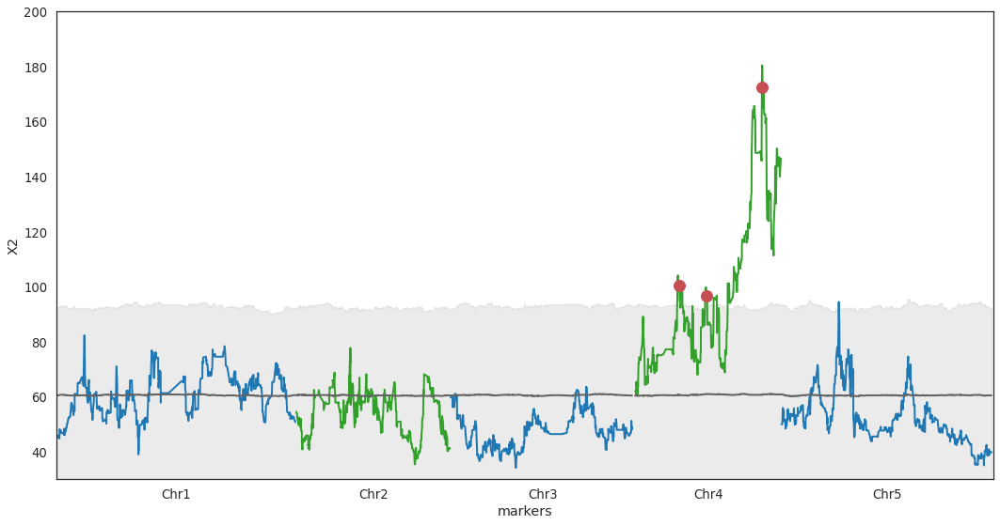

In [76]:
plt_lim = (int(permuted_lod_sum.loc['std'].mean()) * 20)

p1 = pygplot.generate_manhattanplot( trans_matrix.columns.values, req_gene_lods.sum(axis = 0).values, tair10, line=True, linewidth=2.0, gap = 0)

# permuted_lod_sum.loc["ci_low",:].values
p1.axes.fill_between(  trans_matrix.columns.values, permuted_lod_sum.loc['ci_low'].values, permuted_lod_sum.loc["ci_high",:].values, interpolate=True, color = "#bdbdbd", alpha = 0.3 )
# p3 = pygplot.generate_manhattanplot( trans_matrix.columns.values, permuted_lod_sum.loc["ci_low",:].values, tair10, line=True, linewidth=2.0, gap = 2000000, plt_color = "#bdbdbd")
p2 = pygplot.generate_manhattanplot( trans_matrix.columns.values, permuted_lod_sum.loc["mean",:].values, tair10, line=True, linewidth=2.0, gap = 0, plt_color = "#636363")
# p3 = pygplot.generate_manhattanplot( trans_matrix.columns.values, permuted_lod_sum.loc["ci_high",:].values, tair10, line=True, linewidth=2.0, gap = 2000000, plt_color = "#bdbdbd")

plt.plot(trans_matrix.columns.values[trans_modifier_peaks], req_gene_lods.sum(axis = 0).values[trans_modifier_peaks], "ro", markersize=12 )



# plt.plot( (19645236, 19645236), (60, 300) )
# plt.plot( (0, 1000000000), (7584, 7584), 'r--' )
plt.ylim((30, 200))
# plt.ylim((int(permuted_lod_sum.loc["ci_low",:].min()) - 20, int(permuted_lod_sum.loc["max",:].max()) + plt_lim))
plt.ylabel( "X2" )
plt.tight_layout()

plt.show()

In [94]:
qtls_genes['d1'].markers.iloc[trans_modifier_peaks,:]

,chr,pos,genome_ix
2034,Chr4,938918,74524708
2150,Chr4,5615247,79201037
2284,Chr4,9017043,82602833
2318,Chr4,10362298,83948088
2451,Chr4,16112553,89698343


## Check for gene duplicates in the parents


Here, I did NCBI blast of gene sequence (extracted from TAIR) to the pacbio genomes for the parents.

In [3]:
req_peaks = qtls_genes['d1'].get_peaks( "cis_given", genes_with_onlygbm.index.values, qtl_min=3, qtl_max=20, nprocs = 16)
# req_peaks = qtls_genes['d1'].get_peaks( "g", qtls_genes['d1'].gene_str, qtl_min=3, qtl_max=20, nprocs = 16)

req_peaks['araportid'] = tair10.genes.set_index("gene_str").loc[req_peaks['gene_str'], 3].values
req_peaks['marker_chr'] =  tair10.get_genomic_position_from_ind( req_peaks['genome_marker_ind'].values )['chr'].values

proj_dir = '/groups/nordborg/projects/epiclines/005.manu.crosses.2020/006.mapping_to_pacbio/004.blast_to_pacbios/'

gene_blasts = {}
gene_blasts['tair'] = pd.read_csv( proj_dir + "/blast_araport_genes/query_TAIR10_wholeGenome.bed", sep = "\t" )
gene_blasts['p6046'] = pd.read_csv( proj_dir + "/blast_araport_genes/query_6046.bed", sep = "\t" )
gene_blasts['p6191'] = pd.read_csv( proj_dir + "/blast_araport_genes/query_6191.bed", sep = "\t" )


gene_blasts['gene_counts'] = pd.DataFrame( index = tair10.genes.iloc[:,3].values )
for ef in ['tair', 'p6046', 'p6191']:
    gene_blasts[ef]['sub_len'] = (gene_blasts[ef]['query_end'] - gene_blasts[ef]['query_start'] + 1) 
    gene_blasts[ef]['full_copy'] = gene_blasts[ef]['sub_len'] / tair10.genes.set_index(3).reindex( gene_blasts[ef]['query_id'] )['gene_len'].values
    gene_blasts['gene_counts'][ef] = gene_blasts[ef].loc[gene_blasts[ef]['full_copy'] > 0.95].groupby( "query_id" ).count()['query_acc']
    
gene_blasts["gene_counts"] = gene_blasts["gene_counts"].dropna(how = "all")

te_blasts = {}
te_blasts['tair'] = pd.read_csv( proj_dir + "/blast_araport_tes/query_TAIR10_wholeGenome.bed", sep = "\t" )
te_blasts['p6046'] = pd.read_csv( proj_dir + "/blast_araport_tes/query_6046.bed", sep = "\t" )
te_blasts['p6191'] = pd.read_csv( proj_dir + "/blast_araport_tes/query_6191.bed", sep = "\t" )


req_peaks['counts_tair'] = gene_blasts["gene_counts"].loc[req_peaks['araportid'], "tair"].values
req_peaks['counts_p6046'] = gene_blasts["gene_counts"].loc[req_peaks['araportid'], "p6046"].values
req_peaks['counts_p6191'] = gene_blasts["gene_counts"].loc[req_peaks['araportid'], "p6191"].values

In [13]:
ef_gene = "AT3G54560" #"AT1G52740" #"AT2G38810"


display(gene_blasts['p6046'].loc[gene_blasts['p6046']['query_id'] == ef_gene].sort_values("full_copy", ascending = False))
display(gene_blasts['p6191'].loc[gene_blasts['p6191']['query_id'] == ef_gene].sort_values("full_copy", ascending = False))
display(gene_blasts['tair'].loc[gene_blasts['tair']['query_id'] == ef_gene].sort_values("full_copy", ascending = False))

,query_id,query_acc,subject_acc,evalue,query_start,query_end,sub_id,sub_start,sub_end,sub_len,full_copy
110453,AT3G54560,AT3G54560,6046_Chr3,0.000000e+00,1,1586,6046_Chr3,23473481,23475074,1586,1.000000
110454,AT3G54560,AT3G54560,6046_Chr2,2.800000e-63,1024,1326,6046_Chr2,18745690,18745388,303,0.191047


,query_id,query_acc,subject_acc,evalue,query_start,query_end,sub_id,sub_start,sub_end,sub_len,full_copy
136755,AT3G54560,AT3G54560,6191_Chr3,0.000000e+00,1,1586,6191_Chr3,33460236,33461829,1586,1.000000
136756,AT3G54560,AT3G54560,6191_Chr2,3.610000e-63,1024,1326,6191_Chr2,29182571,29182269,303,0.191047


,query_id,query_acc,subject_acc,evalue,query_start,query_end,sub_id,sub_start,sub_end,sub_len,full_copy
56767,AT3G54560,AT3G54560,Chr3,0.000000e+00,1,1586,Chr3,20196141,20197726,1586,1.000000
56768,AT3G54560,AT3G54560,Chr2,2.560000e-63,1024,1326,Chr2,16219746,16219444,303,0.191047


In [4]:
req_meths = geno_pheno.read_geno_phenos( pd.Series(req_peaks.sort_values("genome_gene_ind")['gene_str'].unique()) )

for ef_context in ['CG', 'CHG', 'CHH']:
    req_peaks['mean_' + ef_context] = req_meths[ef_context]['mean'].reindex( req_peaks['gene_str'] ).values

Make sure provided array is sorted based on chromosome position


In [4]:
tair10.genes.iloc[tair10.genes_str == "Chr1,21846902,21849405",:]

,0,1,2,3,4,5,6,gene_str,gene_len
4896,Chr1,21846902,21849405,AT1G59453,0,-,protein_coding,"Chr1,21846902,21849405",2503


,gene_str,qtl_num,marker_ix,genome_marker_ind,lod,genome_gene_ind,araportid,marker_chr,counts_tair,counts_p6046,counts_p6191,mean_CG,mean_CHG,mean_CHH


,query_id,query_acc,subject_acc,evalue,query_start,query_end,sub_id,sub_start,sub_end,sub_len,full_copy
47934,AT1G59453,AT1G59453,6046_Chr1,0.0,1,2503,6046_Chr1,22806692,22809192,2503,1.000000
47935,AT1G59453,AT1G59453,6046_Chr1,0.0,1,1879,6046_Chr1,6044618,6046608,1879,0.750699


,query_id,query_acc,subject_acc,evalue,query_start,query_end,sub_id,sub_start,sub_end,sub_len,full_copy
57812,AT1G59453,AT1G59453,6191_Chr1,0.0,1,2503,6191_Chr1,28864963,28867473,2503,1.000000
57813,AT1G59453,AT1G59453,6191_Chr1,0.0,1,1879,6191_Chr1,6014012,6016002,1879,0.750699


,query_id,query_acc,subject_acc,evalue,query_start,query_end,sub_id,sub_start,sub_end,sub_len,full_copy
24813,AT1G59453,AT1G59453,Chr1,0.0,1,2503,Chr1,21846903,21849405,2503,1.000000
24814,AT1G59453,AT1G59453,Chr1,0.0,1,2413,Chr1,21774387,21776799,2413,0.964043
24815,AT1G59453,AT1G59453,Chr1,0.0,1,2413,Chr1,21810645,21813057,2413,0.964043
24816,AT1G59453,AT1G59453,Chr1,0.0,1,1879,Chr1,5988580,5990570,1879,0.750699


Make sure provided array is sorted based on chromosome position


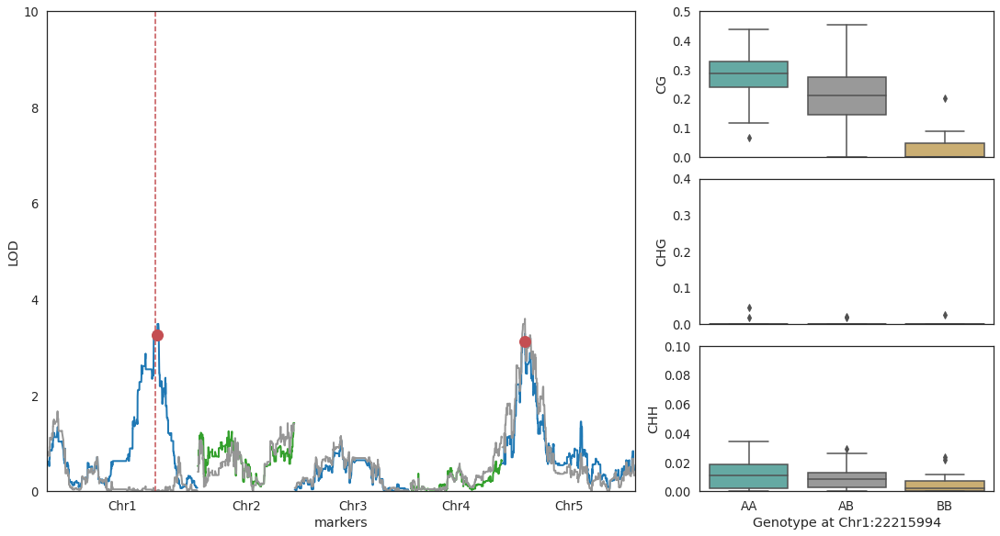

In [9]:
ef_gene = "Chr1,21846902,21849405" #"Chr1,25010710,25012987" #"Chr5,5007826,5008964"

display(req_peaks.loc[req_peaks['gene_str'] == ef_gene])
display(gene_blasts['p6046'].loc[gene_blasts['p6046']['query_id'] == tair10.genes.set_index("gene_str").loc[ef_gene, 3]].sort_values("full_copy", ascending = False))
display(gene_blasts['p6191'].loc[gene_blasts['p6191']['query_id'] == tair10.genes.set_index("gene_str").loc[ef_gene, 3]].sort_values("full_copy", ascending = False))
display(gene_blasts['tair'].loc[gene_blasts['tair']['query_id'] == tair10.genes.set_index("gene_str").loc[ef_gene, 3]].sort_values("full_copy", ascending = False))

ef_lods = geno_pheno.read_lods(qtls_genes['d1'], "g", ef_gene, return_peak_ix=True)
ef_meths = geno_pheno.read_geno_phenos( ef_gene, qtl_marker_ix=ef_lods[1][0] ).dropna()


fig = plt.figure(constrained_layout=True)
grid = gridspec.GridSpec(ncols=3, nrows=3, figure=fig)
# fig.suptitle('Horizontally stacked subplots')

axs1 = fig.add_subplot(grid[:, 0:2])
p = pygplot.generate_manhattanplot( qtls_genes['d1'].markers['genome_ix'].values, ef_lods[0], tair10, axs = axs1, line=True, linewidth=2.0, gap = 0)
p = pygplot.generate_manhattanplot( qtls_genes['d1'].markers['genome_ix'].values, geno_pheno.read_lods(qtls_genes['d1'], "cis_given", ef_gene, return_peak_ix=False), tair10, line=True, axs = axs1, linewidth=2.0, gap = 0, plt_color = "#969696")
axs1.plot(qtls_genes['d1'].markers['genome_ix'].values[ef_lods[1]], ef_lods[0][ef_lods[1]], "ro", markersize=12 )
axs1.plot( (qtls_genes['d1'].gene_genome_ind.loc[ef_gene], qtls_genes['d1'].gene_genome_ind.loc[ef_gene]), (0, 40), 'r--' )
axs1.set_ylim((0, 10))
axs1.set_ylabel("LOD")


axs2 = fig.add_subplot(grid[2, 2])
axs2 = sns.boxplot(y = "CHH", x = "geno_marker", data= ef_meths, order = ['AA', 'AB', 'BB'], palette = color_f2s )
axs2.set_xlabel( "Genotype at " + geno_pheno.qtl_map.index.values[ef_lods[1][0]]  )
axs2.set_ylim((0, 0.1))


axs3 = fig.add_subplot(grid[1, 2], sharex=axs2)
axs3 = sns.boxplot(y = "CHG", x = "geno_marker", data= ef_meths, order = ['AA', 'AB', 'BB'], palette = color_f2s )
axs3.set_ylim((0, 0.4))
plt.setp(axs3.get_xaxis(), visible=False)

axs4 = fig.add_subplot(grid[0, 2], sharex=axs3)
axs4 = sns.boxplot(y = "CG", x = "geno_marker", data= ef_meths, order = ['AA', 'AB', 'BB'], palette = color_f2s )
plt.setp(axs4.get_xaxis(), visible=False)
axs4.set_ylim((0, 0.5))
# axs[1].set_xlabel( "Genotype at QTL" )
# plt.tight_layout()
# plt.savefig( "gene.another.cis.pdf" )

plt.show()

,gene_str,qtl_num,marker_ix,genome_marker_ind,lod,genome_gene_ind,araportid,marker_chr,counts_tair,counts_p6046,counts_p6191,mean_CG,mean_CHG,mean_CHH


,query_id,query_acc,subject_acc,evalue,query_start,query_end,sub_id,sub_start,sub_end,sub_len,full_copy
4411,AT1G22015,AT1G22015,6046_Chr1,0.0,1,2525,6046_Chr1,7790413,7792935,2525,1.0
4412,AT1G22015,AT1G22015,6046_Chr4,0.0,1,2525,6046_Chr4,7635717,7638260,2525,1.0


,query_id,query_acc,subject_acc,evalue,query_start,query_end,sub_id,sub_start,sub_end,sub_len,full_copy
4556,AT1G22015,AT1G22015,6191_Chr1,0.0,1,2525,6191_Chr1,7744588,7747118,2525,1.0


,query_id,query_acc,subject_acc,evalue,query_start,query_end,sub_id,sub_start,sub_end,sub_len,full_copy
4275,AT1G22015,AT1G22015,Chr1,0.0,1,2525,Chr1,7750995,7753519,2525,1.0


Make sure provided array is sorted based on chromosome position


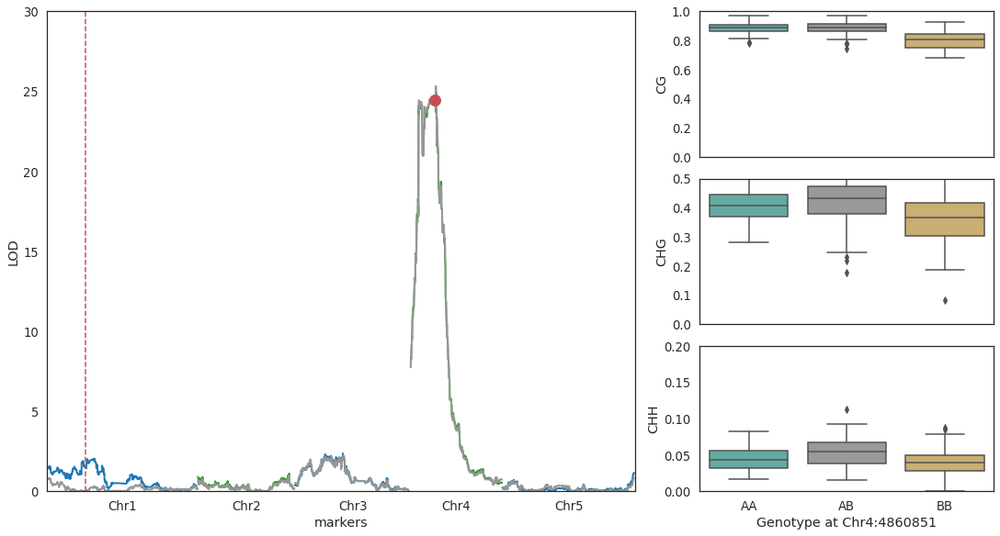

In [10]:
ef_gene = "Chr1,7750994,7753519"

display(req_peaks.loc[req_peaks['gene_str'] == ef_gene])
display(gene_blasts['p6046'].loc[gene_blasts['p6046']['query_id'] == tair10.genes.set_index("gene_str").loc[ef_gene, 3]].sort_values("full_copy", ascending = False))
display(gene_blasts['p6191'].loc[gene_blasts['p6191']['query_id'] == tair10.genes.set_index("gene_str").loc[ef_gene, 3]].sort_values("full_copy", ascending = False))
display(gene_blasts['tair'].loc[gene_blasts['tair']['query_id'] == tair10.genes.set_index("gene_str").loc[ef_gene, 3]].sort_values("full_copy", ascending = False))

ef_lods = geno_pheno.read_lods(qtls_genes['d1'], "g", ef_gene, return_peak_ix=True)
ef_meths = geno_pheno.read_geno_phenos( ef_gene, qtl_marker_ix=ef_lods[1][0] ).dropna()

fig = plt.figure(constrained_layout=True)
grid = gridspec.GridSpec(ncols=3, nrows=3, figure=fig)
# fig.suptitle('Horizontally stacked subplots')

axs1 = fig.add_subplot(grid[:, 0:2])
p = pygplot.generate_manhattanplot( qtls_genes['d1'].markers['genome_ix'].values, ef_lods[0], tair10, axs = axs1, line=True, linewidth=2.0, gap = 0)
p = pygplot.generate_manhattanplot( qtls_genes['d1'].markers['genome_ix'].values, geno_pheno.read_lods(qtls_genes['d1'], "cis_given", ef_gene, return_peak_ix=False), tair10, line=True, axs = axs1, linewidth=2.0, gap = 0, plt_color = "#969696")
axs1.plot(qtls_genes['d1'].markers['genome_ix'].values[ef_lods[1]], ef_lods[0][ef_lods[1]], "ro", markersize=12 )
axs1.plot( (qtls_genes['d1'].gene_genome_ind.loc[ef_gene], qtls_genes['d1'].gene_genome_ind.loc[ef_gene]), (0, 40), 'r--' )
axs1.set_ylim((0, 30))
axs1.set_ylabel("LOD")


axs2 = fig.add_subplot(grid[2, 2])
axs2 = sns.boxplot(y = "CHH", x = "geno_marker", data= ef_meths, order = ['AA', 'AB', 'BB'], palette = color_f2s )
axs2.set_xlabel( "Genotype at " + geno_pheno.qtl_map.index.values[ef_lods[1][0]] )
axs2.set_ylim((0, 0.2))


axs3 = fig.add_subplot(grid[1, 2], sharex=axs2)
axs3 = sns.boxplot(y = "CHG", x = "geno_marker", data= ef_meths, order = ['AA', 'AB', 'BB'], palette = color_f2s )
axs3.set_ylim((0, 0.5))
plt.setp(axs3.get_xaxis(), visible=False)

axs4 = fig.add_subplot(grid[0, 2], sharex=axs3)
axs4 = sns.boxplot(y = "CG", x = "geno_marker", data= ef_meths, order = ['AA', 'AB', 'BB'], palette = color_f2s )
plt.setp(axs4.get_xaxis(), visible=False)
axs4.set_ylim((0, 1))
# axs[1].set_xlabel( "Genotype at QTL" )
# plt.tight_layout()
# plt.savefig( "gene.another.cis.pdf" )

plt.show()

,gene_str,qtl_num,marker_ix,genome_marker_ind,lod,genome_gene_ind,araportid,marker_chr,counts_tair,counts_p6046,counts_p6191,mean_CG,mean_CHG,mean_CHH,another_cis


,query_id,query_acc,subject_acc,evalue,query_start,query_end,sub_id,sub_start,sub_end,sub_len,full_copy
56137,AT2G04420,AT2G04420,6046_Chr5,0.0,1,755,6046_Chr5,17751539,17752293,755,0.992116


,query_id,query_acc,subject_acc,evalue,query_start,query_end,sub_id,sub_start,sub_end,sub_len,full_copy
65560,AT2G04420,AT2G04420,6191_Chr2,0.0,1,761,6191_Chr2,3504477,3505237,761,1.000000
65561,AT2G04420,AT2G04420,6191_Chr2,0.0,1,755,6191_Chr2,8592029,8591275,755,0.992116


,query_id,query_acc,subject_acc,evalue,query_start,query_end,sub_id,sub_start,sub_end,sub_len,full_copy
30253,AT2G04420,AT2G04420,Chr2,0.0,1,761,Chr2,1535490,1536250,761,1.0


Make sure provided array is sorted based on chromosome position


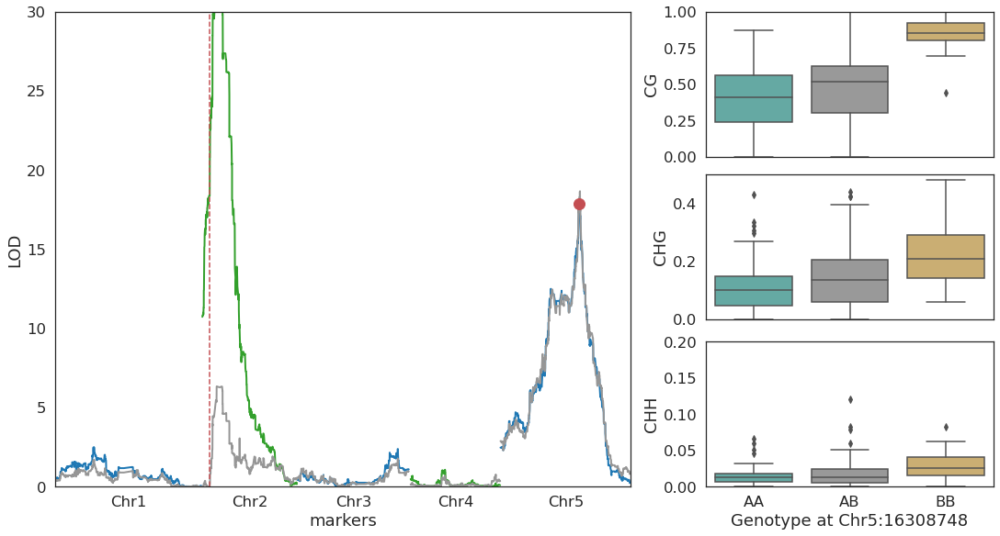

In [34]:
ef_gene = "Chr2,1535489,1536250" 

display(req_peaks.loc[req_peaks['gene_str'] == ef_gene])
display(gene_blasts['p6046'].loc[gene_blasts['p6046']['query_id'] == tair10.genes.set_index("gene_str").loc[ef_gene, 3]].sort_values("full_copy", ascending = False))
display(gene_blasts['p6191'].loc[gene_blasts['p6191']['query_id'] == tair10.genes.set_index("gene_str").loc[ef_gene, 3]].sort_values("full_copy", ascending = False))
display(gene_blasts['tair'].loc[gene_blasts['tair']['query_id'] == tair10.genes.set_index("gene_str").loc[ef_gene, 3]].sort_values("full_copy", ascending = False))

ef_lods = geno_pheno.read_lods(qtls_genes['d1'], "g", ef_gene, return_peak_ix=True)
ef_meths = geno_pheno.read_geno_phenos( ef_gene, qtl_marker_ix=ef_lods[1][1] ).dropna()

fig = plt.figure(constrained_layout=True)
grid = gridspec.GridSpec(ncols=3, nrows=3, figure=fig)

axs1 = fig.add_subplot(grid[:, 0:2])
p = pygplot.generate_manhattanplot( qtls_genes['d1'].markers['genome_ix'].values, ef_lods[0], tair10, axs = axs1, line=True, linewidth=2.0, gap = 0)
p = pygplot.generate_manhattanplot( qtls_genes['d1'].markers['genome_ix'].values, geno_pheno.read_lods(qtls_genes['d1'], "cis_given", ef_gene, return_peak_ix=False), tair10, line=True, axs = axs1, linewidth=2.0, gap = 0, plt_color = "#969696")
axs1.plot(qtls_genes['d1'].markers['genome_ix'].values[ef_lods[1]], ef_lods[0][ef_lods[1]], "ro", markersize=12 )
axs1.plot( (qtls_genes['d1'].gene_genome_ind.loc[ef_gene], qtls_genes['d1'].gene_genome_ind.loc[ef_gene]), (0, 40), 'r--' )
axs1.set_ylim((0, 30))
axs1.set_ylabel("LOD")


axs2 = fig.add_subplot(grid[2, 2])
axs2 = sns.boxplot(y = "CHH", x = "geno_marker", data= ef_meths, order = ['AA', 'AB', 'BB'], palette = color_f2s )
axs2.set_xlabel( "Genotype at " + geno_pheno.qtl_map.index.values[ef_lods[1][1]] )
axs2.set_ylim((0, 0.2))


axs3 = fig.add_subplot(grid[1, 2], sharex=axs2)
axs3 = sns.boxplot(y = "CHG", x = "geno_marker", data= ef_meths, order = ['AA', 'AB', 'BB'], palette = color_f2s )
axs3.set_ylim((0, 0.5))
plt.setp(axs3.get_xaxis(), visible=False)

axs4 = fig.add_subplot(grid[0, 2], sharex=axs3)
axs4 = sns.boxplot(y = "CG", x = "geno_marker", data= ef_meths, order = ['AA', 'AB', 'BB'], palette = color_f2s )
plt.setp(axs4.get_xaxis(), visible=False)
axs4.set_ylim((0, 1))

# plt.tight_layout()
# plt.savefig( "gene.another.cis.pdf" )

plt.show()

In [10]:
# permutation test
# different types of pattens in the gene duplicates.

0.05 * 20000

1000.0

In [11]:

req_peaks['nonCG'] = False
req_peaks.loc[(req_peaks['mean_CHG'] >= 0.01) & (req_peaks['mean_CHH'] >= 0.001), 'nonCG'] = True

# ef_query = "AT2G16760"

# for ef_genome in ['tair', 'p6046', 'p6191']:
#     print("genes in %s" % ef_genome)
#     display( gene_blasts[ef_genome].loc[gene_blasts[ef_genome]['query_acc'] == ef_query,: ] )
#     print("TEs in %s" % ef_genome)
#     display( te_blasts[ef_genome].loc[te_blasts[ef_genome]['query_acc'] == ef_query,: ] )

req_peaks['another_cis'] = False

for ef_peak in req_peaks.iterrows():
    ## peak is on a chromosome where you have gene duplicate.
    ef_gene_blasts = pd.concat( [ gene_blasts['p6046'].loc[gene_blasts['p6046']['query_id'] == ef_peak[1]['araportid']], gene_blasts['p6191'].loc[gene_blasts['p6191']['query_id'] == ef_peak[1]['araportid']] ], ignore_index = True )
    ### Check if the peak is on the same chromosome as the duplicate 
    if ef_gene_blasts['sub_id'].str.contains( ef_peak[1]['marker_chr'] ).sum() > 0:
        req_peaks.loc[ef_peak[0], 'another_cis'] = True

In [15]:
req_peaks['another_cis'].sum()

104


* Number of genes that have trans peaks: 989



* Genes that are duplicated and hence trans association: 242

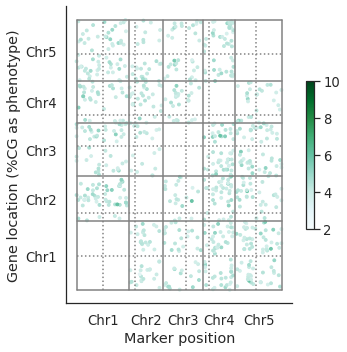

In [21]:
ef_peaks = req_peaks.loc[~req_peaks['another_cis']]

p = pygplot.plt_gwas_peaks_matrix(x_ind=ef_peaks['genome_marker_ind'].values, y_ind=ef_peaks['genome_gene_ind'].values, tair10=tair10, peak_heights = ef_peaks['lod'].values, legend_scale = (2, 10), hist_color="#252525")

# p.fig.suptitle("6191x6046")
p.ax_joint.set_xlabel("Marker position")
p.ax_joint.set_ylabel("Gene location (%CG as phenotype)")


# plt.title("y | G_cis ~ G_i ")
plt.tight_layout()
# plt.savefig("cache_data/qtl.genes.cg.g_cisgiven.png", bbox_inches='tight', dpi=400)
plt.show()

In [21]:
trans_matrix = qtls_genes['d1'].get_matrix("pval_nocis", qtls_genes['d1'].gene_str)
trans_matrix = -2 * np.log10(trans_matrix)

req_gene_str = req_peaks.loc[~req_peaks['another_cis'], 'gene_str'].unique()
req_gene_lods = trans_matrix.reindex(req_gene_str).dropna(how = "all")

req_gene_lods[~np.isfinite(req_gene_lods)] = 0

print( "number of genes: %s" % req_gene_lods.shape[0] )

permuted_lod_sum = qtl_maps.genome_rotations_2d( req_gene_lods.values, 500)
permuted_lod_sum = pd.DataFrame(permuted_lod_sum).describe()

np_ci = np.vectorize(sp.stats.t.interval, excluded="alpha")  

permuted_lod_sum.loc['ci_low'], permuted_lod_sum.loc['ci_high'] = np_ci(1 - (0.1 / 3300), 999, loc = permuted_lod_sum.loc['mean'].values, scale = permuted_lod_sum.loc['std'].values)

/users/rahul.pisupati/.conda/envs/pypower_quant/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in log10
  


number of genes: 455


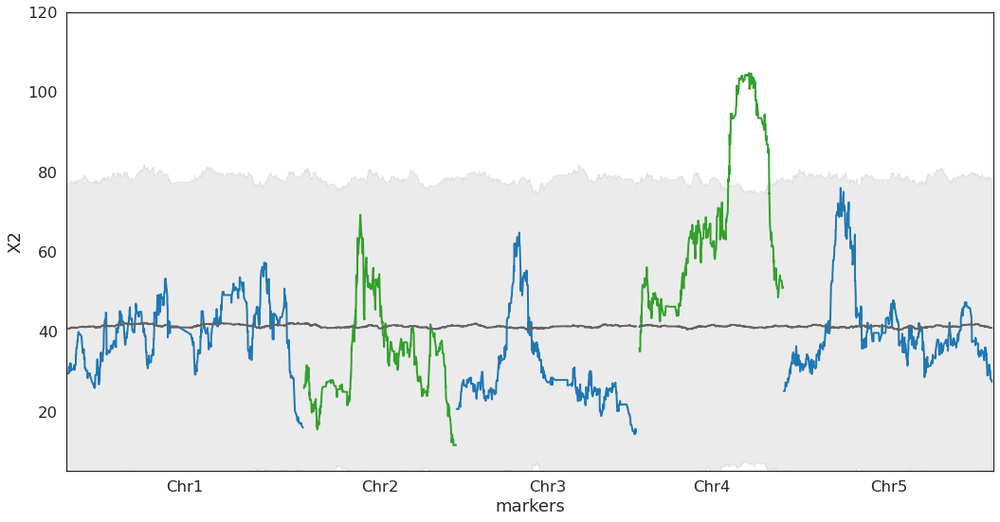

In [22]:
sns.set(style="white", color_codes=True, font_scale = 1.5)

plt_lim = (int(permuted_lod_sum.loc['std'].mean()) * 20)

p1 = pygplot.generate_manhattanplot( trans_matrix.columns.values, req_gene_lods.sum(axis = 0).values, tair10, line=True, linewidth=2.0, gap = 0)

# permuted_lod_sum.loc["ci_low",:].values
p1.axes.fill_between(  trans_matrix.columns.values, permuted_lod_sum.loc['ci_low'].values, permuted_lod_sum.loc["ci_high",:].values, interpolate=True, color = "#bdbdbd", alpha = 0.3 )
# p3 = pygplot.generate_manhattanplot( trans_matrix.columns.values, permuted_lod_sum.loc["ci_low",:].values, tair10, line=True, linewidth=2.0, gap = 2000000, plt_color = "#bdbdbd")
p2 = pygplot.generate_manhattanplot( trans_matrix.columns.values, permuted_lod_sum.loc["mean",:].values, tair10, line=True, linewidth=2.0, gap = 0, plt_color = "#636363")
# p3 = pygplot.generate_manhattanplot( trans_matrix.columns.values, permuted_lod_sum.loc["ci_high",:].values, tair10, line=True, linewidth=2.0, gap = 2000000, plt_color = "#bdbdbd")

# plt.plot(trans_matrix.columns.values[trans_modifier_peaks], req_gene_lods.sum(axis = 0).values[trans_modifier_peaks], "ro", markersize=12 )


# plt.plot( (19645236, 19645236), (60, 300) )
# plt.plot( (0, 1000000000), (7584, 7584), 'r--' )
plt.ylim((5, 120))
# plt.ylim((int(permuted_lod_sum.loc["ci_low",:].min()) - 20, int(permuted_lod_sum.loc["max",:].max()) + plt_lim))
plt.ylabel( "X2" )
plt.tight_layout()

plt.savefig( "trans_modifier_750genes.pdf" )

plt.show()

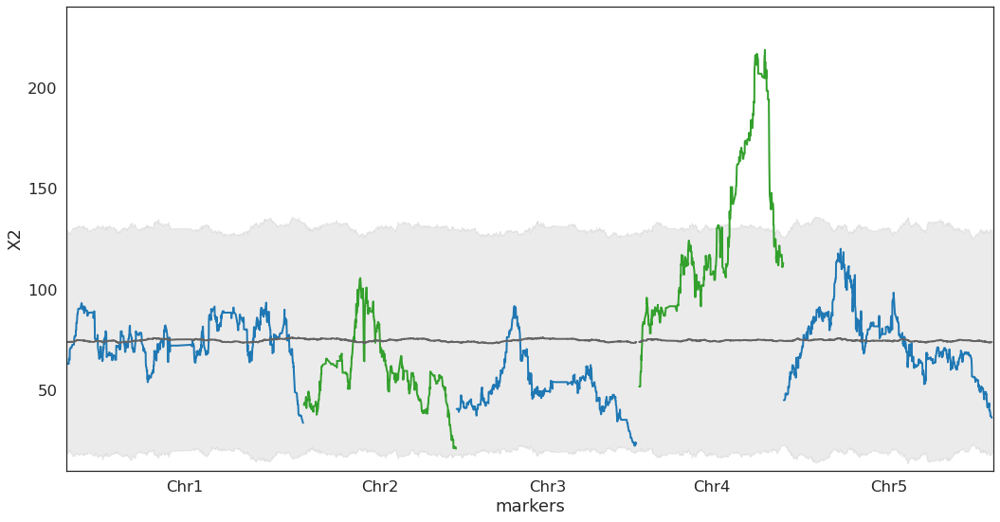

In [21]:
sns.set(style="white", color_codes=True, font_scale = 1.5)

plt_lim = (int(permuted_lod_sum.loc['std'].mean()) * 20)

p1 = pygplot.generate_manhattanplot( trans_matrix.columns.values, req_gene_lods.sum(axis = 0).values, tair10, line=True, linewidth=2.0, gap = 0)

# permuted_lod_sum.loc["ci_low",:].values
p1.axes.fill_between(  trans_matrix.columns.values, permuted_lod_sum.loc['ci_low'].values, permuted_lod_sum.loc["ci_high",:].values, interpolate=True, color = "#bdbdbd", alpha = 0.3 )
# p3 = pygplot.generate_manhattanplot( trans_matrix.columns.values, permuted_lod_sum.loc["ci_low",:].values, tair10, line=True, linewidth=2.0, gap = 2000000, plt_color = "#bdbdbd")
p2 = pygplot.generate_manhattanplot( trans_matrix.columns.values, permuted_lod_sum.loc["mean",:].values, tair10, line=True, linewidth=2.0, gap = 0, plt_color = "#636363")
# p3 = pygplot.generate_manhattanplot( trans_matrix.columns.values, permuted_lod_sum.loc["ci_high",:].values, tair10, line=True, linewidth=2.0, gap = 2000000, plt_color = "#bdbdbd")

# plt.plot(trans_matrix.columns.values[trans_modifier_peaks], req_gene_lods.sum(axis = 0).values[trans_modifier_peaks], "ro", markersize=12 )


# plt.plot( (19645236, 19645236), (60, 300) )
# plt.plot( (0, 1000000000), (7584, 7584), 'r--' )
plt.ylim((10, 240))
# plt.ylim((int(permuted_lod_sum.loc["ci_low",:].min()) - 20, int(permuted_lod_sum.loc["max",:].max()) + plt_lim))
plt.ylabel( "X2" )
plt.tight_layout()

plt.savefig( "trans_modifier_750genes.pdf" )

plt.show()

In [24]:
req_gene_lods.sum(axis = 0).values

array([29.27968833, 29.51111197, 29.51111197, ..., 28.08002478,
       28.08002478, 27.38589891])

In [25]:
# req_gene_str
qtl_cg_gbm = qtl_maps.determine_peaks_given_lods(req_gene_lods.sum(axis = 0).values, peak_prominence=1, qtl_min = 100, n_smooth = 200)
qtl_cg_gbm

array([2403])

In [26]:
geno_pheno.read_geno_phenos( str(tair10.genes_str[2]), qtl_marker_ix=qtl_cg_gbm[0] )#.dropna()

Make sure provided array is sorted based on chromosome position


,CG,CHG,CHH,geno_marker
T16_P1.A12_F2_D1,0.010256,0.000000,0.005208,AA
T16_P1.A1_F2_D1,0.000000,0.015152,0.004819,AB
T16_P1.A2_F2_D1,0.000000,0.000000,0.003817,AB
T16_P1.A5_F2_D1,0.007143,0.000000,0.001623,AB
T16_P1.A6_F2_D1,0.000000,0.000000,0.001357,BB
...,...,...,...,...
T4_P5.H11_F2_D1,0.000000,0.010309,0.000000,BB
T4_P5.H4_F2_D1,0.005155,0.000000,0.001582,AB
T4_P5.H5_F2_D1,0.000000,0.000000,0.001017,BB
T4_P5.H8_F2_D1,0.000000,0.000000,0.003953,BB


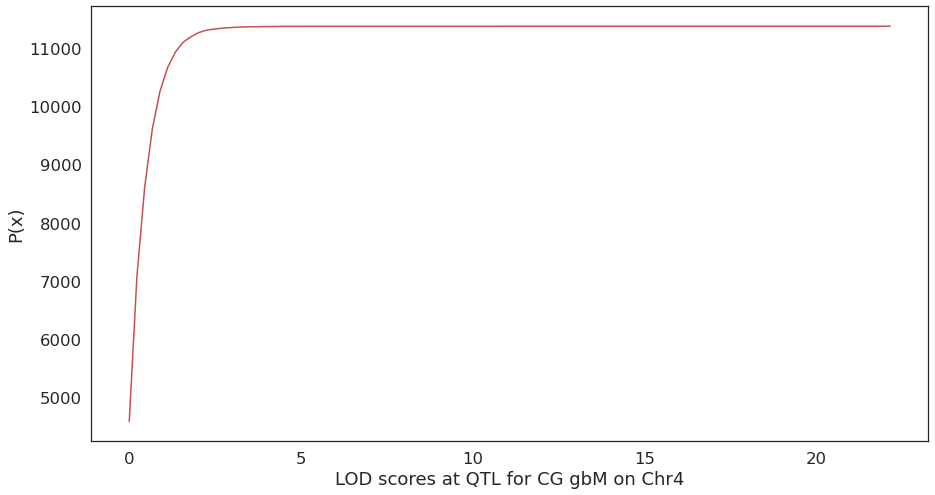

In [33]:
p  = plt.hist( qtls_genes['d1'].get_matrix( "cis_given", genes_with_onlygbm.index.values ).iloc[ :,qtl_cg_gbm[0] ].values, cumulative=True, histtype='step', bins = 100 )
# p  = plt.hist( trans_matrix.iloc[:,qtl_cg_gbm[0]].replace([np.inf, -np.inf], np.nan).dropna(), cumulative=True, histtype='step', bins = 100 )


plt.clf()
plt.plot(p[1][:-1], p[0] , 'r-' )

plt.xlabel( "LOD scores at QTL for CG gbM on Chr4" )
plt.ylabel("P(x)")

plt.show()

In [82]:
methylation_related_gene_list.loc[methylation_related_gene_list.index.str.startswith("AT4G")]

,GeneName,0,1,2,4,5,6,gene_str
GeneID,,,,,,,,
AT4G11130,"RDR2,SMD1;RNA-dependent RNA polymerase 2",Chr4,6780449.0,6784632.0,0.0,+,protein_coding,"Chr4,6780449,6784632"
AT4G13460,SUVH9,Chr4,7823894.0,7827004.0,0.0,-,protein_coding,"Chr4,7823894,7827004"
AT4G14140,"DMT02,DMT2,MET02,MET2;DNA methyltransferase 2",Chr4,8145998.0,8152131.0,0.0,+,protein_coding,"Chr4,8145998,8152131"
AT4G15180,SDG2,Chr4,8651406.0,8662587.0,0.0,+,protein_coding,"Chr4,8651406,8662587"
AT4G19020,CMT2;chromomethylase 2,Chr4,10414428.0,10421265.0,0.0,+,protein_coding,"Chr4,10414428,10421265"
AT4G20910,HEN1,Chr4,11185936.0,11191123.0,0.0,-,protein_coding,"Chr4,11185936,11191123"
AT4G34060,DML3,Chr4,16313366.0,16319426.0,0.0,+,protein_coding,"Chr4,16313366,16319426"


In [15]:
req_peaks.loc[ req_peaks['another_cis'] ]

,gene_str,qtl_num,marker_ix,genome_marker_ind,genome_gene_ind,lod,araportid,marker_chr,diff_chr,counts_tair,counts_p6046,counts_p6191,another_cis
0,"Chr1,10015856,10018047",1,2758,100105827,10016951,3.463445,AT1G28490,Chr5,True,2.0,2.0,5.0,False
1,"Chr1,10252241,10254792",1,513,19916562,10253516,3.912566,AT1G29310,Chr1,False,1.0,1.0,2.0,True
2,"Chr1,10447347,10449969",1,1026,37756105,10448658,3.952295,AT1G29850,Chr2,True,1.0,1.0,1.0,False
3,"Chr1,10598542,10599696",1,2120,77160984,10599119,4.110896,AT1G30140,Chr4,True,4.0,1.0,15.0,True
4,"Chr1,10709999,10711667",1,716,27335997,10710833,3.915068,AT1G30350,Chr1,False,1.0,1.0,3.0,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1039,"Chr5,9617440,9618481",1,2632,95816699,101788806,4.321645,AT5G27280,Chr5,False,1.0,1.0,1.0,True
1040,"Chr5,9620810,9625136",1,974,36312368,101793819,3.641768,AT5G27300,Chr2,True,45.0,44.0,60.0,True
1041,"Chr5,974360,979849",1,187,7313091,93147950,3.843018,AT5G03730,Chr1,True,1.0,1.0,1.0,False
1042,"Chr5,9780,13235",1,2206,80412193,92182353,4.868064,AT5G01030,Chr4,True,1.0,1.0,1.0,False
